In [13]:
import keras
import tensorflow as tf
from keras_preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [3]:
cmmd_dir = "/media/craig/6848080D4807D928/st_andrews/CMMD_dataset/"


test_datagen = ImageDataGenerator(
        rescale=1./255,
)

test_generator = test_datagen.flow_from_directory(
        cmmd_dir+"subset_two/PNG/TEST/",
        target_size=(256, 256),
        color_mode="grayscale",
        batch_size=1,
        shuffle=False,
        class_mode='binary',
        seed=14)

Found 752 images belonging to 2 classes.


# Xception
Epoch 46/500


75/75 [==============================] - 1339s 18s/step - loss: 0.5828 - binary_accuracy: 0.7053 - val_loss: 0.6203 - val_binary_accuracy: 0.7133

In [3]:
#load model
# model = keras.models.load_model("/media/craig/Henry/ML_models/xception_ft_1/save_at_46.h5")

# LeNet
Epoch 62/150

75/75 [==============================] - 99s 1s/step - 
loss: 0.5619 - binary_accuracy: 0.7211 - 
val_loss: 0.6070 - val_binary_accuracy: 0.7100

In [40]:
model = keras.models.load_model("/media/craig/Henry/ML_models/lenet/save_at_62.h5")

In [41]:
filenames = test_generator.filenames
nb_samples = len(filenames)

predict = model.predict(test_generator,steps = nb_samples)


In [42]:
predictions = (model.predict(test_generator) > 0.5).astype("int32")

In [43]:
# test_generator[1]

In [44]:


predictions = predictions.reshape(1,-1)[0]
predictions

array([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0,
       0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1,

In [45]:
y_true = test_generator.classes
print(y_true)

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

In [10]:
print(classification_report(y_true, predictions, target_names = ['Malignant (Class 0)','Benign (Class 1)']))

                     precision    recall  f1-score   support

Malignant (Class 0)       0.53      0.09      0.15       224
   Benign (Class 1)       0.71      0.97      0.82       528

           accuracy                           0.70       752
          macro avg       0.62      0.53      0.49       752
       weighted avg       0.66      0.70      0.62       752



In [46]:
correct = np.nonzero(predictions == y_true)[0]
incorrect = np.nonzero(predictions != y_true)[0]

In [12]:
# x_test = test_generator.next()

In [13]:
# len(x_test)

In [14]:
# for i in range(0,1):
#     image = x_test[0][0]
#     plt.imshow(image.reshape(150,150))
#     plt.show()

In [15]:
# plt.imshow(image)
# plt.show()

In [16]:
predictions[0]

1

In [17]:
y_true[0]

0

In [18]:
c=1
if y_true[c] == predictions[c]:
    print("match")
if y_true[c] != predictions[c]:
    print("no match")

no match


In [19]:
len(test_generator)

752

In [20]:
predictions

array([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0,
       0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1,

Truth: 0
Predict: 0


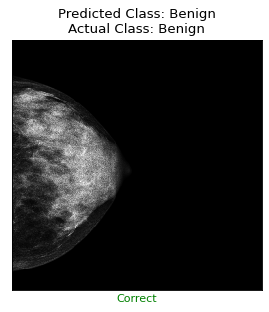

Truth: 0
Predict: 0


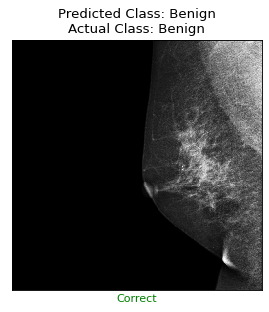

Truth: 0
Predict: 0


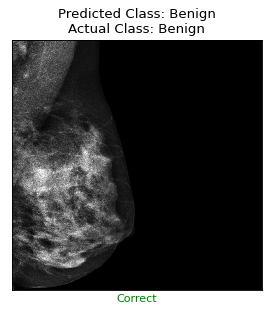

Truth: 0
Predict: 0


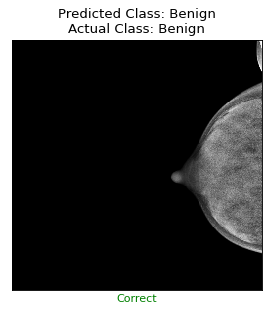

Truth: 0
Predict: 0


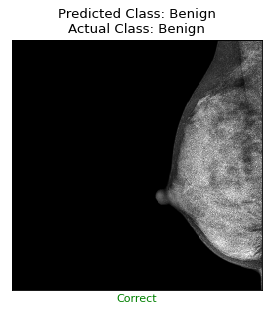

Truth: 0
Predict: 0


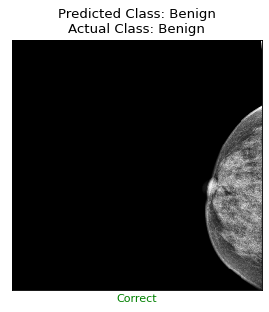

Truth: 0
Predict: 0


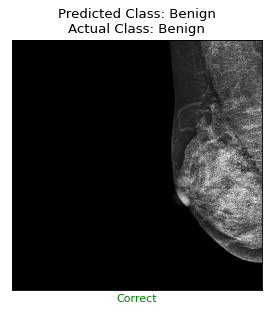

Truth: 0
Predict: 0


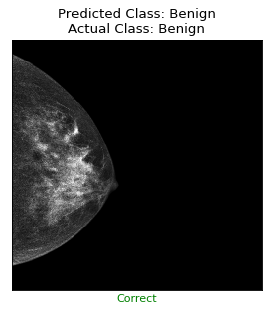

Truth: 0
Predict: 0


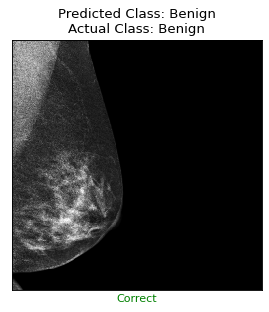

Truth: 0
Predict: 0


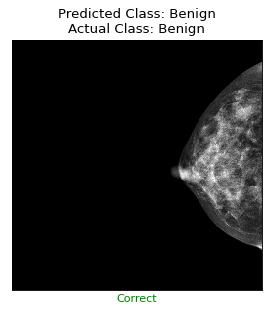

Truth: 0
Predict: 0


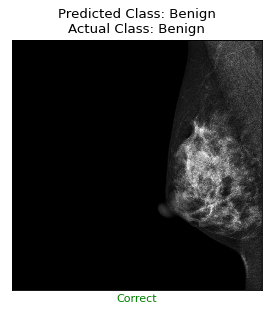

Truth: 0
Predict: 0


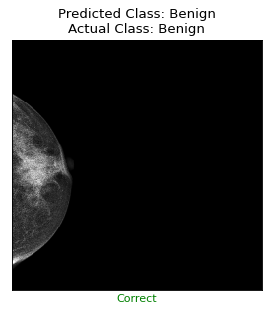

Truth: 0
Predict: 0


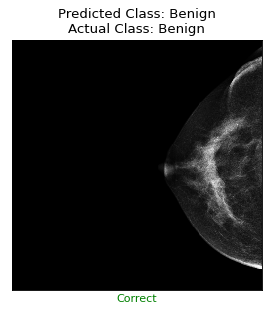

Truth: 0
Predict: 0


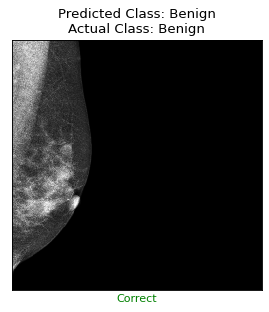

Truth: 0
Predict: 0


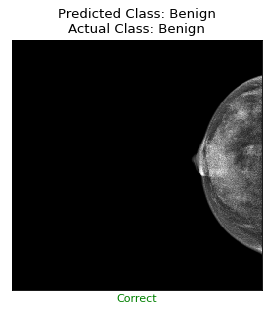

Truth: 0
Predict: 0


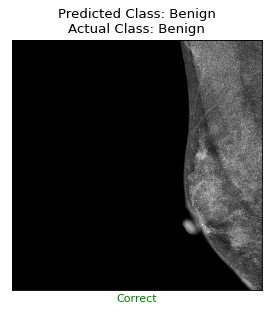

Truth: 0
Predict: 0


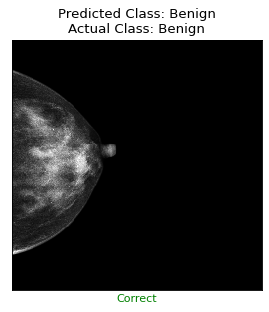

Truth: 0
Predict: 0


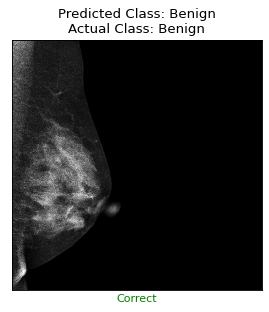

Truth: 0
Predict: 0


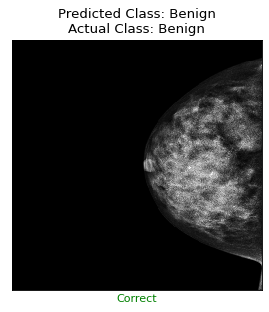

Truth: 0
Predict: 0


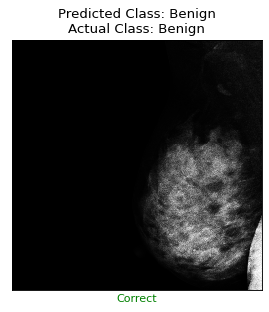

Truth: 1
Predict: 1


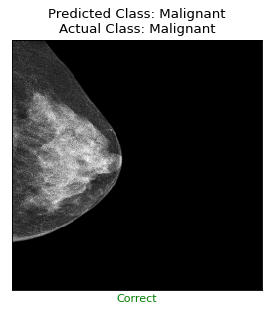

Truth: 1
Predict: 1


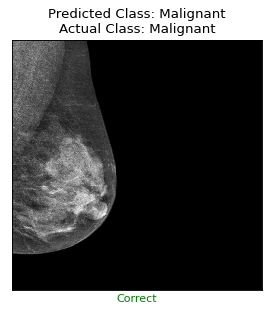

Truth: 1
Predict: 1


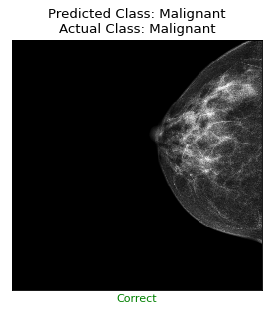

Truth: 1
Predict: 1


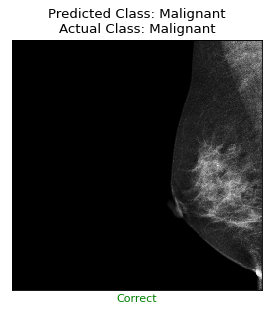

Truth: 1
Predict: 1


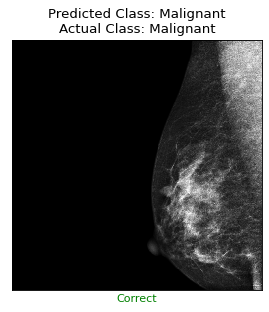

Truth: 1
Predict: 1


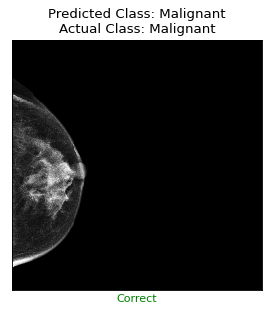

Truth: 1
Predict: 1


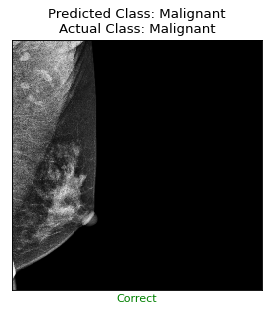

Truth: 1
Predict: 1


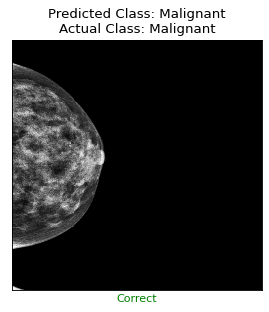

Truth: 1
Predict: 1


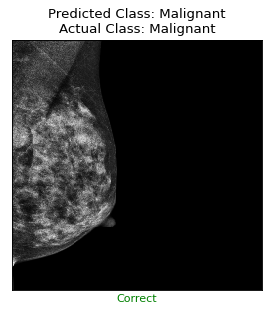

Truth: 1
Predict: 1


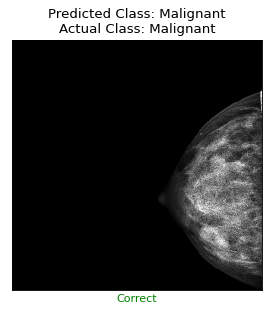

Truth: 1
Predict: 1


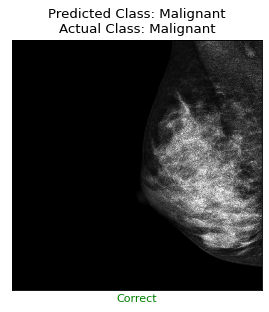

Truth: 1
Predict: 1


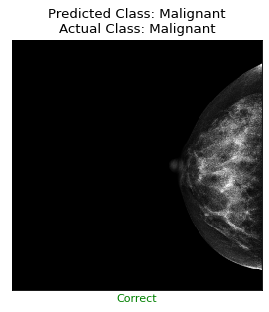

Truth: 1
Predict: 1


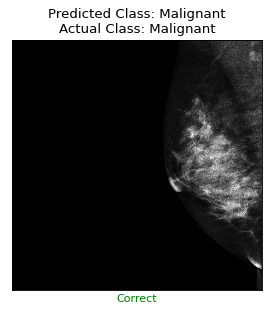

Truth: 1
Predict: 1


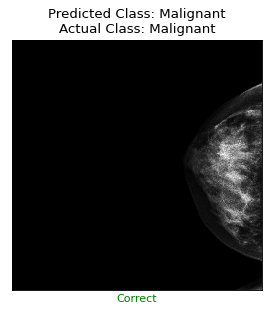

Truth: 1
Predict: 1


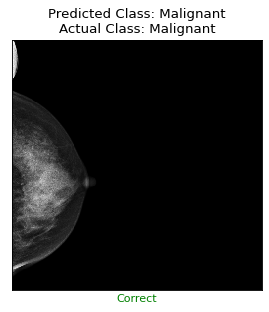

Truth: 1
Predict: 1


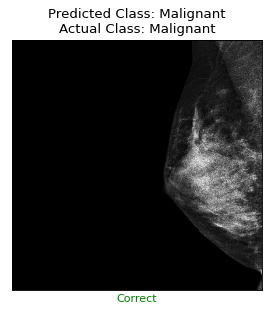

Truth: 1
Predict: 1


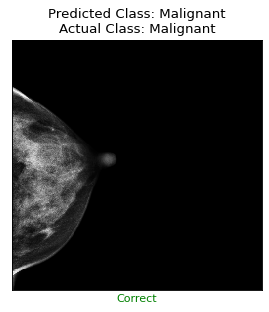

Truth: 1
Predict: 1


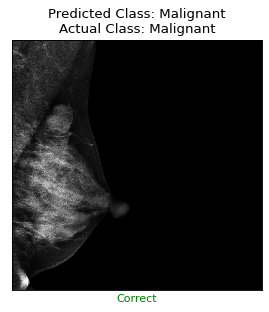

Truth: 1
Predict: 1


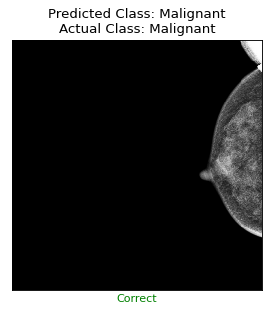

Truth: 1
Predict: 1


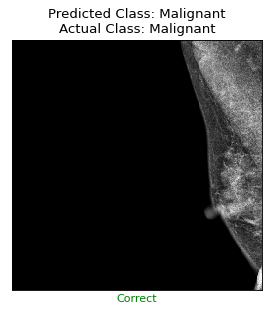

Truth: 1
Predict: 1


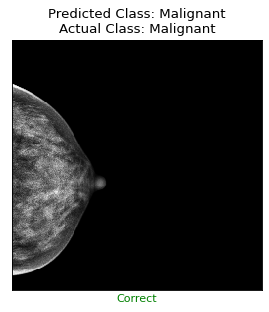

Truth: 1
Predict: 1


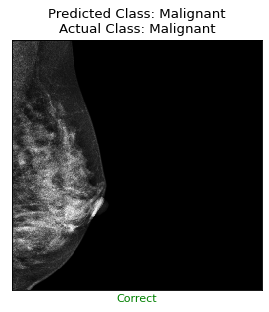

Truth: 1
Predict: 1


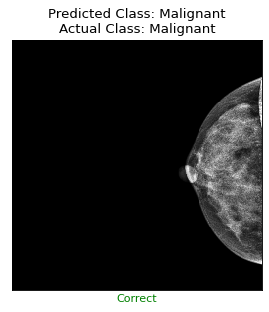

Truth: 1
Predict: 1


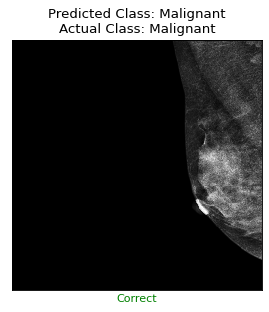

Truth: 1
Predict: 1


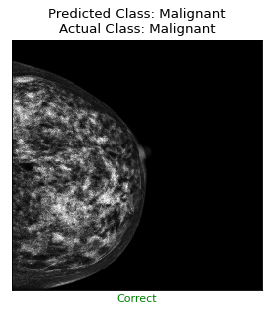

Truth: 1
Predict: 1


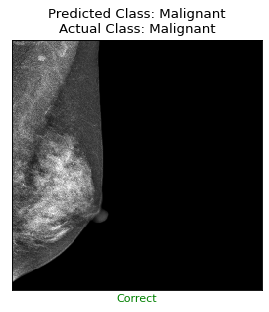

Truth: 1
Predict: 1


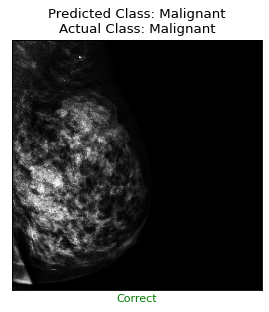

Truth: 1
Predict: 1


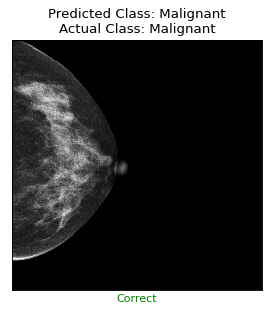

Truth: 1
Predict: 1


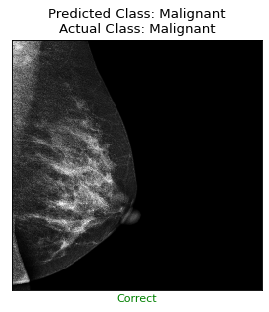

Truth: 1
Predict: 1


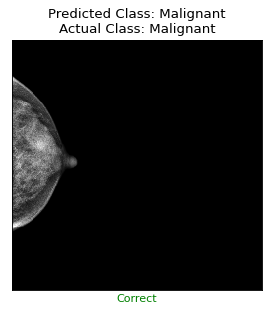

Truth: 1
Predict: 1


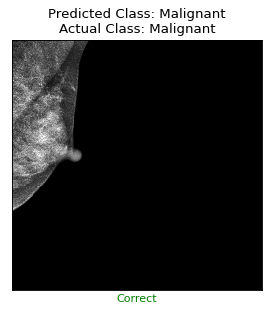

Truth: 1
Predict: 1


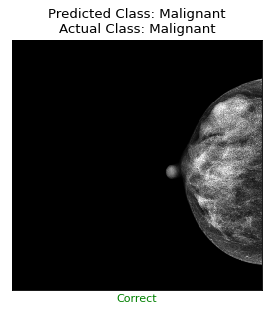

Truth: 1
Predict: 1


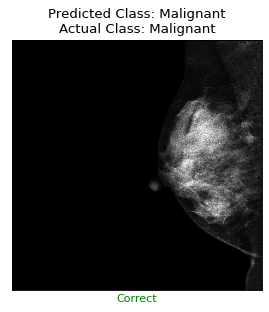

Truth: 1
Predict: 1


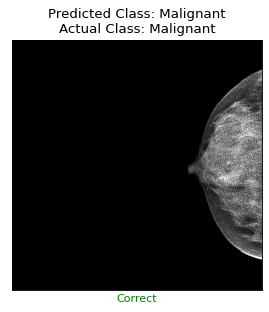

Truth: 1
Predict: 1


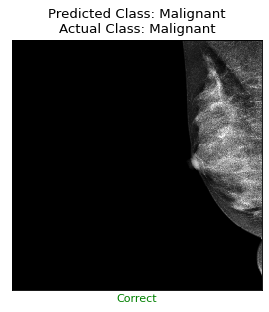

Truth: 1
Predict: 1


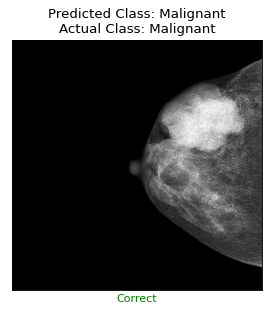

Truth: 1
Predict: 1


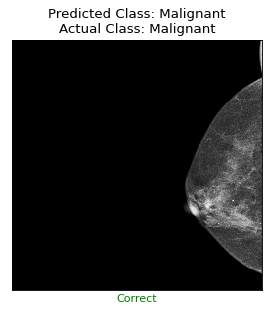

Truth: 1
Predict: 1


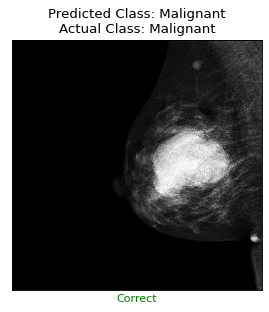

Truth: 1
Predict: 1


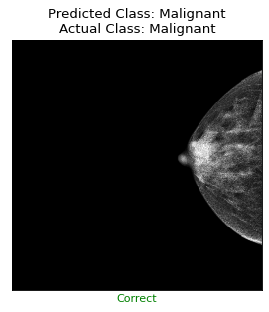

Truth: 1
Predict: 1


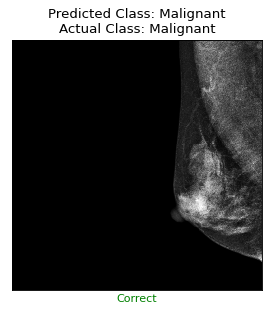

Truth: 1
Predict: 1


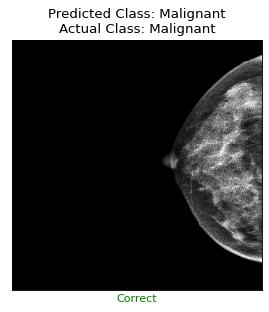

Truth: 1
Predict: 1


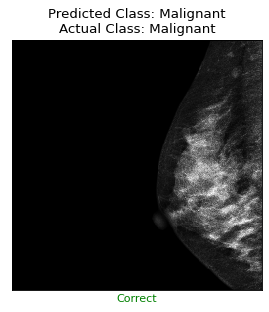

Truth: 1
Predict: 1


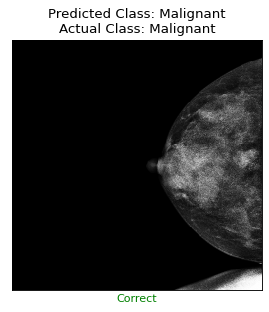

Truth: 1
Predict: 1


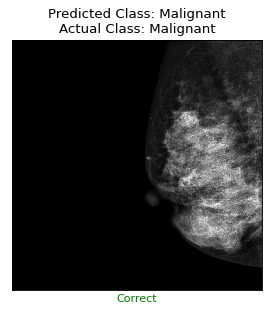

Truth: 1
Predict: 1


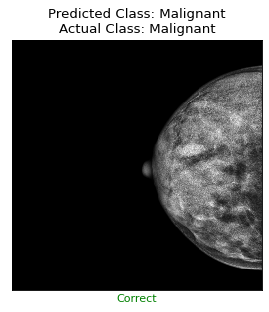

Truth: 1
Predict: 1


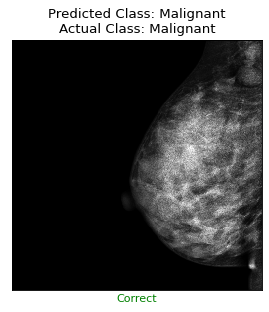

Truth: 1
Predict: 1


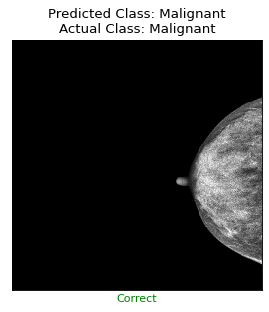

Truth: 1
Predict: 1


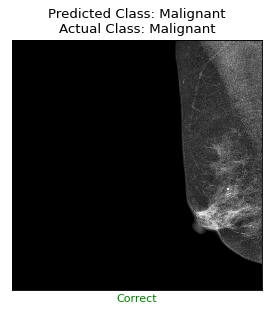

Truth: 1
Predict: 1


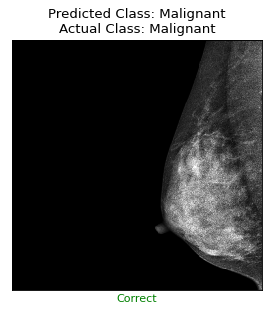

Truth: 1
Predict: 1


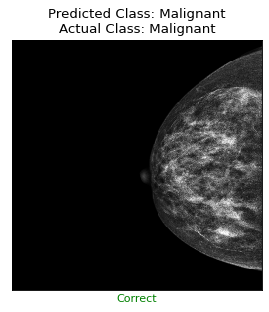

Truth: 1
Predict: 1


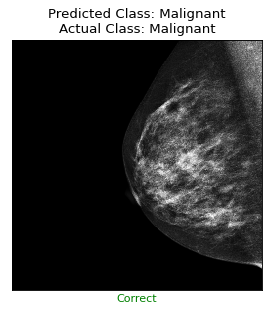

Truth: 1
Predict: 1


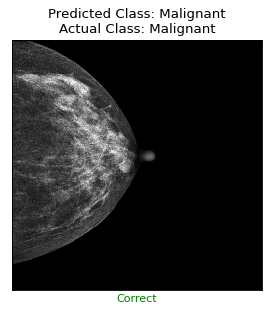

Truth: 1
Predict: 1


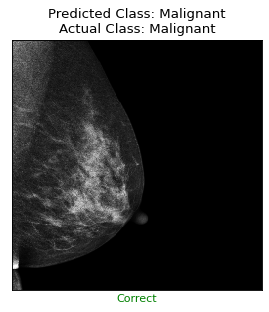

Truth: 1
Predict: 1


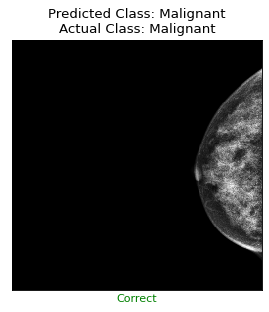

Truth: 1
Predict: 1


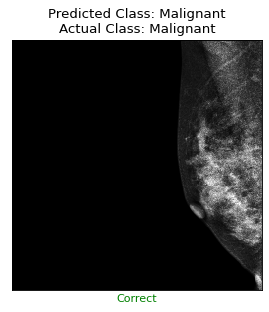

Truth: 1
Predict: 1


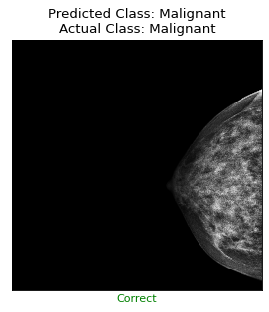

Truth: 1
Predict: 1


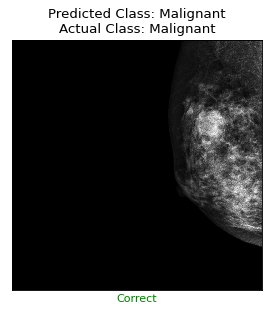

Truth: 1
Predict: 1


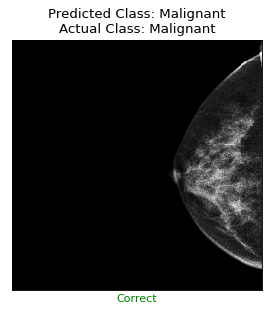

Truth: 1
Predict: 1


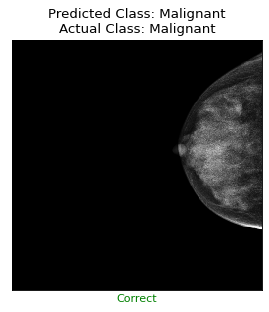

Truth: 1
Predict: 1


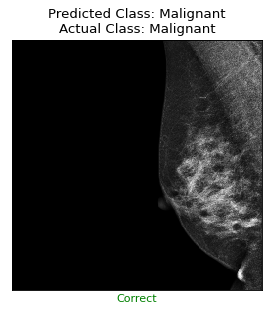

Truth: 1
Predict: 1


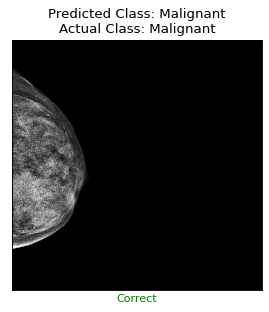

Truth: 1
Predict: 1


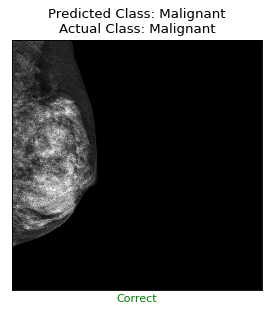

Truth: 1
Predict: 1


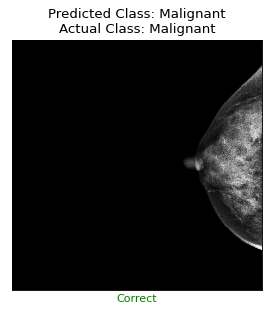

Truth: 1
Predict: 1


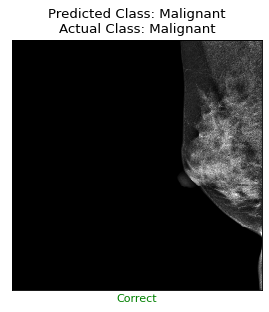

Truth: 1
Predict: 1


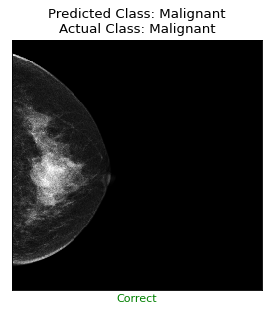

Truth: 1
Predict: 1


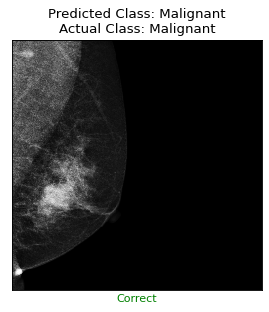

Truth: 1
Predict: 1


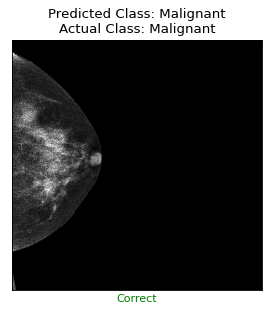

Truth: 1
Predict: 1


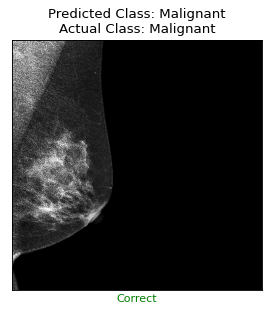

Truth: 1
Predict: 1


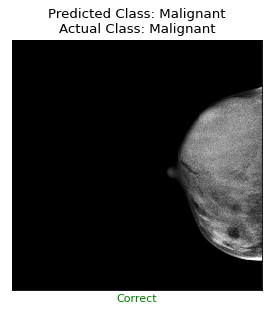

Truth: 1
Predict: 1


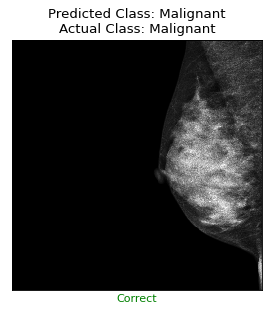

Truth: 1
Predict: 1


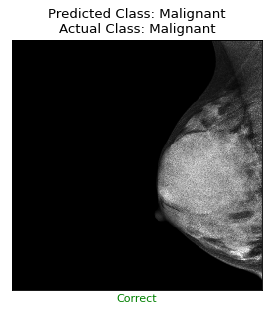

Truth: 1
Predict: 1


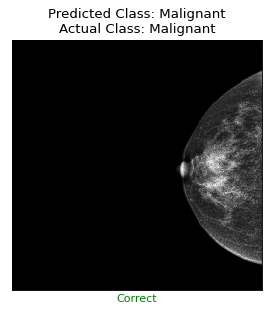

Truth: 1
Predict: 1


KeyboardInterrupt: 

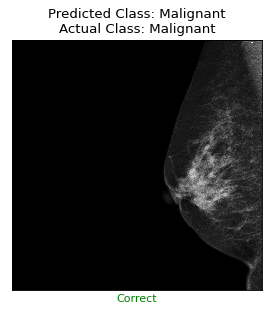

In [47]:
import matplotlib.pyplot as plt
#Loop for video for correct instances
i = 0
for c in correct:
    x_test = test_generator.next()
    image = x_test[0][0]

    #Preduction label
    if predictions[c] == 0:
        guess = "Benign"
    if predictions[c] == 1:
        guess = "Malignant"
        
    if y_true[c] == 0:
        truth = "Benign"
    if y_true[c] == 1:
        truth = "Malignant"
        
    if y_true[c] == predictions[c]:
        print("Truth: "+str(y_true[c]))
        print("Predict: "+str(predictions[c]))
    #If match show incorrect at bottom
    if y_true[c] != predictions[c]:
        print("Truth: "+str(y_true[c]))
        print("Predict: "+str(predictions[c]))
    
    plt.figure(figsize=(4, 4), dpi=80)
    plt.xticks([])
    plt.yticks([])
    #If match show correct at bottom
    if y_true[c] == predictions[c]:
        plt.xlabel('Correct', color="green")
    #If match show incorrect at bottom
    if y_true[c] != predictions[c]:
        plt.xlabel('Incorrect', color="red")
    plt.imshow(image, cmap="gray", interpolation='none')
    plt.title("Predicted Class: {}\nActual Class: {}".format(guess, truth))
    plt.tight_layout()
    plt.savefig('./output/predictions/'+str(i)+'.png',bbox_inches='tight')
    plt.show()
    i += 1

Truth: Benign
Predict: Malignant


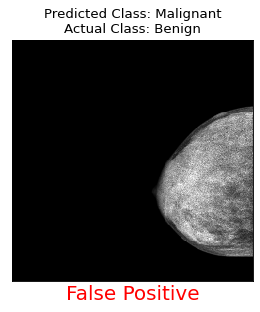

Truth: Benign
Predict: Malignant


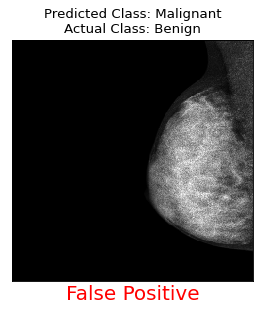

Truth: Benign
Predict: Malignant


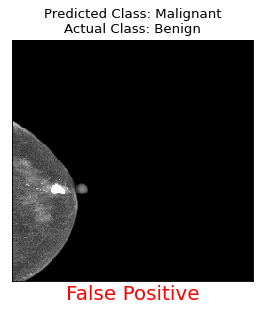

Truth: Benign
Predict: Benign


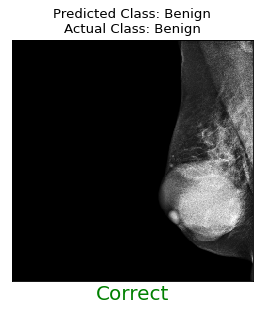

Truth: Benign
Predict: Benign


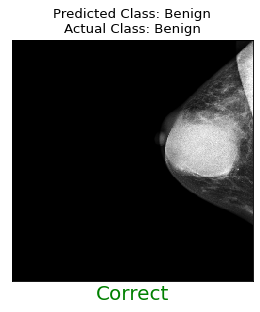

Truth: Benign
Predict: Malignant


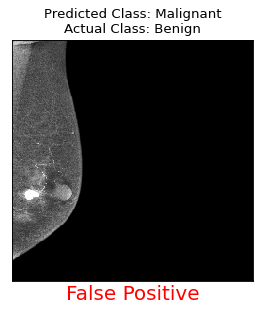

Truth: Benign
Predict: Malignant


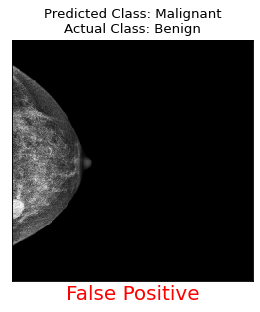

Truth: Benign
Predict: Malignant


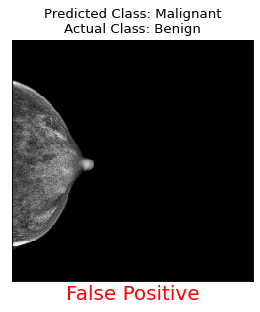

Truth: Benign
Predict: Malignant


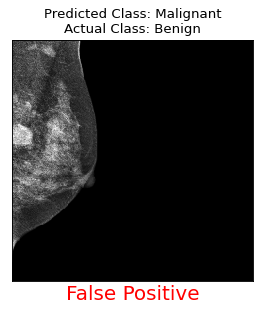

Truth: Benign
Predict: Malignant


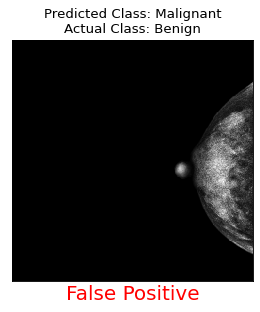

Truth: Benign
Predict: Malignant


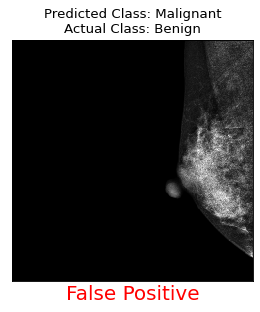

Truth: Benign
Predict: Malignant


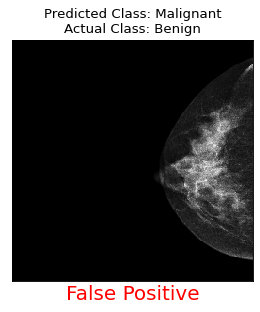

Truth: Benign
Predict: Malignant


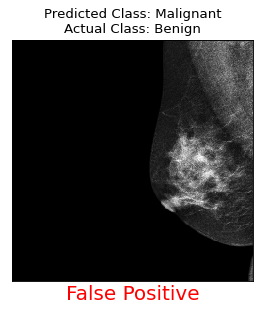

Truth: Benign
Predict: Malignant


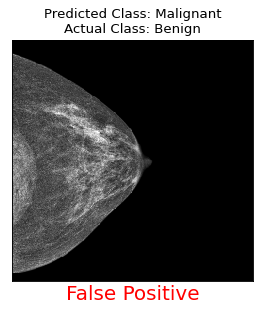

Truth: Benign
Predict: Malignant


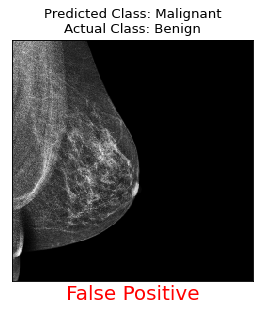

Truth: Benign
Predict: Malignant


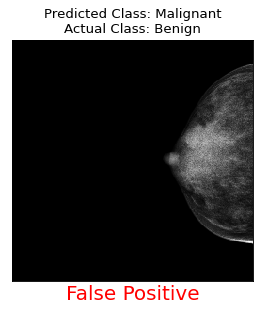

Truth: Benign
Predict: Malignant


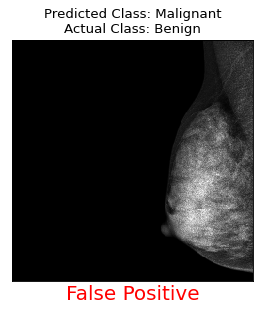

Truth: Benign
Predict: Malignant


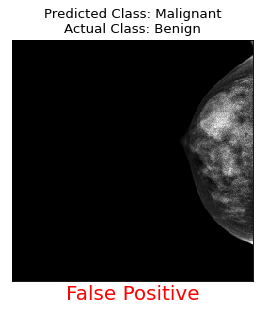

Truth: Benign
Predict: Malignant


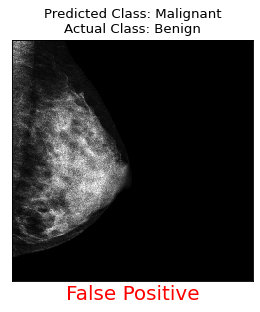

Truth: Benign
Predict: Malignant


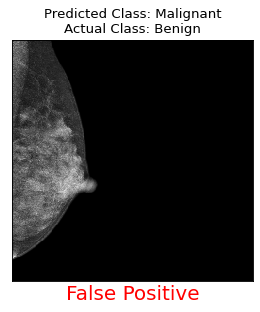

Truth: Benign
Predict: Malignant


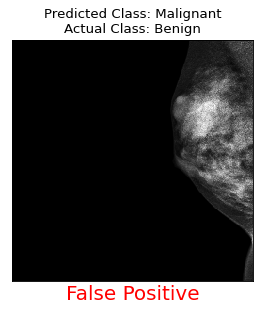

Truth: Benign
Predict: Malignant


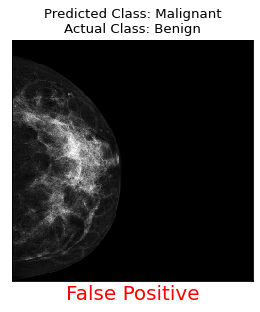

Truth: Benign
Predict: Malignant


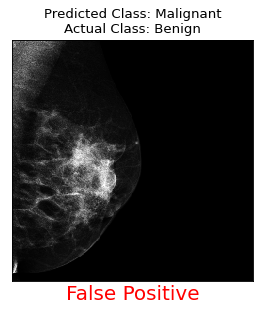

Truth: Benign
Predict: Malignant


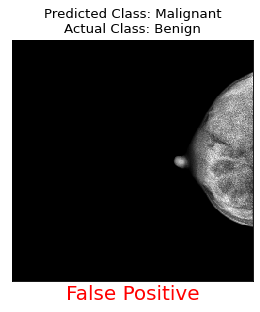

Truth: Benign
Predict: Malignant


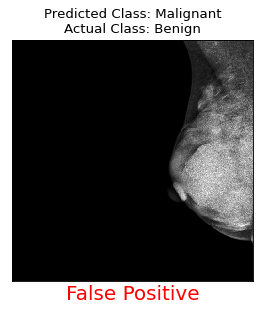

Truth: Benign
Predict: Malignant


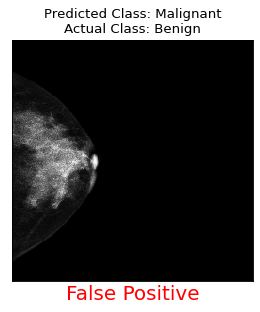

Truth: Benign
Predict: Malignant


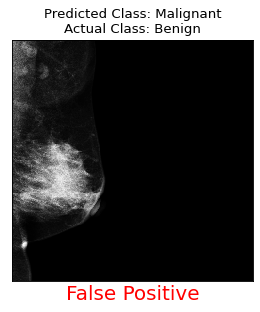

Truth: Benign
Predict: Malignant


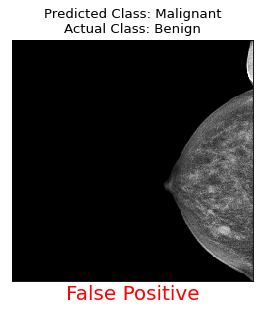

Truth: Benign
Predict: Benign


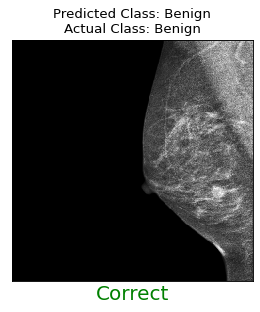

Truth: Benign
Predict: Malignant


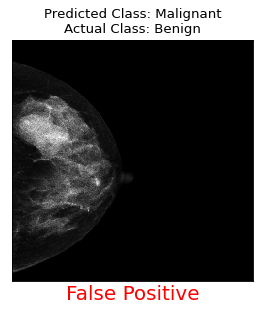

Truth: Benign
Predict: Benign


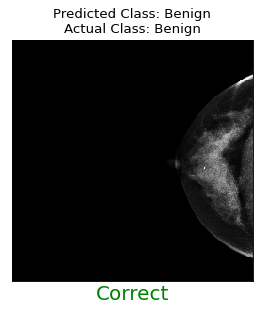

Truth: Benign
Predict: Malignant


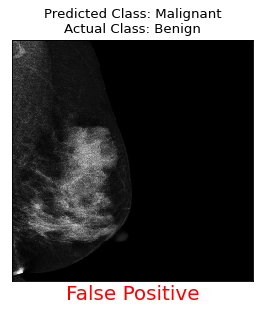

Truth: Benign
Predict: Malignant


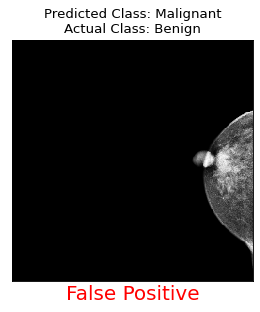

Truth: Benign
Predict: Malignant


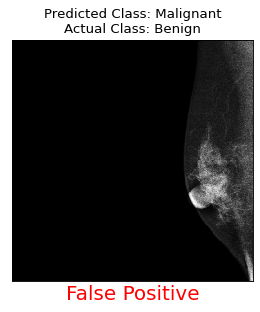

Truth: Benign
Predict: Malignant


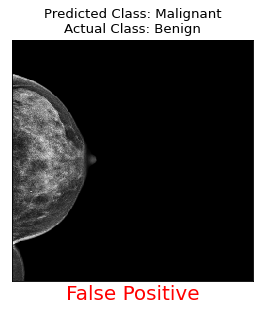

Truth: Benign
Predict: Benign


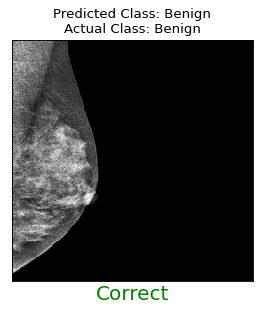

Truth: Benign
Predict: Malignant


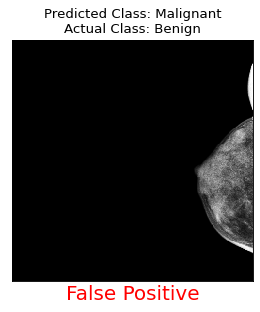

Truth: Benign
Predict: Malignant


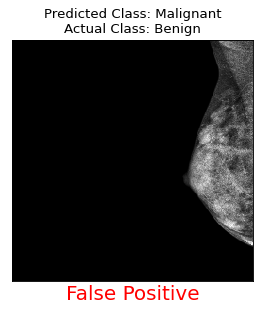

Truth: Benign
Predict: Malignant


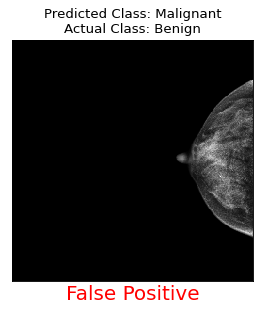

Truth: Benign
Predict: Malignant


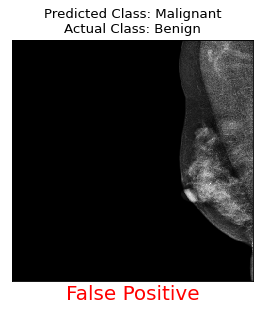

Truth: Benign
Predict: Malignant


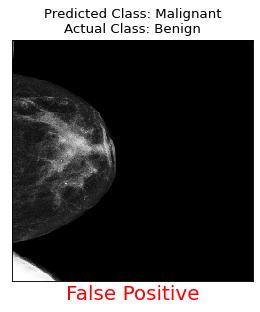

Truth: Benign
Predict: Malignant


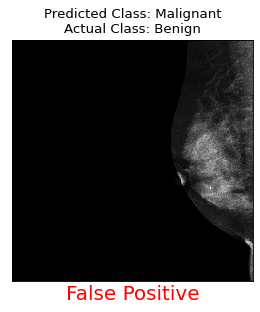

Truth: Benign
Predict: Malignant


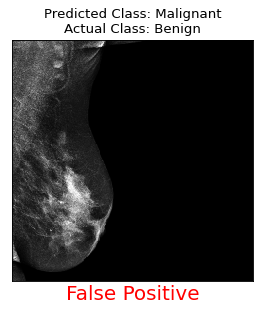

Truth: Benign
Predict: Malignant


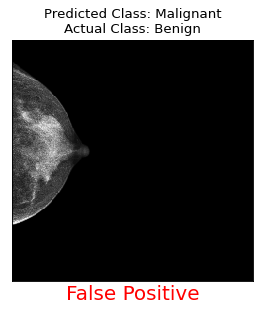

Truth: Benign
Predict: Malignant


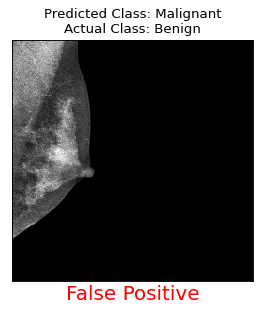

Truth: Benign
Predict: Benign


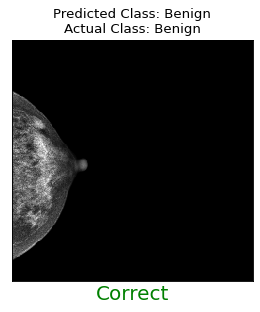

Truth: Benign
Predict: Malignant


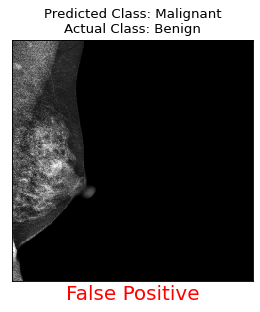

Truth: Benign
Predict: Malignant


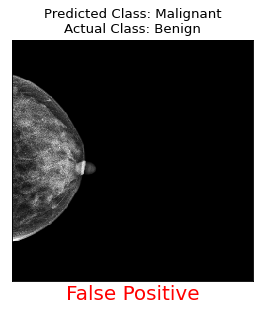

Truth: Benign
Predict: Malignant


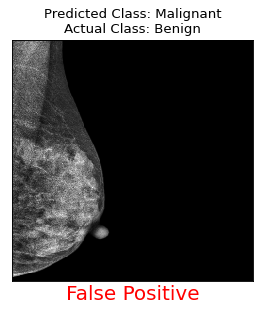

Truth: Benign
Predict: Malignant


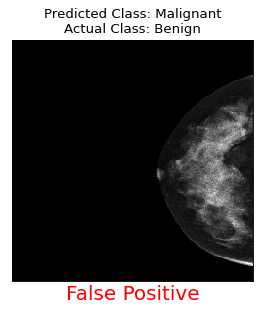

Truth: Benign
Predict: Malignant


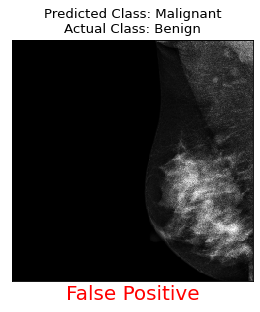

Truth: Benign
Predict: Malignant


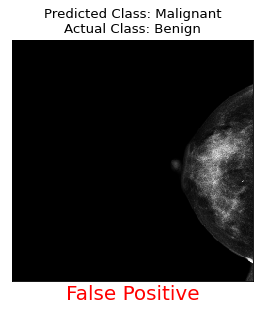

Truth: Benign
Predict: Malignant


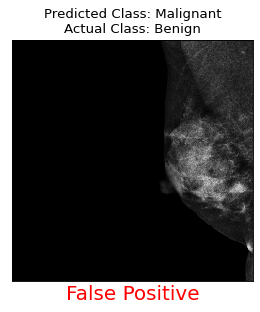

Truth: Benign
Predict: Malignant


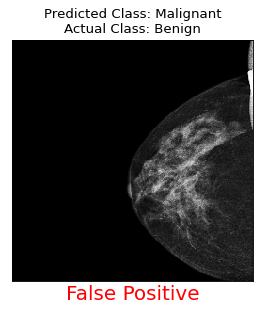

Truth: Benign
Predict: Malignant


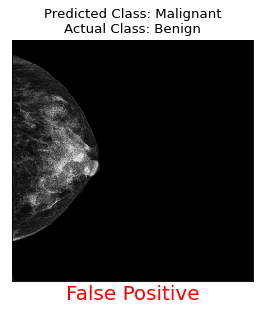

Truth: Benign
Predict: Malignant


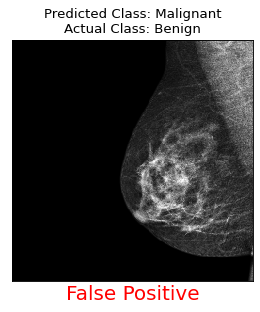

Truth: Benign
Predict: Malignant


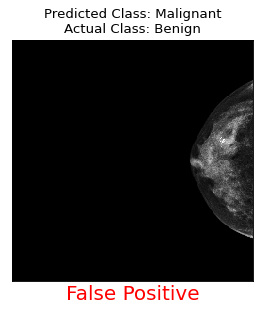

Truth: Benign
Predict: Malignant


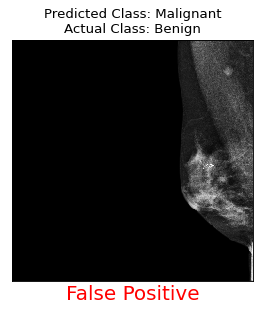

Truth: Benign
Predict: Malignant


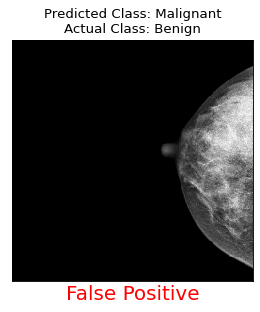

Truth: Benign
Predict: Malignant


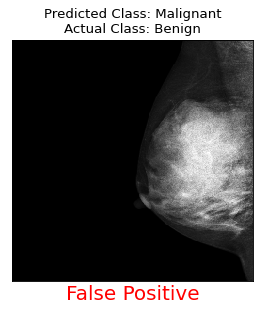

Truth: Benign
Predict: Malignant


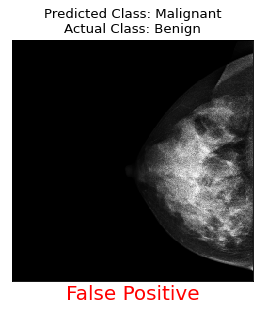

Truth: Benign
Predict: Malignant


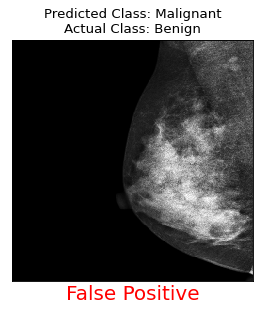

Truth: Benign
Predict: Malignant


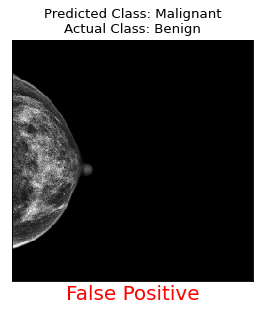

Truth: Benign
Predict: Benign


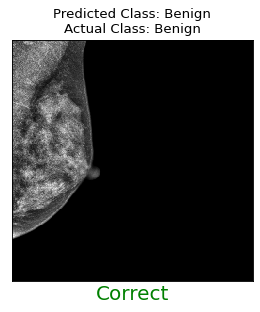

Truth: Benign
Predict: Malignant


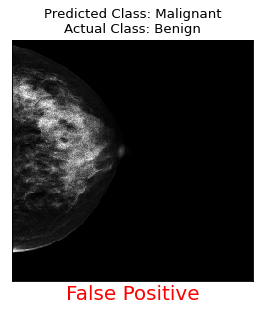

Truth: Benign
Predict: Malignant


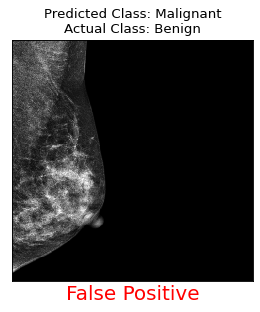

Truth: Benign
Predict: Malignant


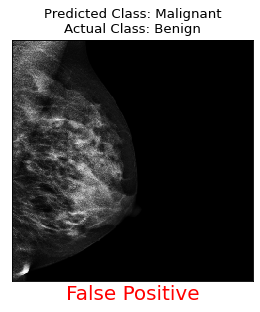

Truth: Benign
Predict: Malignant


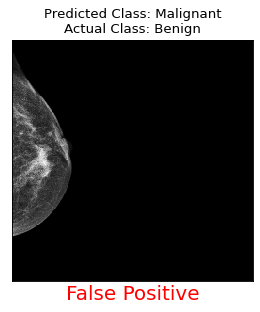

Truth: Benign
Predict: Malignant


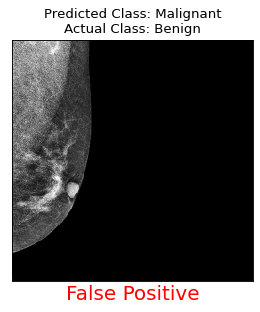

Truth: Benign
Predict: Malignant


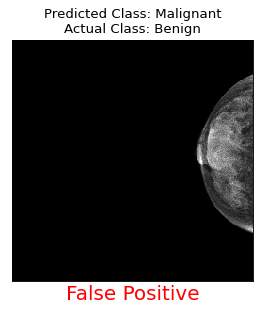

Truth: Benign
Predict: Malignant


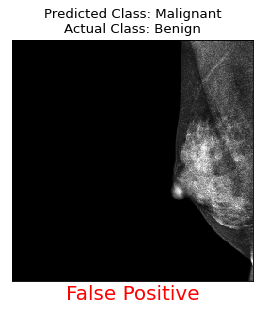

Truth: Benign
Predict: Malignant


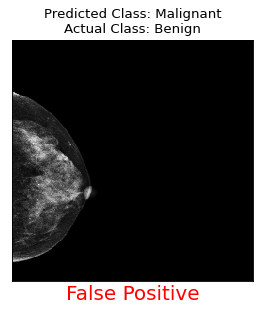

Truth: Benign
Predict: Malignant


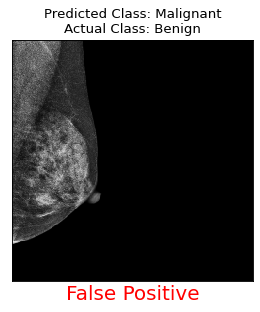

Truth: Benign
Predict: Malignant


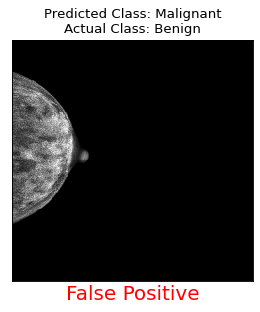

Truth: Benign
Predict: Malignant


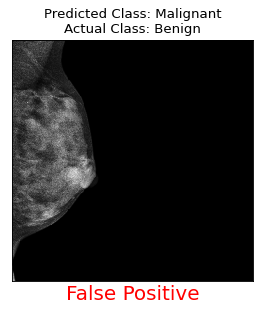

Truth: Benign
Predict: Malignant


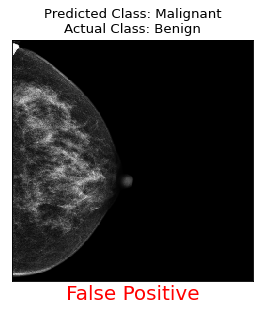

Truth: Benign
Predict: Benign


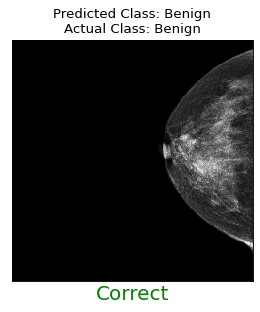

Truth: Benign
Predict: Malignant


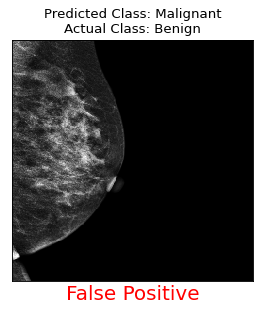

Truth: Benign
Predict: Malignant


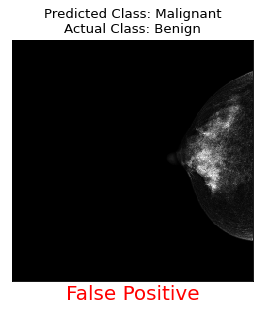

Truth: Benign
Predict: Malignant


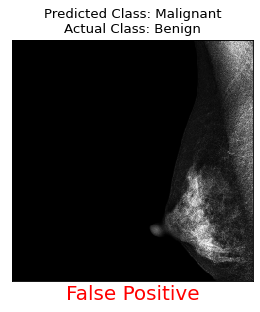

Truth: Benign
Predict: Malignant


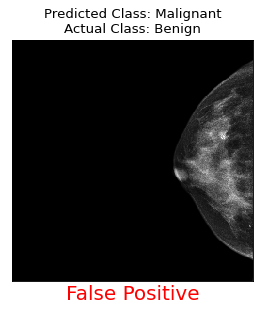

Truth: Benign
Predict: Malignant


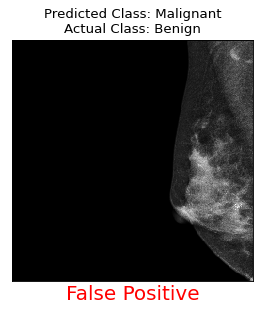

Truth: Benign
Predict: Malignant


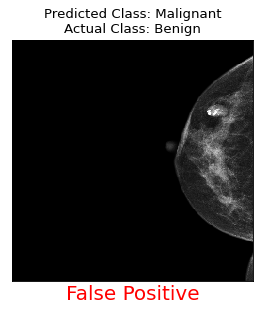

Truth: Benign
Predict: Malignant


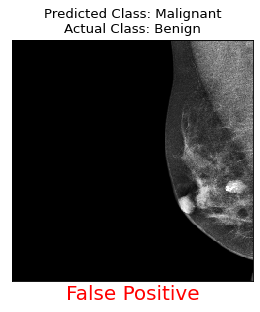

Truth: Benign
Predict: Malignant


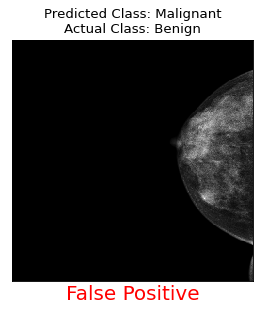

Truth: Benign
Predict: Malignant


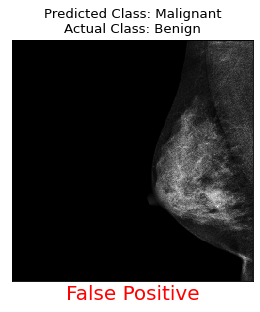

Truth: Benign
Predict: Malignant


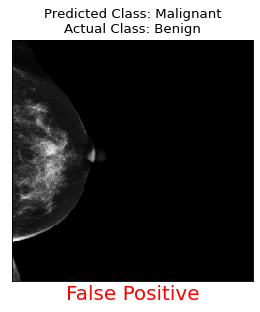

Truth: Benign
Predict: Malignant


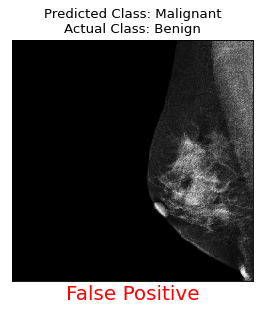

Truth: Benign
Predict: Benign


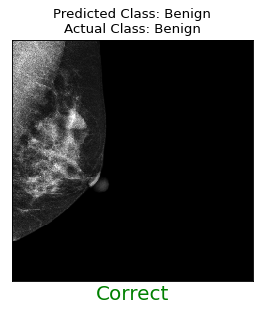

Truth: Benign
Predict: Benign


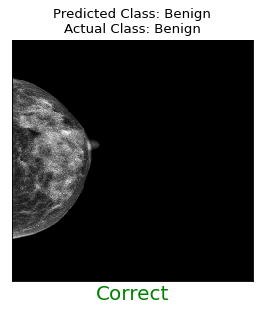

Truth: Benign
Predict: Benign


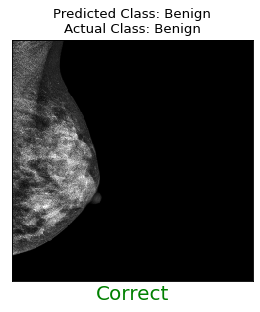

Truth: Benign
Predict: Malignant


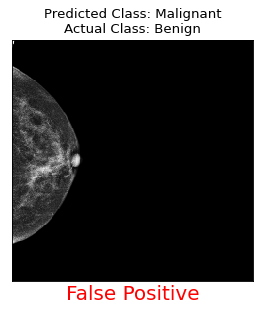

Truth: Benign
Predict: Malignant


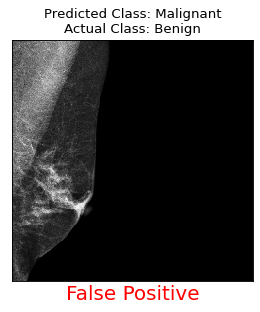

Truth: Benign
Predict: Malignant


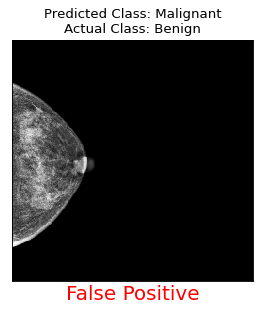

Truth: Benign
Predict: Benign


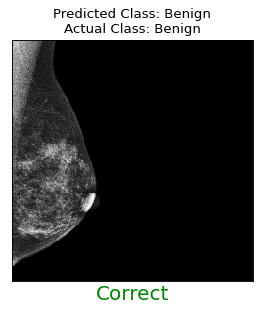

Truth: Benign
Predict: Malignant


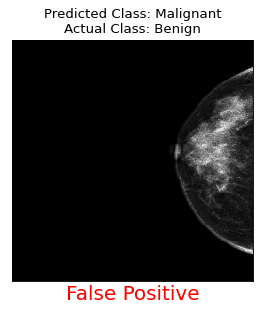

Truth: Benign
Predict: Malignant


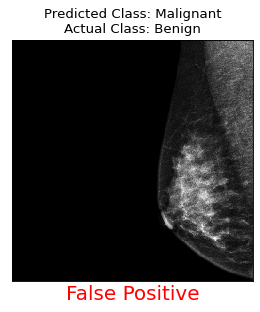

Truth: Benign
Predict: Malignant


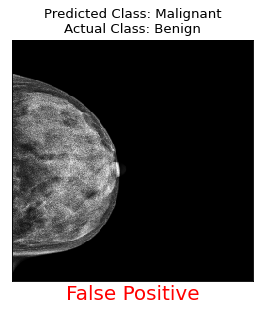

Truth: Benign
Predict: Malignant


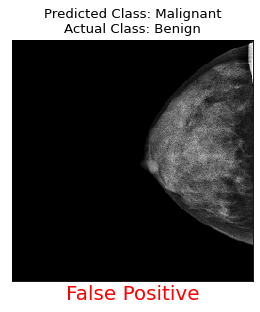

Truth: Benign
Predict: Malignant


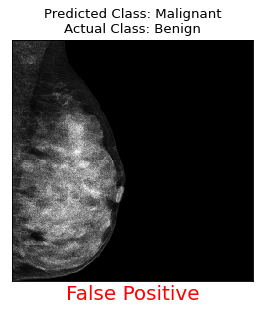

Truth: Benign
Predict: Malignant


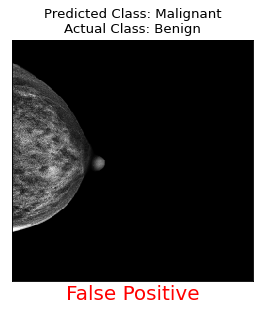

Truth: Benign
Predict: Malignant


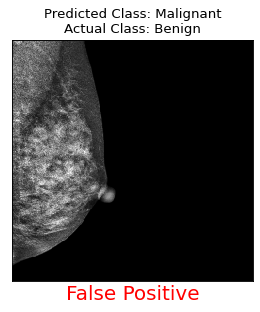

Truth: Benign
Predict: Malignant


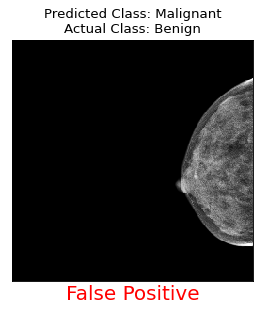

Truth: Benign
Predict: Malignant


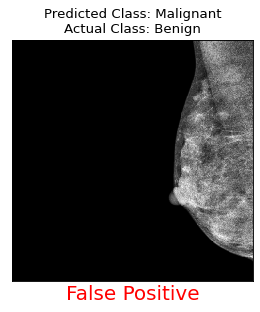

Truth: Benign
Predict: Malignant


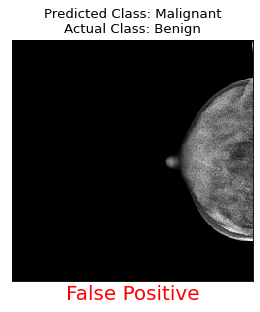

Truth: Benign
Predict: Malignant


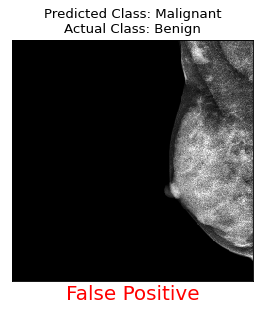

Truth: Benign
Predict: Malignant


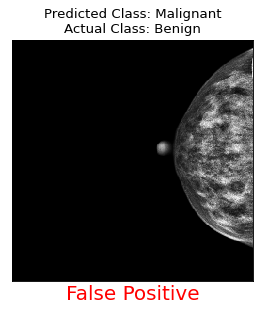

Truth: Benign
Predict: Malignant


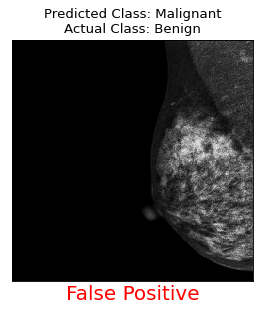

Truth: Benign
Predict: Malignant


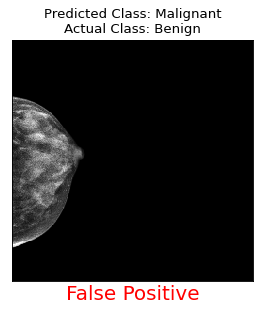

Truth: Benign
Predict: Malignant


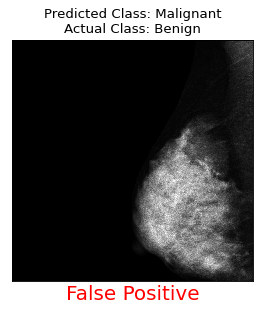

Truth: Benign
Predict: Malignant


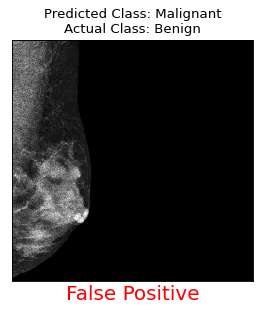

Truth: Benign
Predict: Malignant


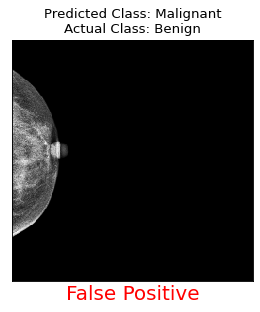

Truth: Benign
Predict: Malignant


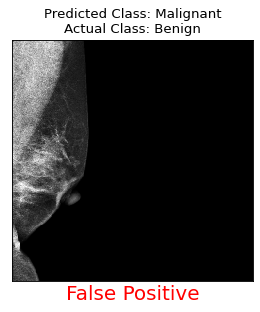

Truth: Benign
Predict: Malignant


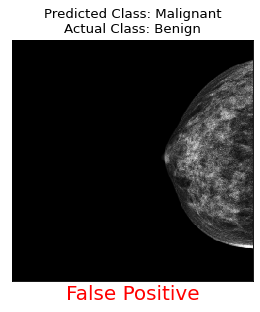

Truth: Benign
Predict: Malignant


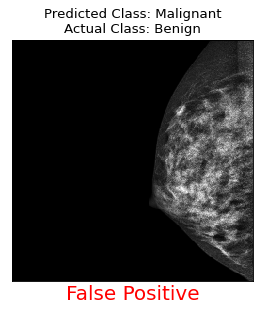

Truth: Benign
Predict: Malignant


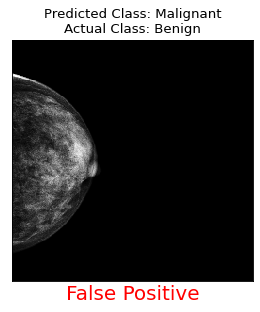

Truth: Benign
Predict: Malignant


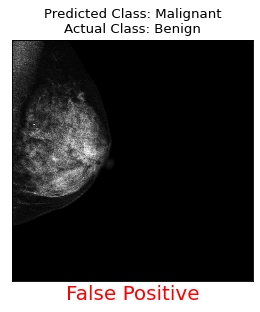

Truth: Benign
Predict: Malignant


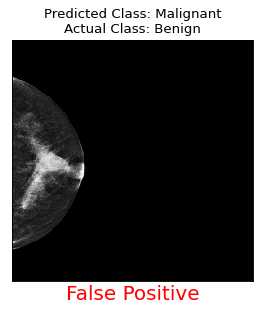

Truth: Benign
Predict: Malignant


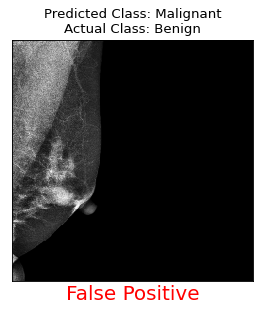

Truth: Benign
Predict: Malignant


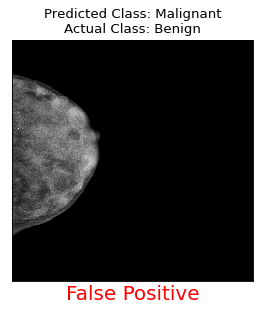

Truth: Benign
Predict: Malignant


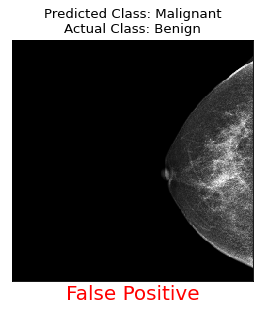

Truth: Benign
Predict: Malignant


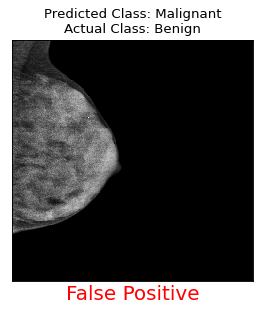

Truth: Benign
Predict: Malignant


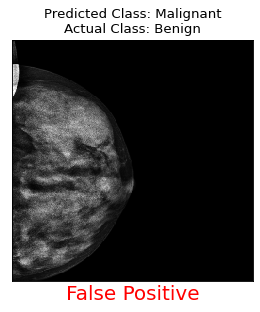

Truth: Benign
Predict: Malignant


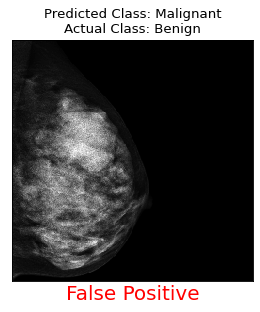

Truth: Benign
Predict: Malignant


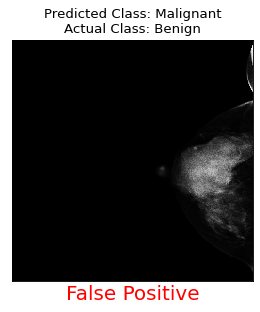

Truth: Benign
Predict: Malignant


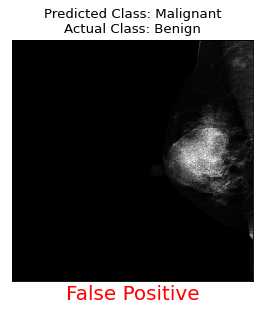

Truth: Benign
Predict: Malignant


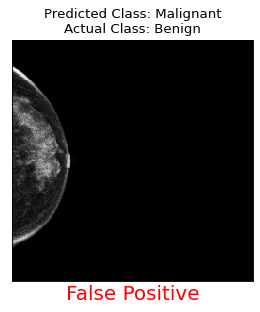

Truth: Benign
Predict: Malignant


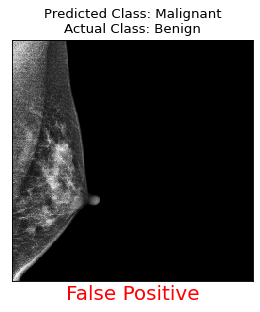

Truth: Benign
Predict: Malignant


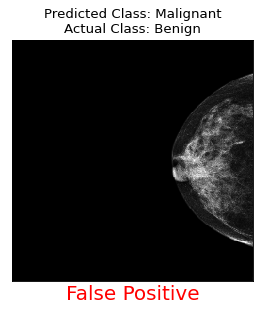

Truth: Benign
Predict: Malignant


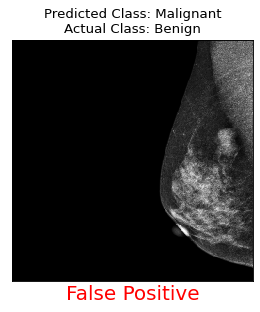

Truth: Benign
Predict: Malignant


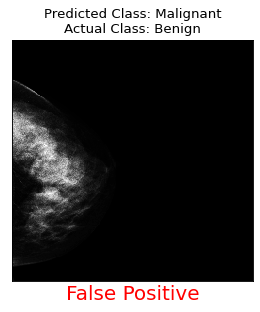

Truth: Benign
Predict: Malignant


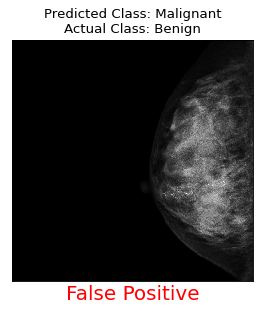

Truth: Benign
Predict: Malignant


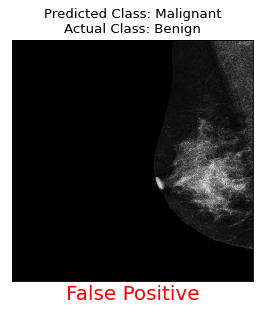

Truth: Benign
Predict: Malignant


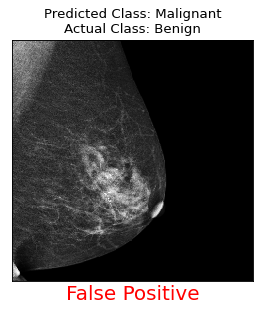

Truth: Benign
Predict: Benign


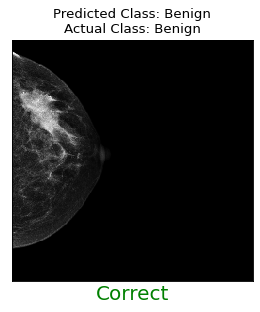

Truth: Benign
Predict: Malignant


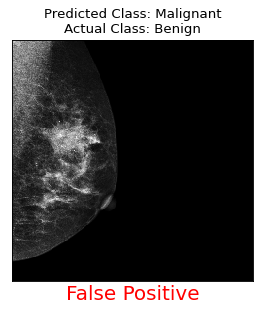

Truth: Benign
Predict: Malignant


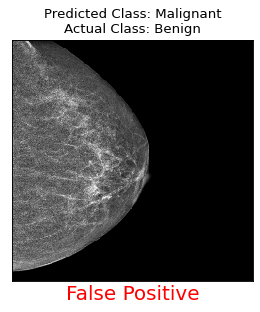

Truth: Benign
Predict: Malignant


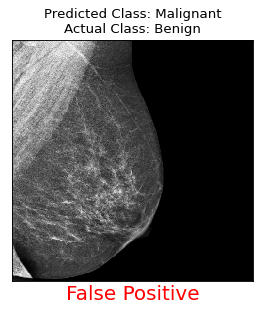

Truth: Benign
Predict: Malignant


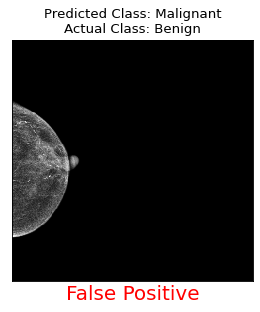

Truth: Benign
Predict: Malignant


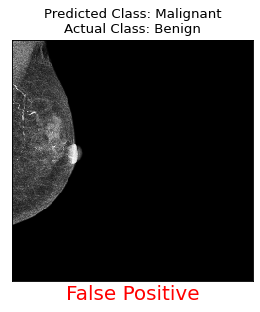

Truth: Benign
Predict: Malignant


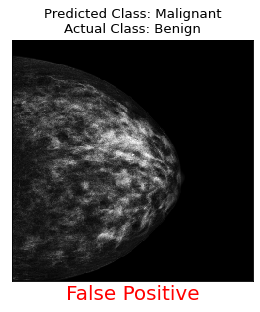

Truth: Benign
Predict: Malignant


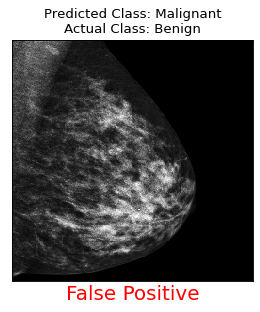

Truth: Benign
Predict: Malignant


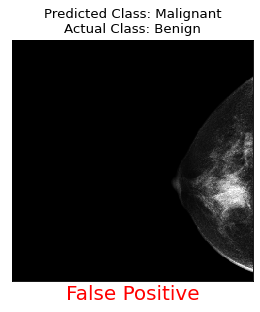

Truth: Benign
Predict: Malignant


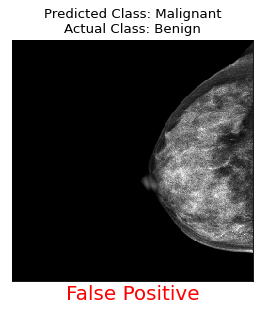

Truth: Benign
Predict: Malignant


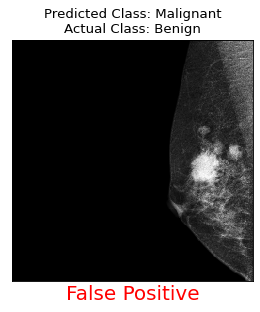

Truth: Benign
Predict: Malignant


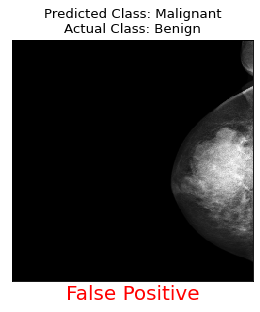

Truth: Benign
Predict: Malignant


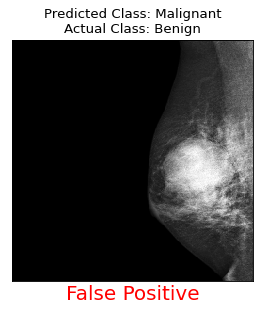

Truth: Benign
Predict: Malignant


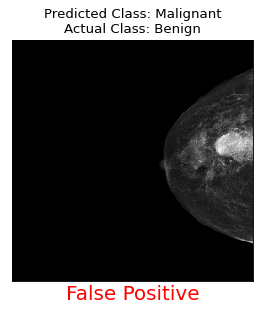

Truth: Benign
Predict: Malignant


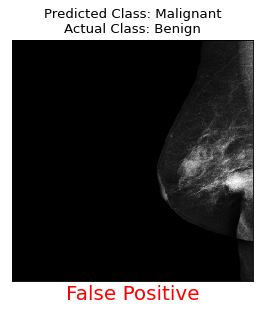

Truth: Benign
Predict: Malignant


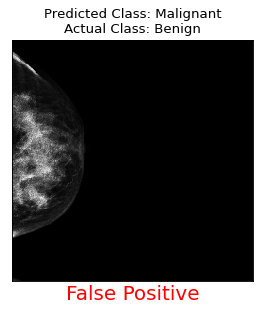

Truth: Benign
Predict: Malignant


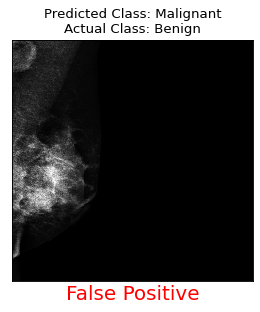

Truth: Benign
Predict: Malignant


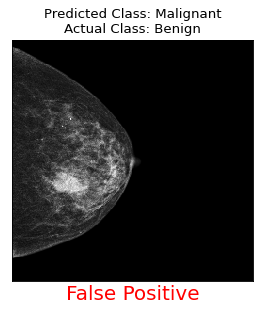

Truth: Benign
Predict: Benign


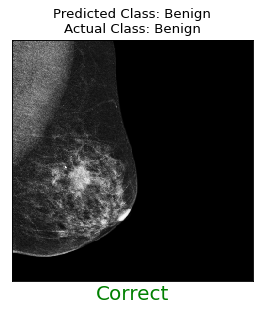

Truth: Benign
Predict: Malignant


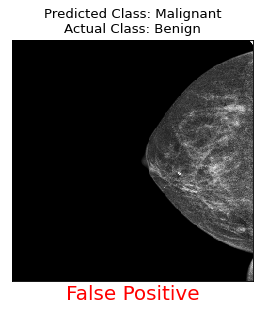

Truth: Benign
Predict: Malignant


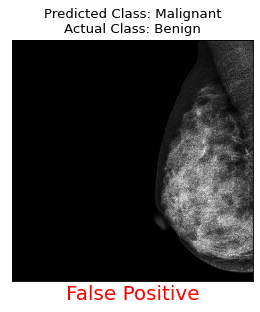

Truth: Benign
Predict: Malignant


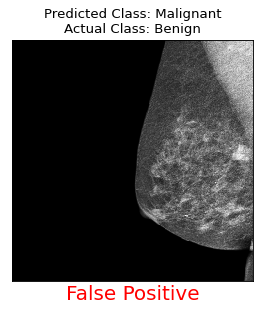

Truth: Benign
Predict: Malignant


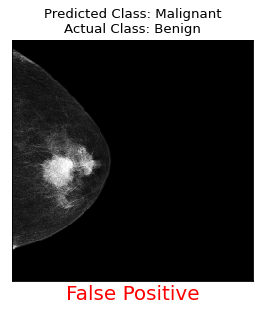

Truth: Benign
Predict: Malignant


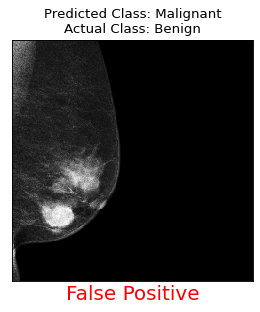

Truth: Benign
Predict: Malignant


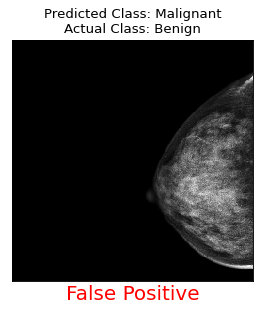

Truth: Benign
Predict: Malignant


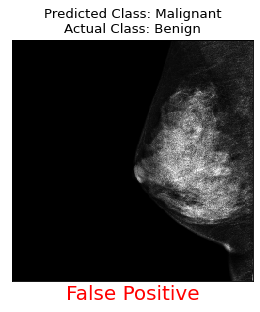

Truth: Benign
Predict: Malignant


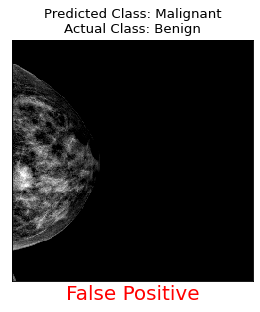

Truth: Benign
Predict: Malignant


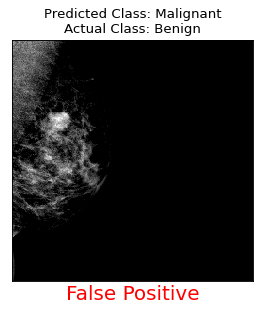

Truth: Benign
Predict: Malignant


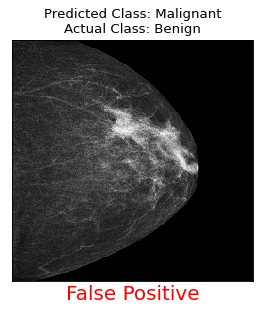

Truth: Benign
Predict: Malignant


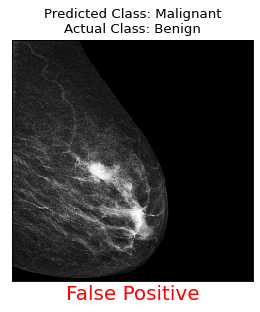

Truth: Benign
Predict: Malignant


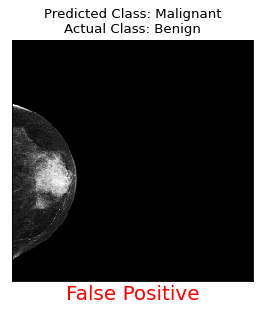

Truth: Benign
Predict: Malignant


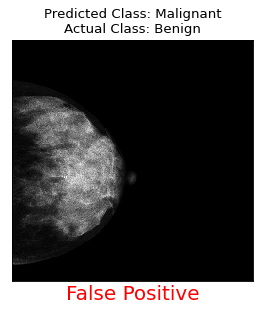

Truth: Benign
Predict: Malignant


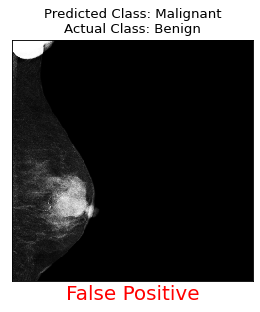

Truth: Benign
Predict: Benign


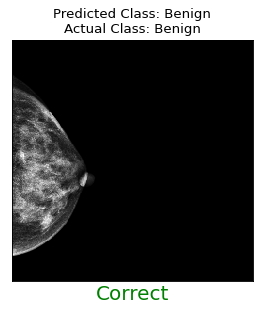

Truth: Benign
Predict: Malignant


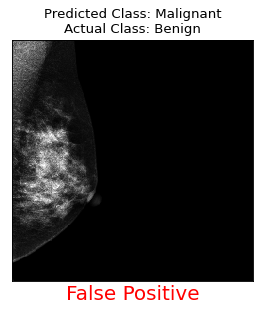

Truth: Benign
Predict: Malignant


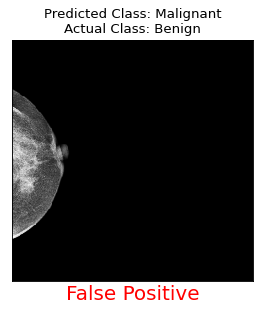

Truth: Benign
Predict: Malignant


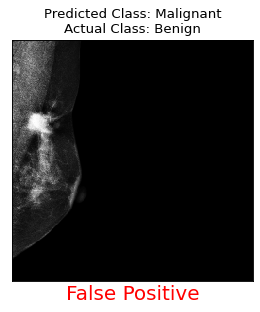

Truth: Benign
Predict: Malignant


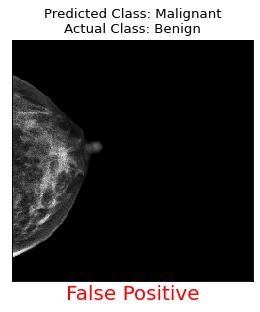

Truth: Benign
Predict: Malignant


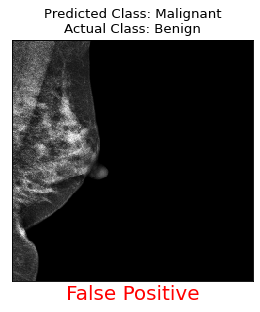

Truth: Benign
Predict: Malignant


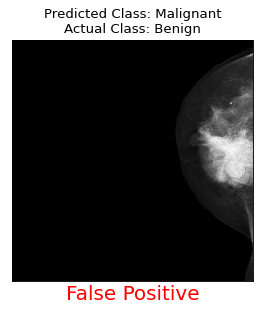

Truth: Benign
Predict: Malignant


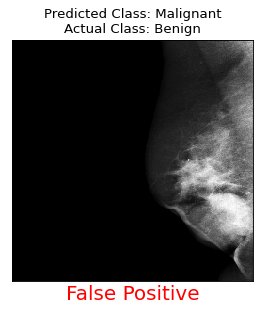

Truth: Benign
Predict: Malignant


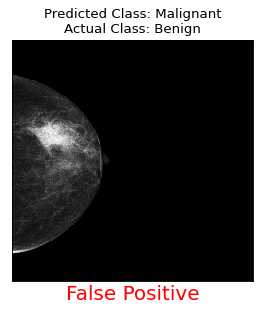

Truth: Benign
Predict: Malignant


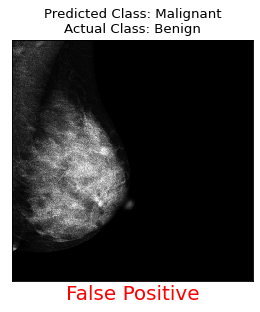

Truth: Benign
Predict: Malignant


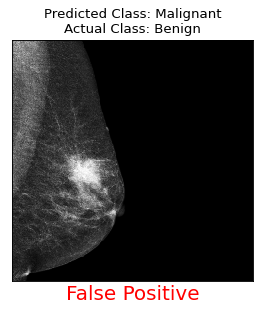

Truth: Benign
Predict: Malignant


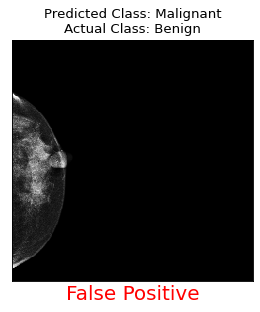

Truth: Benign
Predict: Malignant


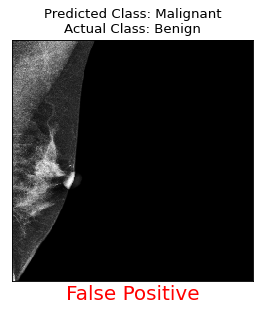

Truth: Benign
Predict: Malignant


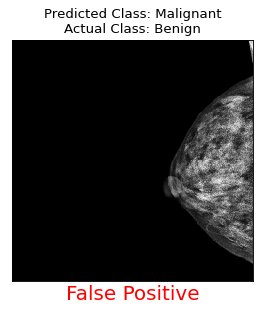

Truth: Benign
Predict: Malignant


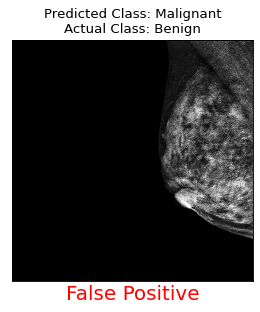

Truth: Benign
Predict: Malignant


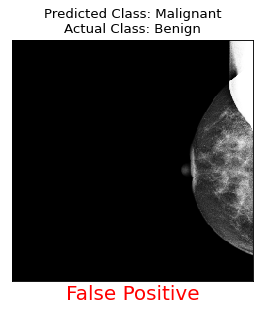

Truth: Benign
Predict: Malignant


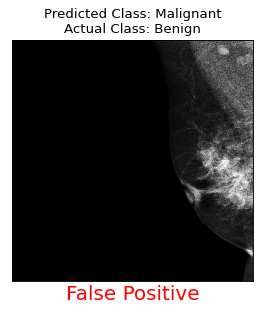

Truth: Benign
Predict: Malignant


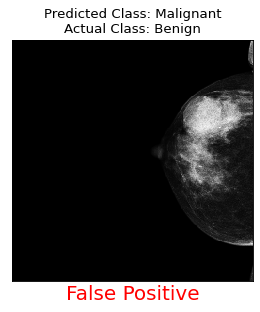

Truth: Benign
Predict: Malignant


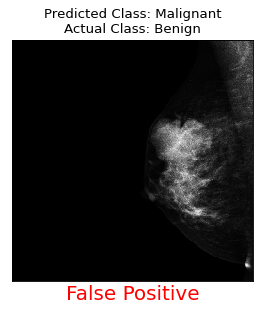

Truth: Benign
Predict: Malignant


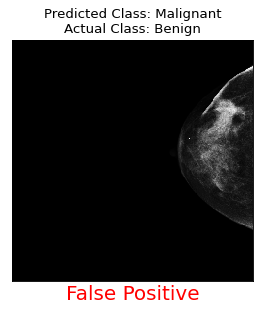

Truth: Benign
Predict: Malignant


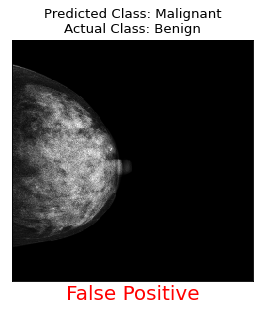

Truth: Benign
Predict: Malignant


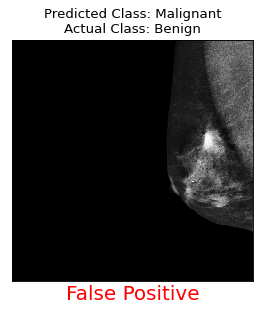

Truth: Benign
Predict: Malignant


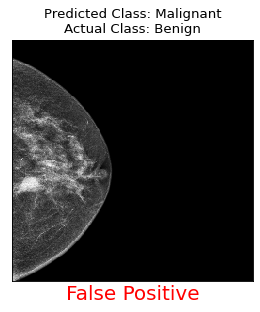

Truth: Benign
Predict: Malignant


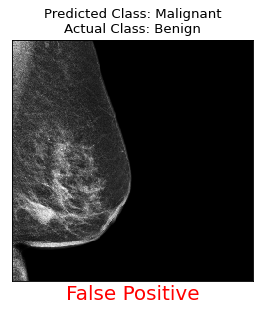

Truth: Benign
Predict: Malignant


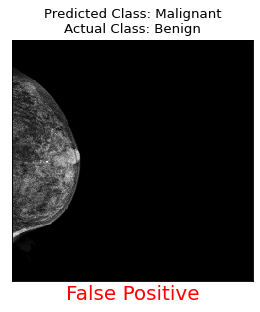

Truth: Benign
Predict: Malignant


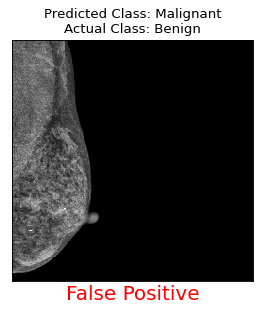

Truth: Benign
Predict: Malignant


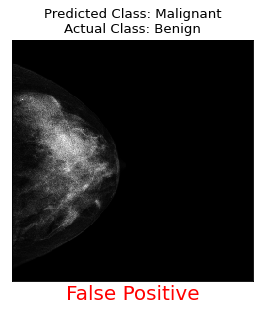

Truth: Benign
Predict: Malignant


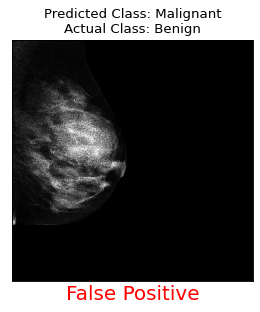

Truth: Benign
Predict: Benign


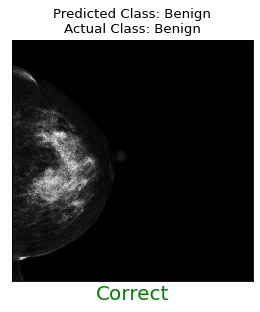

Truth: Benign
Predict: Malignant


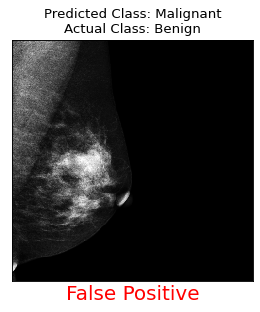

Truth: Benign
Predict: Benign


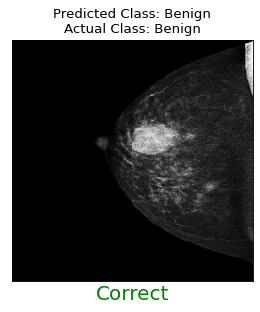

Truth: Benign
Predict: Benign


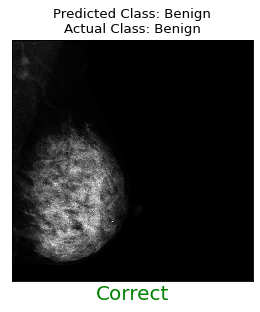

Truth: Benign
Predict: Malignant


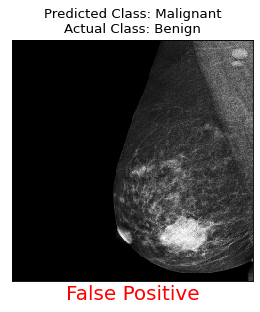

Truth: Benign
Predict: Malignant


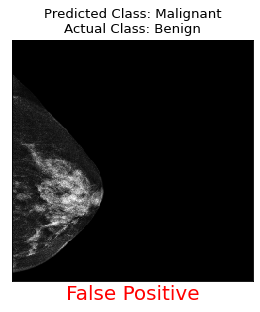

Truth: Benign
Predict: Malignant


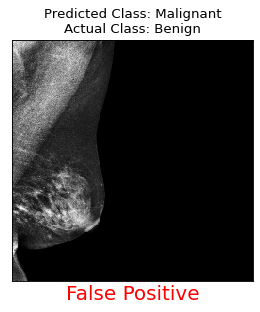

Truth: Benign
Predict: Malignant


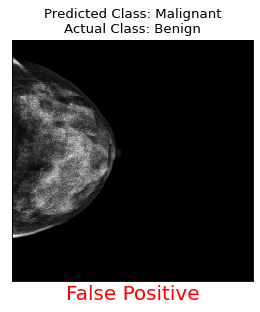

Truth: Benign
Predict: Malignant


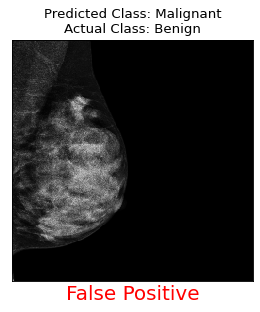

Truth: Benign
Predict: Malignant


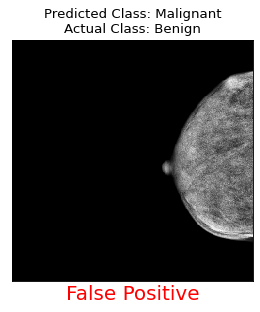

Truth: Benign
Predict: Malignant


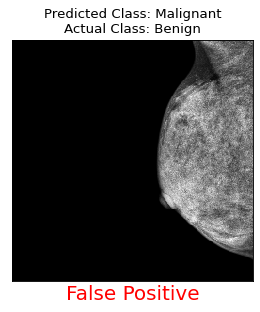

Truth: Benign
Predict: Malignant


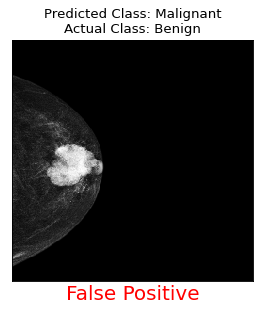

Truth: Benign
Predict: Malignant


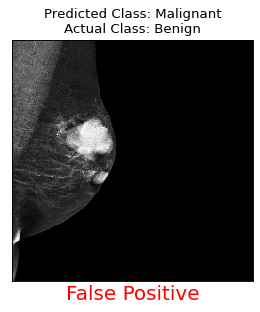

Truth: Benign
Predict: Malignant


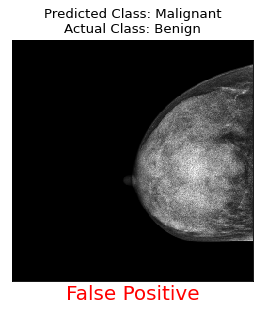

Truth: Benign
Predict: Malignant


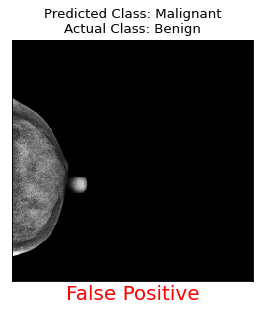

Truth: Benign
Predict: Malignant


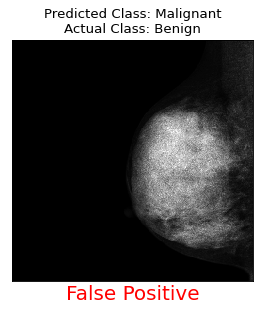

Truth: Benign
Predict: Malignant


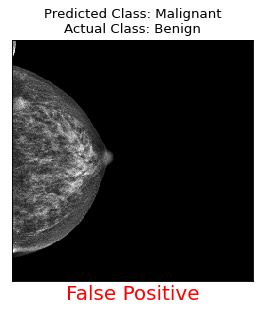

Truth: Benign
Predict: Benign


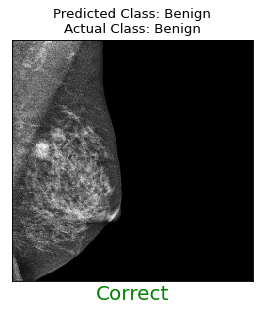

Truth: Benign
Predict: Malignant


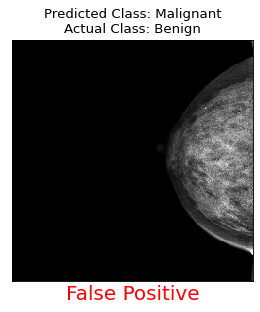

Truth: Benign
Predict: Malignant


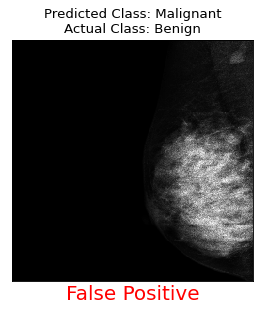

Truth: Benign
Predict: Malignant


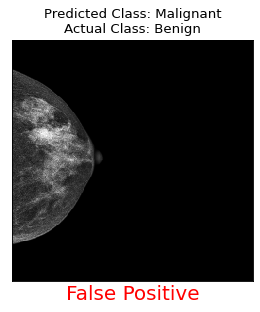

Truth: Benign
Predict: Benign


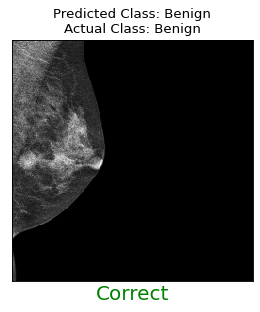

Truth: Benign
Predict: Malignant


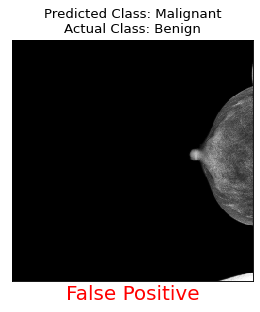

Truth: Benign
Predict: Malignant


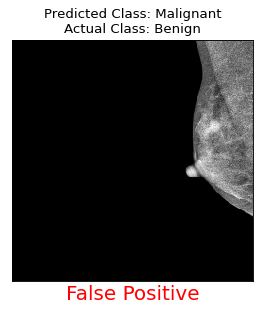

Truth: Benign
Predict: Malignant


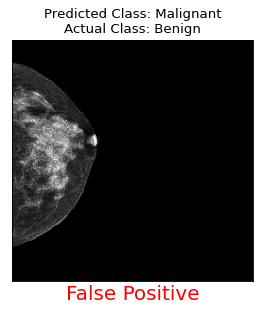

Truth: Benign
Predict: Malignant


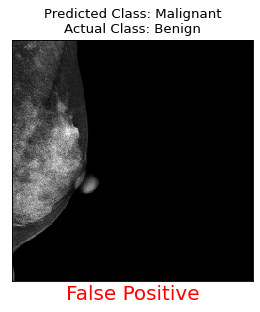

Truth: Benign
Predict: Malignant


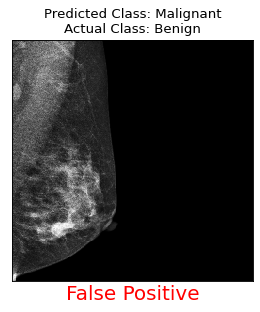

Truth: Benign
Predict: Malignant


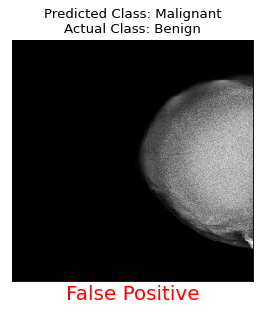

Truth: Benign
Predict: Malignant


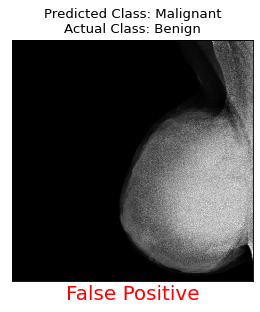

Truth: Malignant
Predict: Benign


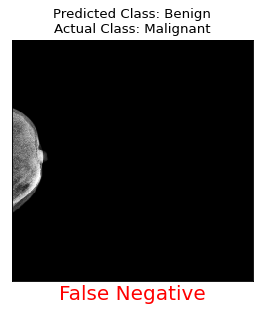

Truth: Malignant
Predict: Malignant


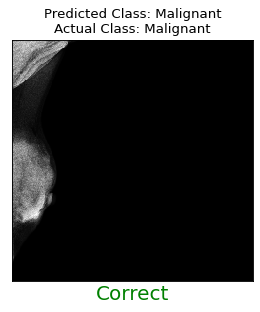

Truth: Malignant
Predict: Malignant


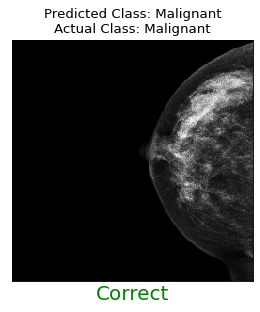

Truth: Malignant
Predict: Malignant


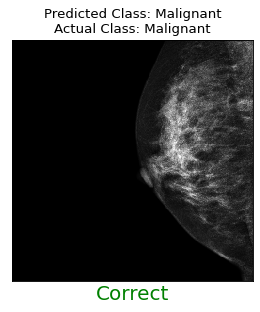

Truth: Malignant
Predict: Malignant


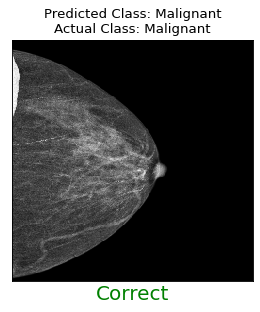

Truth: Malignant
Predict: Malignant


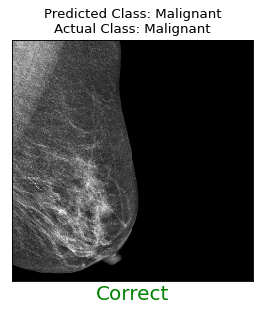

Truth: Malignant
Predict: Malignant


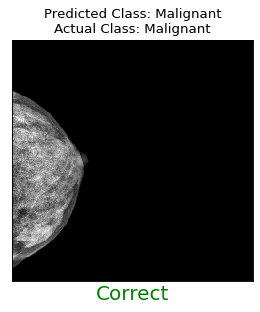

Truth: Malignant
Predict: Malignant


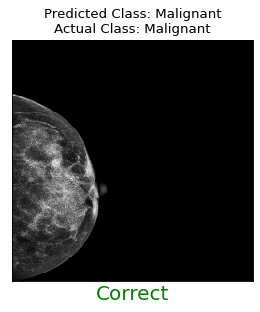

Truth: Malignant
Predict: Malignant


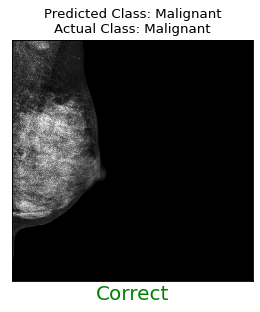

Truth: Malignant
Predict: Malignant


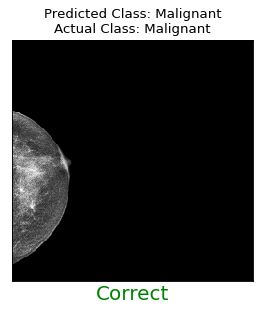

Truth: Malignant
Predict: Malignant


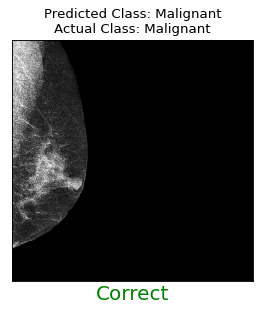

Truth: Malignant
Predict: Malignant


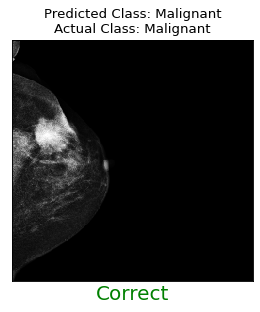

Truth: Malignant
Predict: Malignant


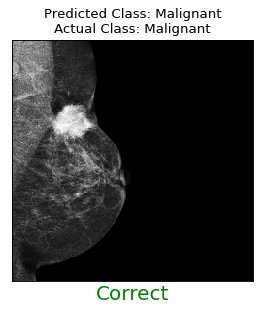

Truth: Malignant
Predict: Malignant


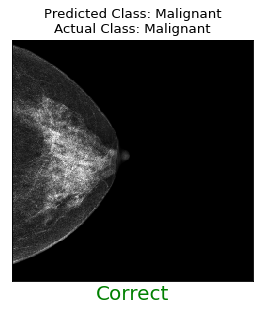

Truth: Malignant
Predict: Malignant


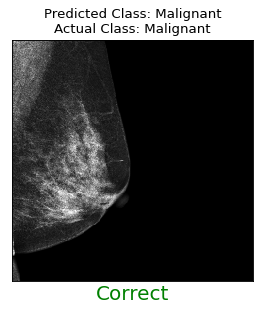

Truth: Malignant
Predict: Malignant


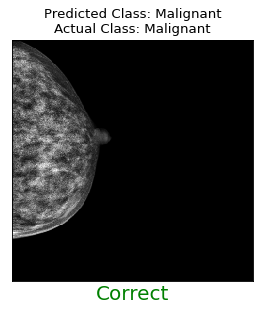

Truth: Malignant
Predict: Malignant


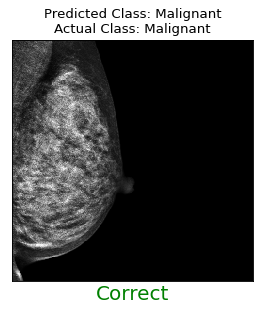

Truth: Malignant
Predict: Malignant


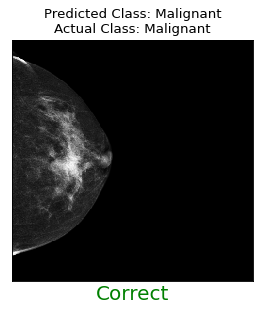

Truth: Malignant
Predict: Malignant


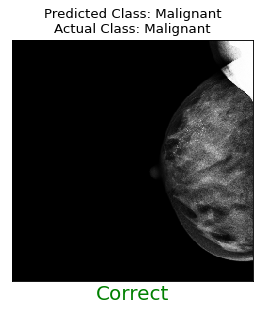

Truth: Malignant
Predict: Malignant


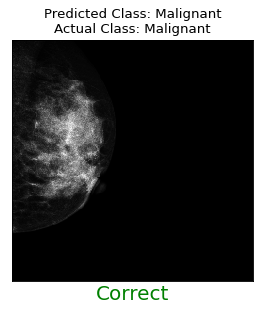

Truth: Malignant
Predict: Malignant


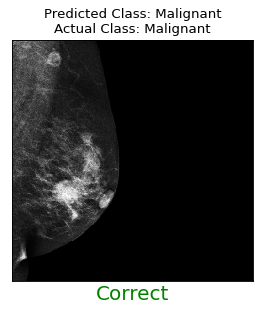

Truth: Malignant
Predict: Malignant


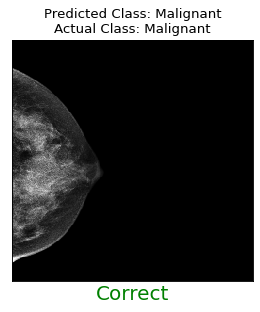

Truth: Malignant
Predict: Malignant


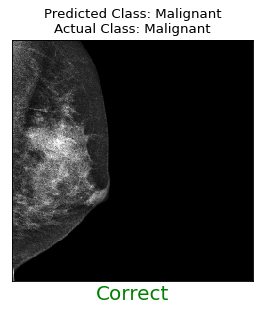

Truth: Malignant
Predict: Malignant


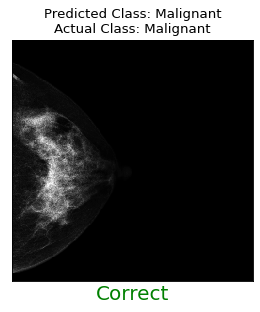

Truth: Malignant
Predict: Malignant


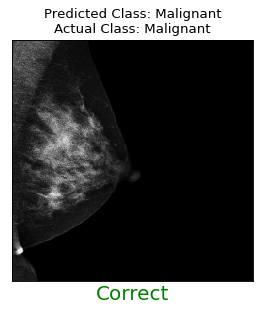

Truth: Malignant
Predict: Malignant


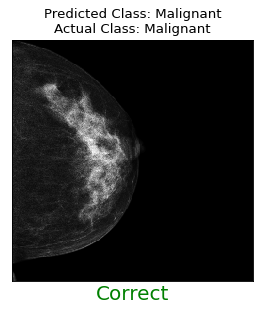

Truth: Malignant
Predict: Malignant


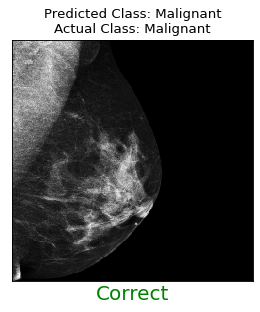

Truth: Malignant
Predict: Malignant


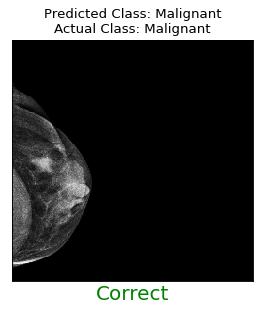

Truth: Malignant
Predict: Benign


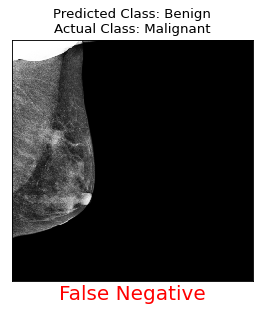

Truth: Malignant
Predict: Malignant


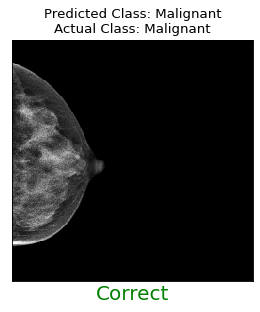

Truth: Malignant
Predict: Malignant


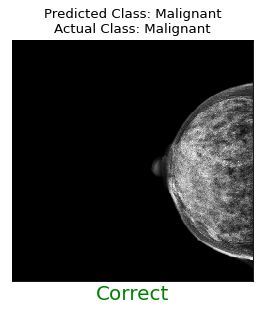

Truth: Malignant
Predict: Malignant


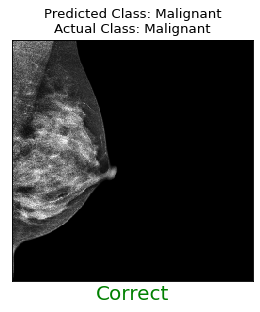

Truth: Malignant
Predict: Malignant


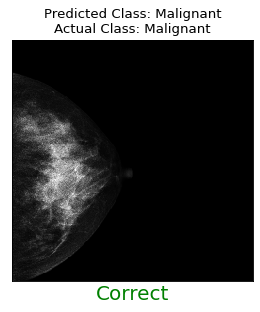

Truth: Malignant
Predict: Malignant


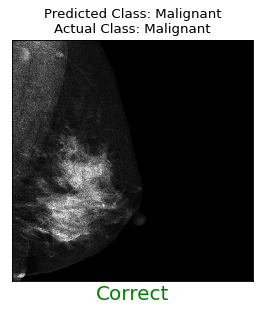

Truth: Malignant
Predict: Malignant


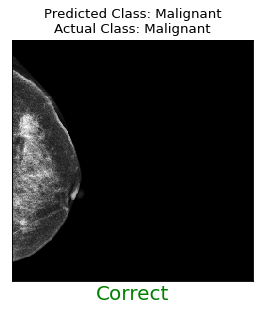

Truth: Malignant
Predict: Malignant


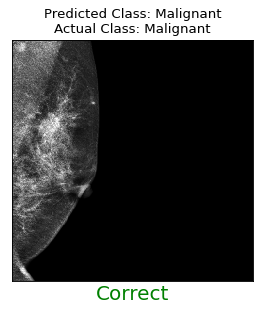

Truth: Malignant
Predict: Malignant


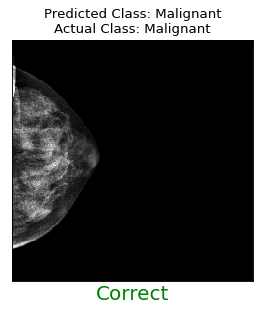

Truth: Malignant
Predict: Malignant


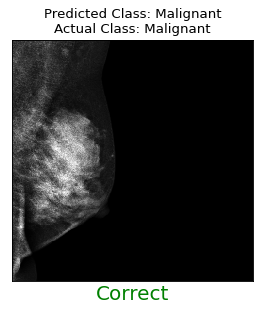

Truth: Malignant
Predict: Malignant


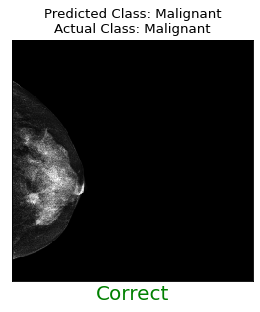

Truth: Malignant
Predict: Malignant


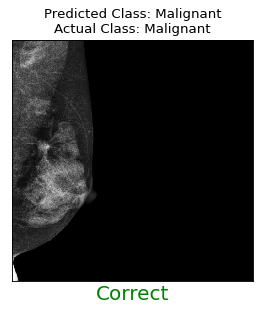

Truth: Malignant
Predict: Malignant


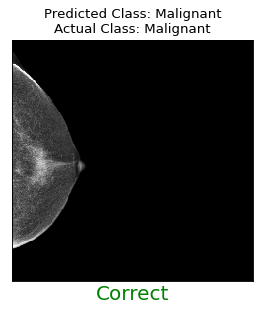

Truth: Malignant
Predict: Malignant


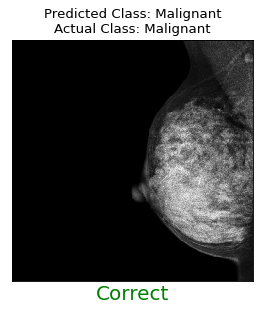

Truth: Malignant
Predict: Malignant


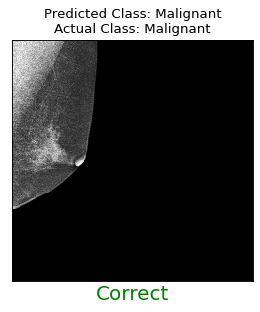

Truth: Malignant
Predict: Benign


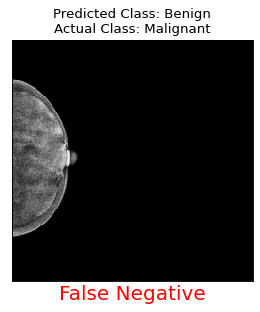

Truth: Malignant
Predict: Malignant


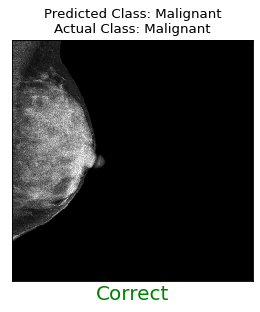

Truth: Malignant
Predict: Malignant


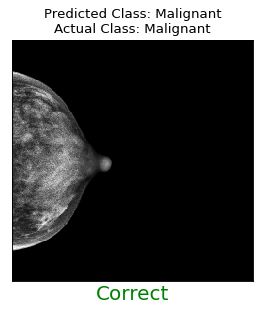

Truth: Malignant
Predict: Malignant


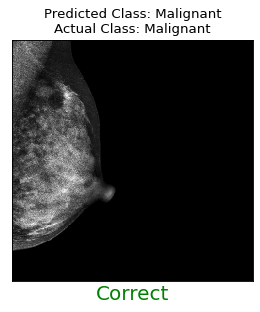

Truth: Malignant
Predict: Malignant


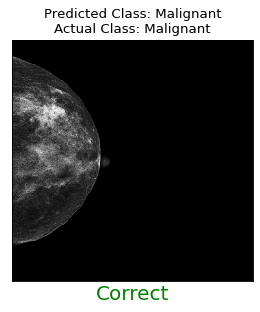

Truth: Malignant
Predict: Malignant


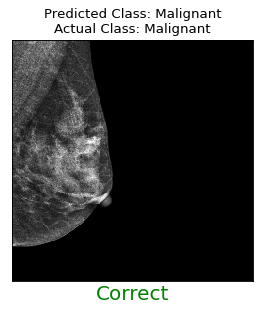

Truth: Malignant
Predict: Malignant


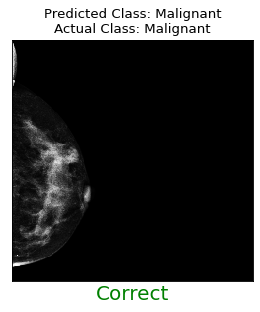

Truth: Malignant
Predict: Malignant


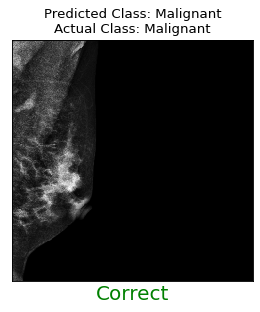

Truth: Malignant
Predict: Malignant


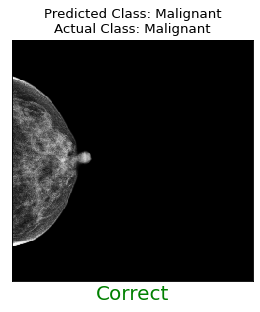

Truth: Malignant
Predict: Malignant


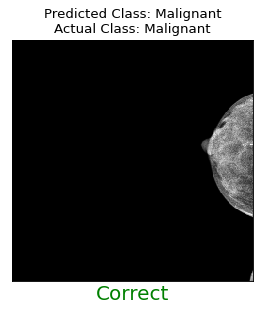

Truth: Malignant
Predict: Malignant


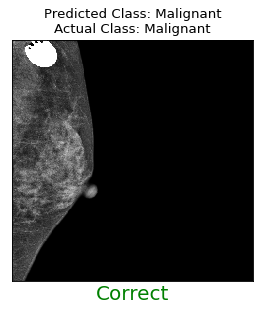

Truth: Malignant
Predict: Malignant


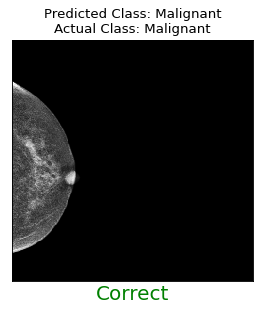

Truth: Malignant
Predict: Malignant


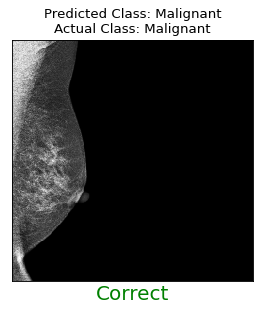

Truth: Malignant
Predict: Malignant


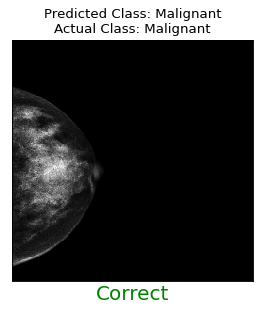

Truth: Malignant
Predict: Malignant


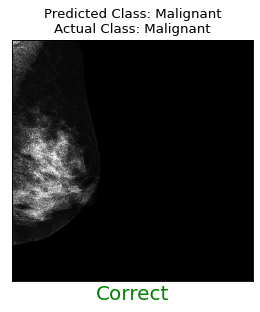

Truth: Malignant
Predict: Malignant


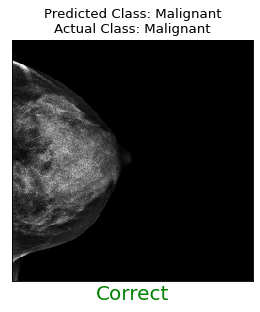

Truth: Malignant
Predict: Malignant


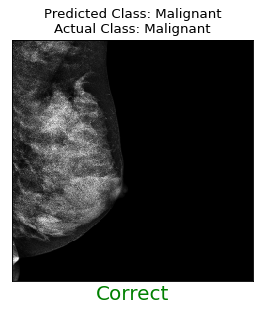

Truth: Malignant
Predict: Malignant


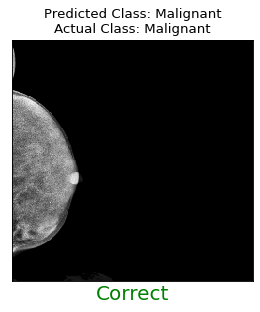

Truth: Malignant
Predict: Malignant


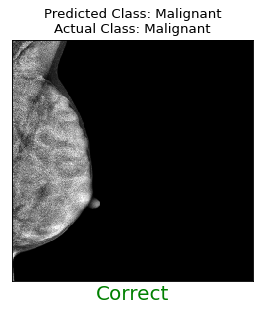

Truth: Malignant
Predict: Malignant


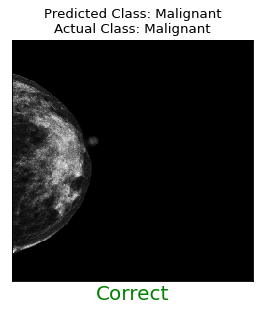

Truth: Malignant
Predict: Malignant


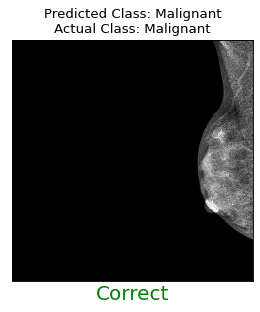

Truth: Malignant
Predict: Malignant


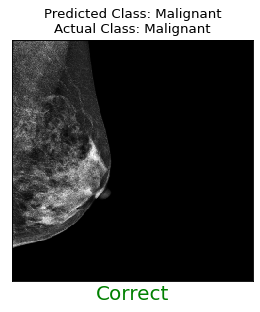

Truth: Malignant
Predict: Malignant


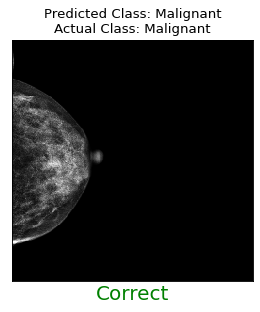

Truth: Malignant
Predict: Malignant


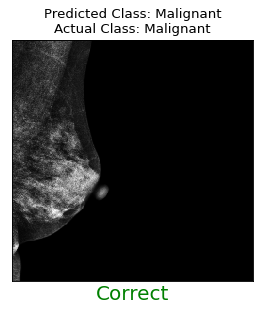

Truth: Malignant
Predict: Malignant


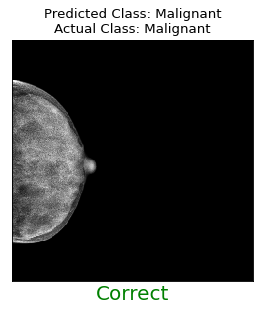

Truth: Malignant
Predict: Malignant


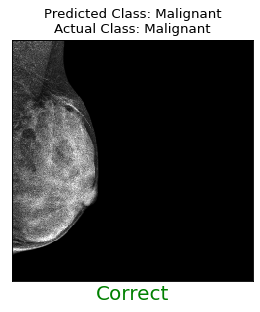

Truth: Malignant
Predict: Malignant


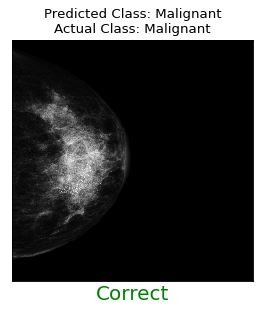

Truth: Malignant
Predict: Malignant


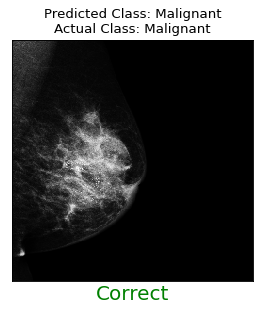

Truth: Malignant
Predict: Malignant


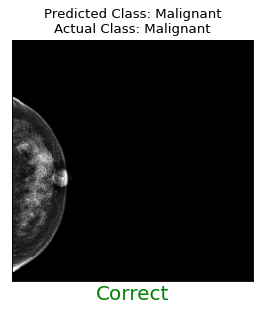

Truth: Malignant
Predict: Benign


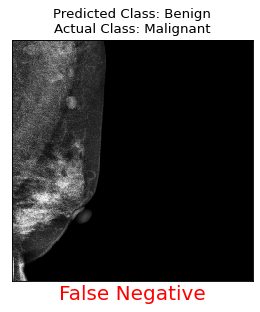

Truth: Malignant
Predict: Benign


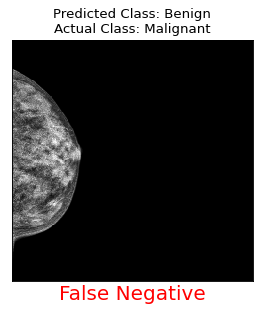

Truth: Malignant
Predict: Malignant


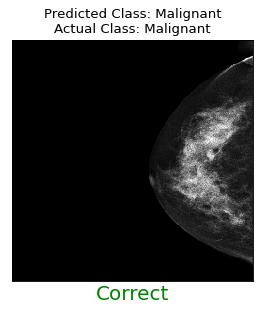

Truth: Malignant
Predict: Malignant


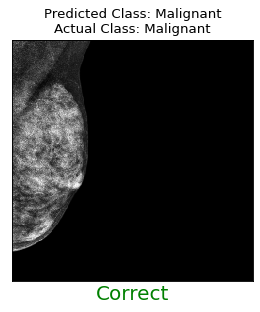

Truth: Malignant
Predict: Malignant


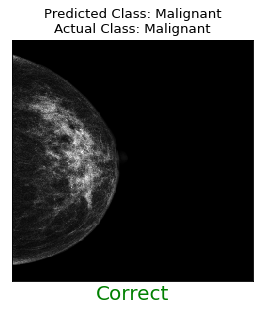

Truth: Malignant
Predict: Malignant


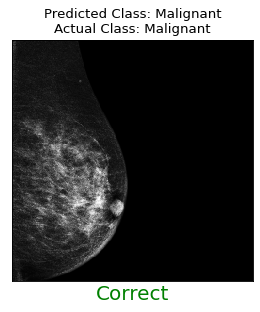

Truth: Malignant
Predict: Malignant


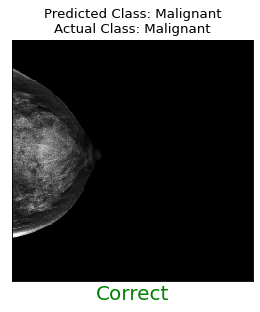

Truth: Malignant
Predict: Malignant


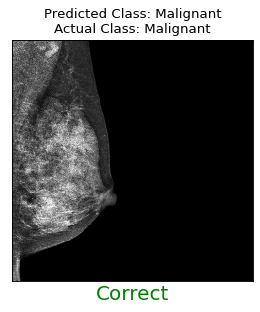

Truth: Malignant
Predict: Malignant


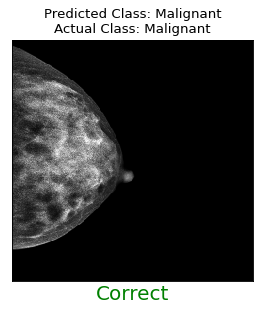

Truth: Malignant
Predict: Malignant


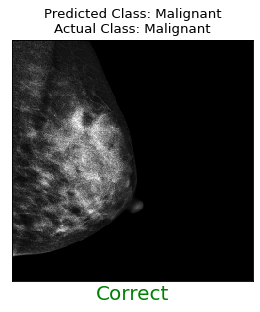

Truth: Malignant
Predict: Malignant


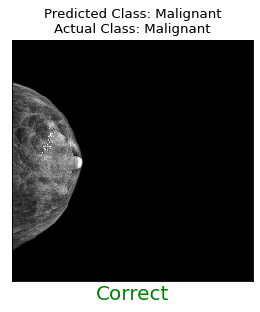

Truth: Malignant
Predict: Malignant


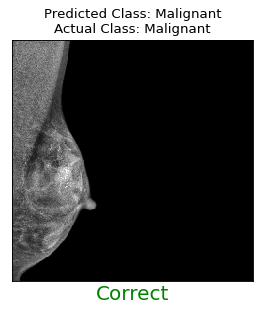

Truth: Malignant
Predict: Malignant


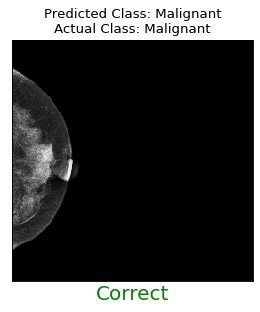

Truth: Malignant
Predict: Malignant


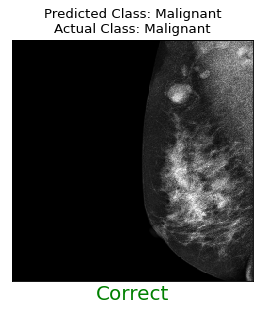

Truth: Malignant
Predict: Malignant


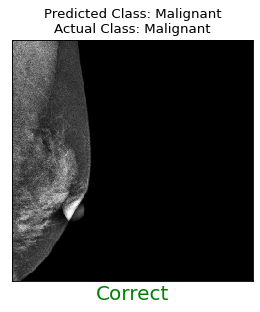

Truth: Malignant
Predict: Malignant


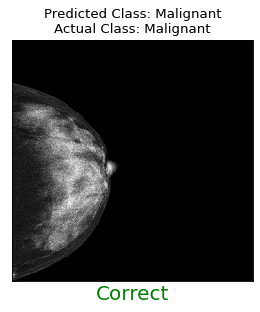

Truth: Malignant
Predict: Malignant


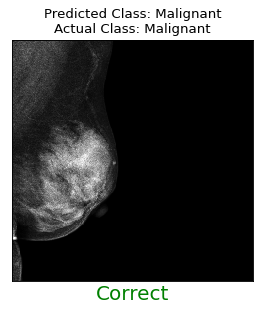

Truth: Malignant
Predict: Benign


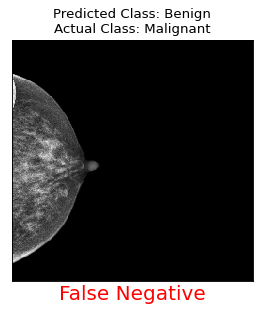

Truth: Malignant
Predict: Malignant


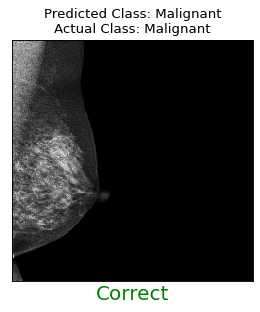

Truth: Malignant
Predict: Benign


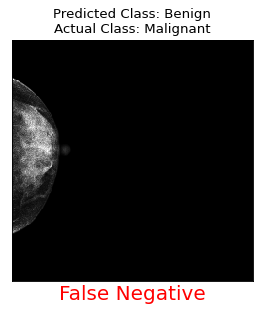

Truth: Malignant
Predict: Malignant


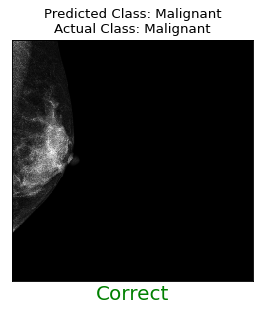

Truth: Malignant
Predict: Malignant


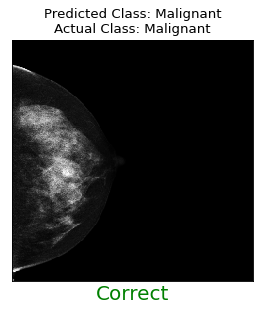

Truth: Malignant
Predict: Malignant


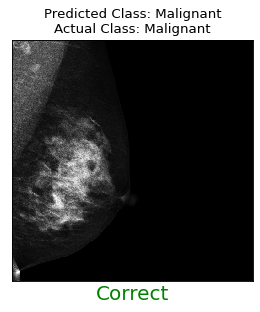

Truth: Malignant
Predict: Malignant


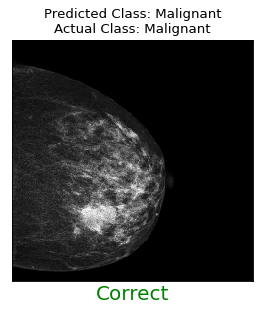

Truth: Malignant
Predict: Malignant


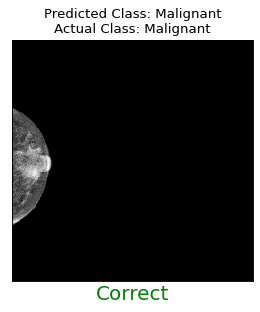

Truth: Malignant
Predict: Malignant


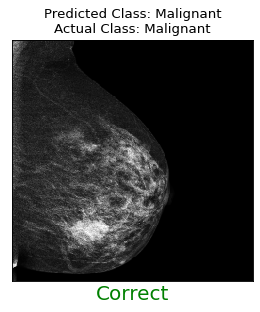

Truth: Malignant
Predict: Malignant


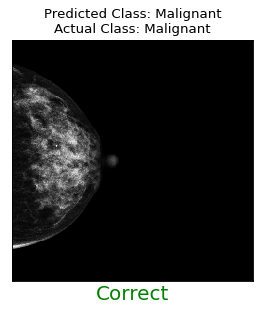

Truth: Malignant
Predict: Malignant


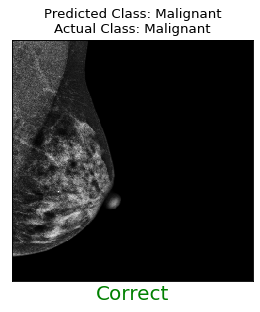

Truth: Malignant
Predict: Malignant


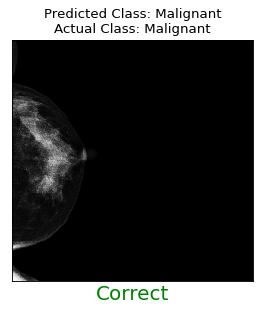

Truth: Malignant
Predict: Benign


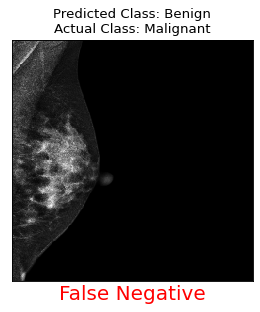

Truth: Malignant
Predict: Malignant


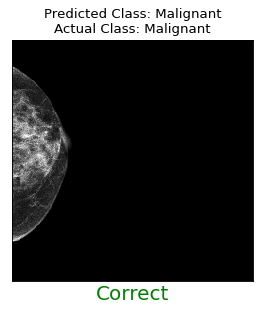

Truth: Malignant
Predict: Malignant


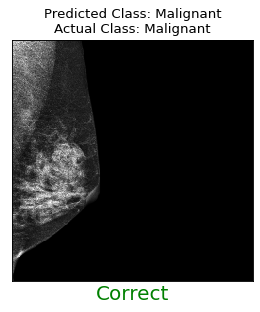

Truth: Malignant
Predict: Malignant


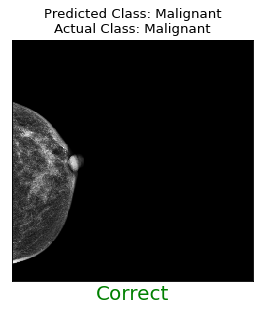

Truth: Malignant
Predict: Malignant


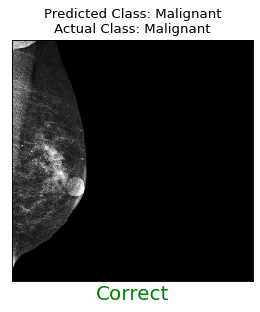

Truth: Malignant
Predict: Malignant


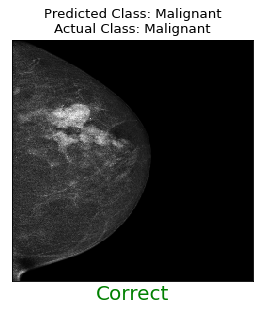

Truth: Malignant
Predict: Malignant


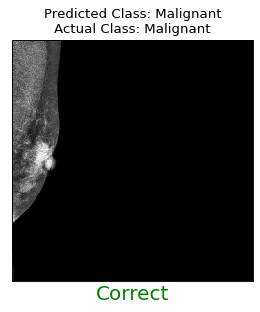

Truth: Malignant
Predict: Malignant


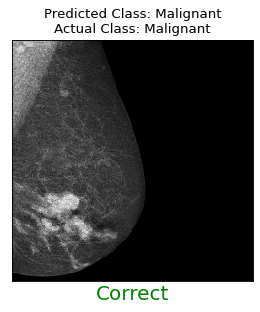

Truth: Malignant
Predict: Malignant


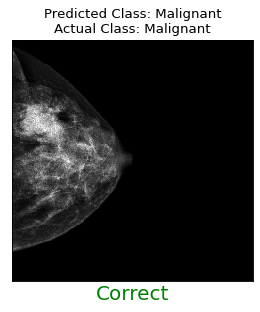

Truth: Malignant
Predict: Malignant


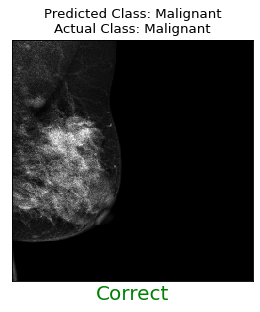

Truth: Malignant
Predict: Malignant


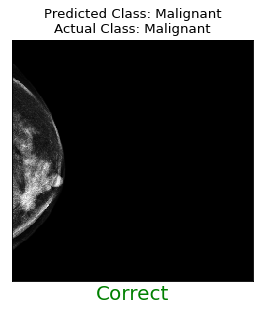

Truth: Malignant
Predict: Malignant


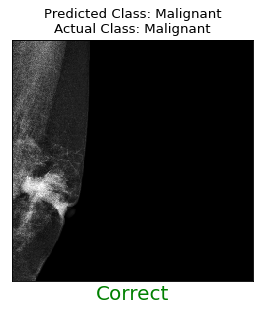

Truth: Malignant
Predict: Malignant


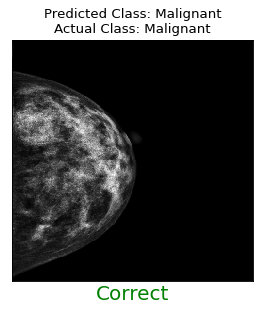

Truth: Malignant
Predict: Malignant


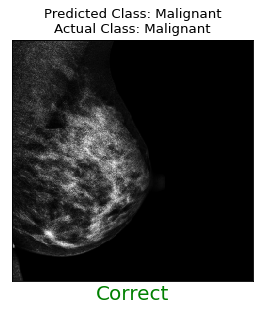

Truth: Malignant
Predict: Malignant


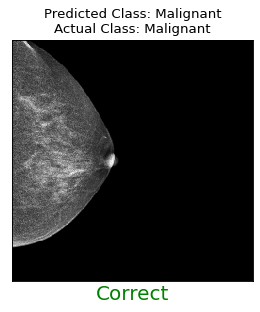

Truth: Malignant
Predict: Malignant


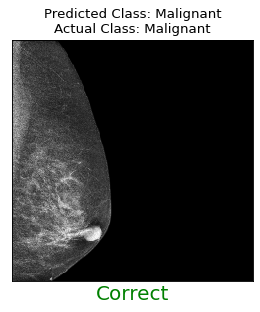

Truth: Malignant
Predict: Malignant


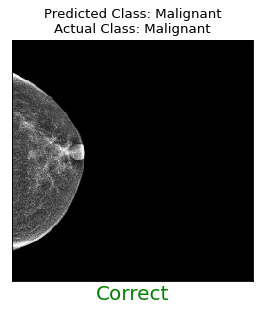

Truth: Malignant
Predict: Malignant


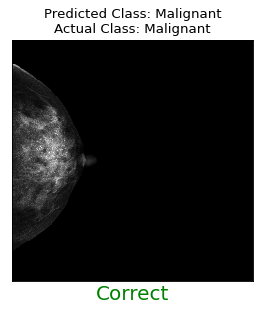

Truth: Malignant
Predict: Malignant


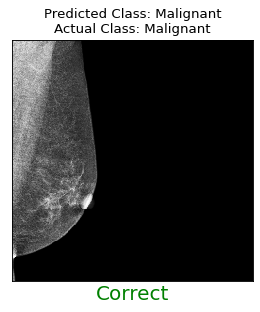

Truth: Malignant
Predict: Malignant


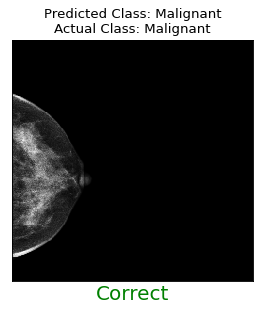

Truth: Malignant
Predict: Malignant


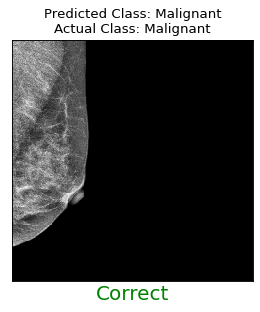

Truth: Malignant
Predict: Malignant


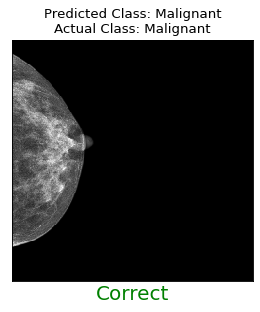

Truth: Malignant
Predict: Malignant


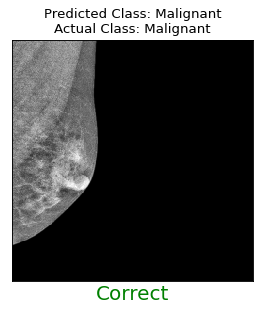

Truth: Malignant
Predict: Malignant


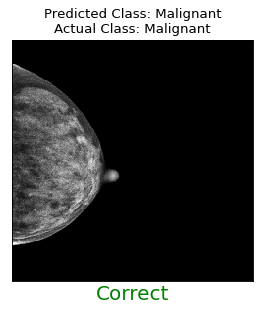

Truth: Malignant
Predict: Malignant


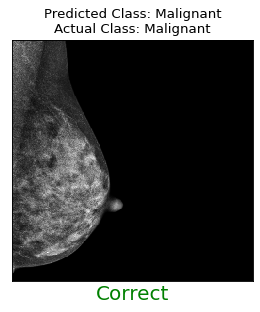

Truth: Malignant
Predict: Malignant


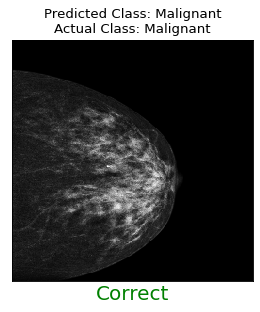

Truth: Malignant
Predict: Malignant


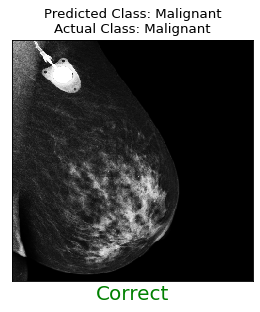

Truth: Malignant
Predict: Malignant


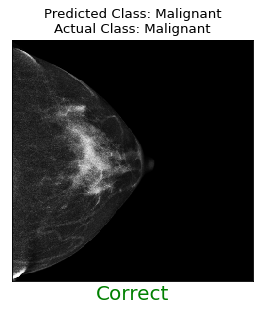

Truth: Malignant
Predict: Malignant


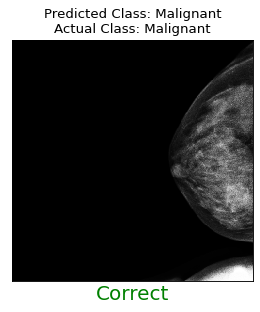

Truth: Malignant
Predict: Malignant


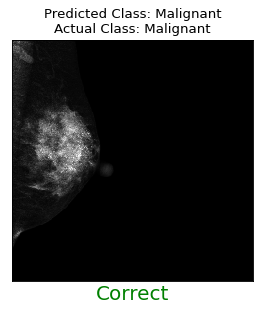

Truth: Malignant
Predict: Malignant


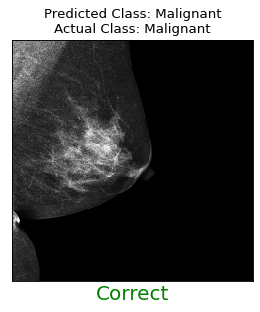

Truth: Malignant
Predict: Malignant


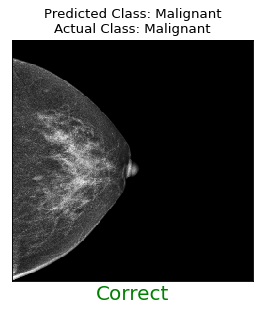

Truth: Malignant
Predict: Malignant


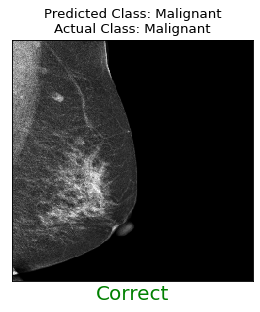

Truth: Malignant
Predict: Malignant


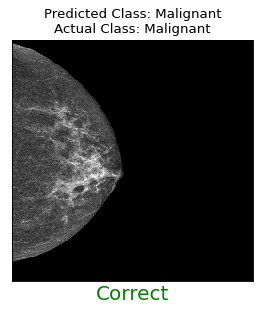

Truth: Malignant
Predict: Malignant


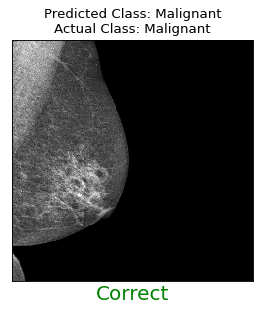

Truth: Malignant
Predict: Malignant


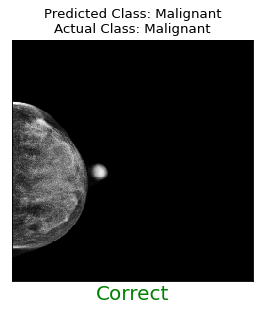

Truth: Malignant
Predict: Benign


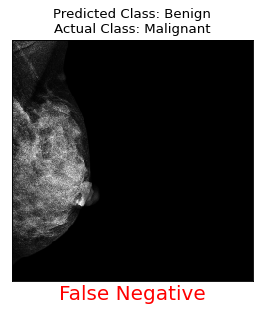

Truth: Malignant
Predict: Malignant


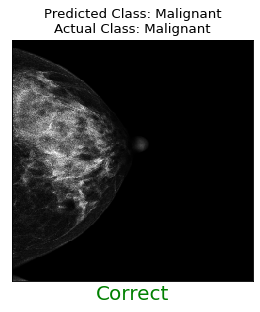

Truth: Malignant
Predict: Malignant


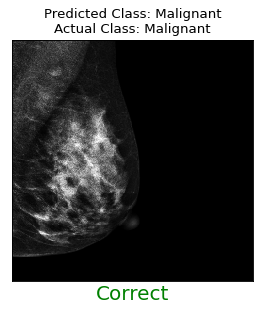

Truth: Malignant
Predict: Malignant


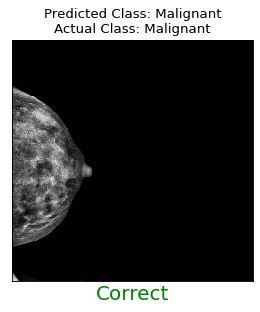

Truth: Malignant
Predict: Malignant


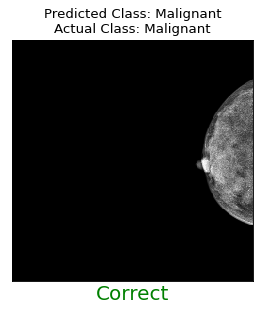

Truth: Malignant
Predict: Malignant


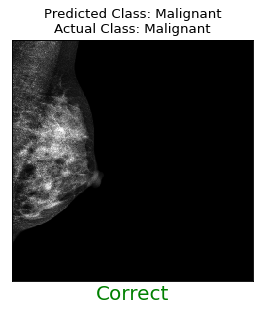

Truth: Malignant
Predict: Malignant


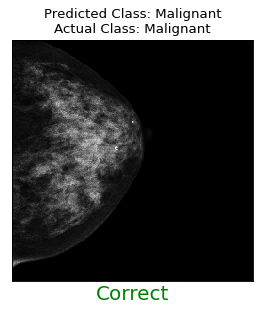

Truth: Malignant
Predict: Malignant


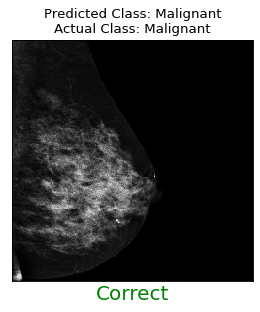

Truth: Malignant
Predict: Malignant


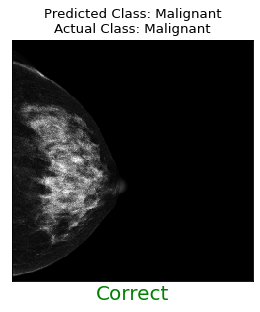

Truth: Malignant
Predict: Malignant


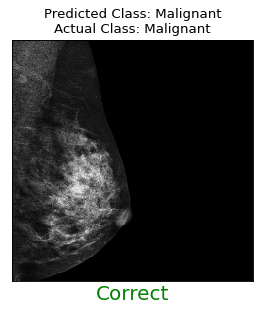

Truth: Malignant
Predict: Malignant


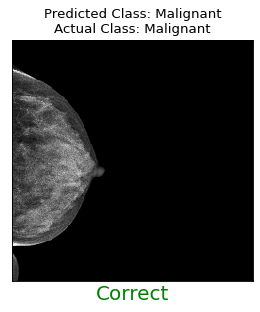

Truth: Malignant
Predict: Malignant


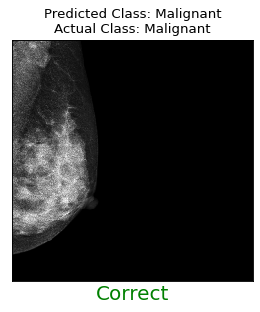

Truth: Malignant
Predict: Malignant


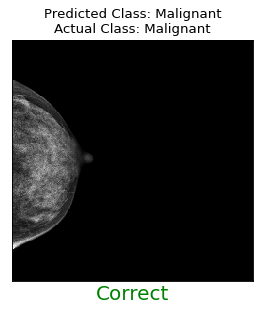

Truth: Malignant
Predict: Malignant


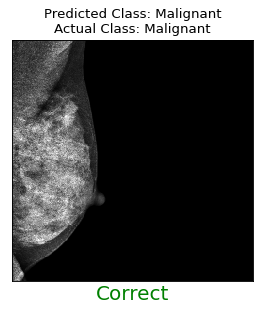

Truth: Malignant
Predict: Malignant


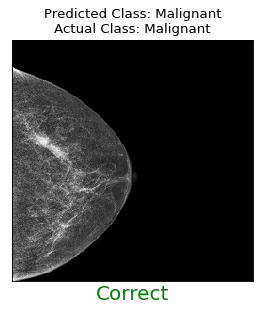

Truth: Malignant
Predict: Benign


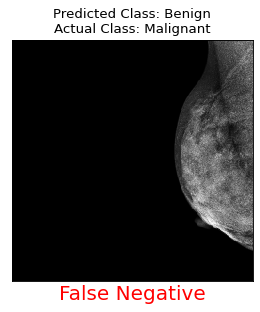

Truth: Malignant
Predict: Malignant


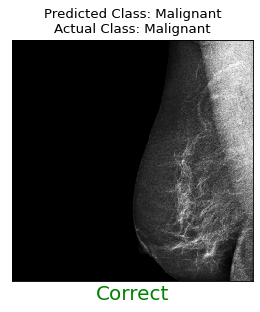

Truth: Malignant
Predict: Malignant


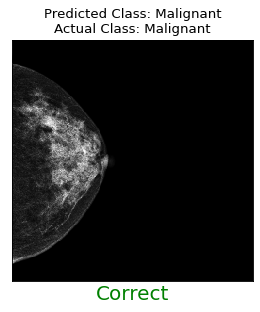

Truth: Malignant
Predict: Malignant


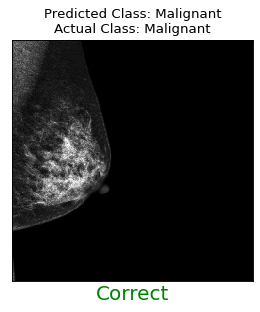

Truth: Malignant
Predict: Malignant


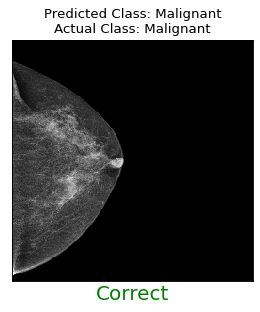

Truth: Malignant
Predict: Malignant


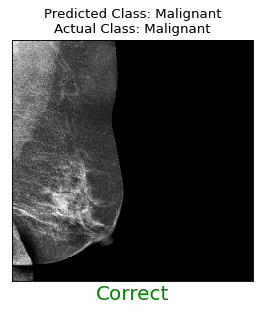

Truth: Malignant
Predict: Malignant


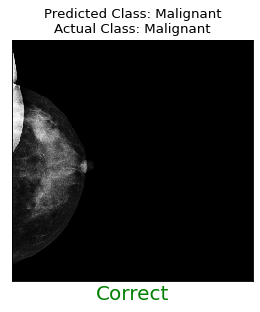

Truth: Malignant
Predict: Malignant


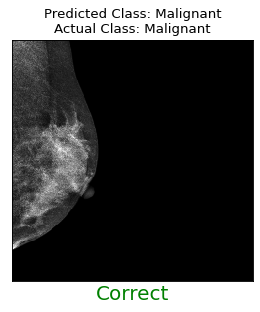

Truth: Malignant
Predict: Benign


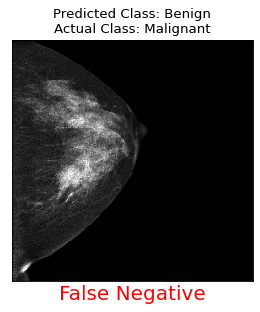

Truth: Malignant
Predict: Benign


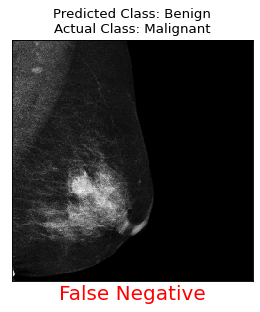

Truth: Malignant
Predict: Malignant


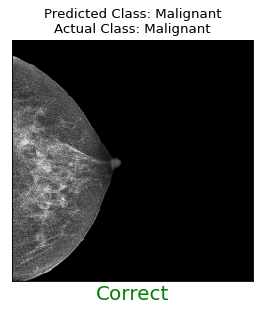

Truth: Malignant
Predict: Malignant


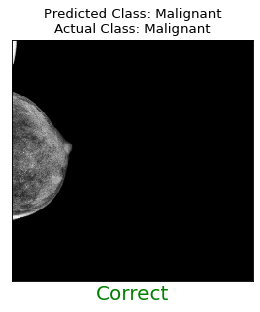

Truth: Malignant
Predict: Malignant


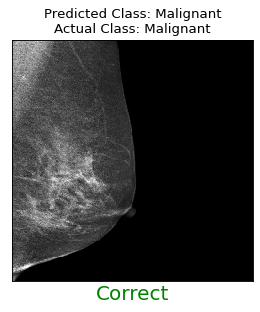

Truth: Malignant
Predict: Malignant


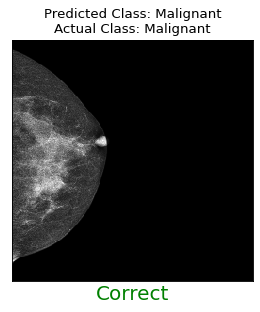

Truth: Malignant
Predict: Malignant


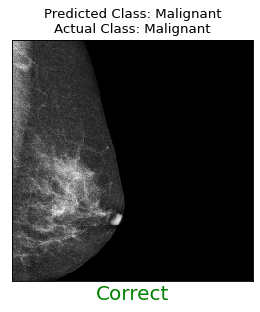

Truth: Malignant
Predict: Malignant


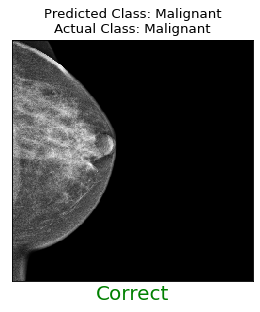

Truth: Malignant
Predict: Malignant


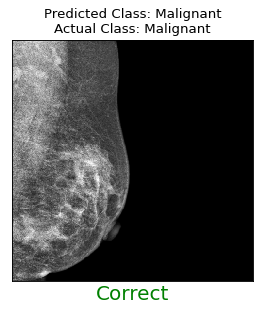

Truth: Malignant
Predict: Malignant


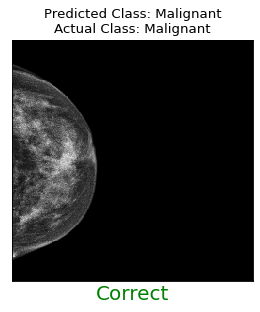

Truth: Malignant
Predict: Malignant


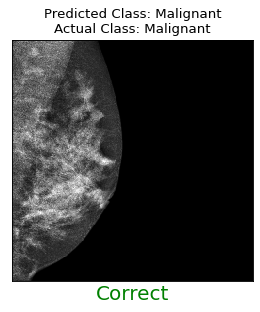

Truth: Malignant
Predict: Malignant


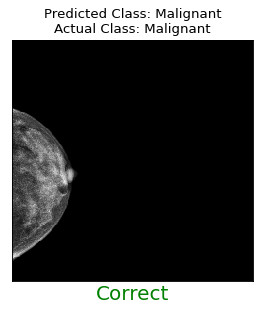

Truth: Malignant
Predict: Malignant


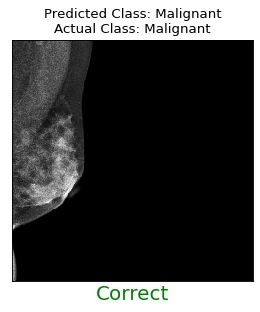

Truth: Malignant
Predict: Malignant


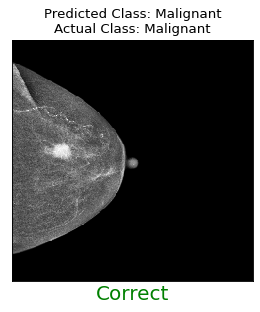

Truth: Malignant
Predict: Malignant


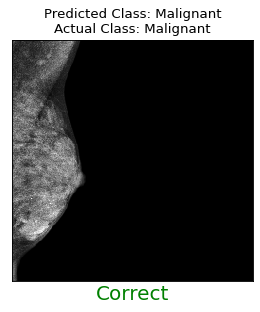

Truth: Malignant
Predict: Malignant


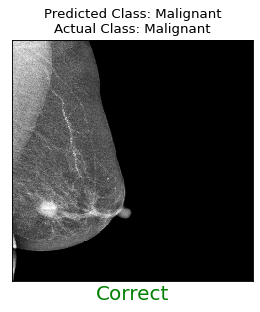

Truth: Malignant
Predict: Malignant


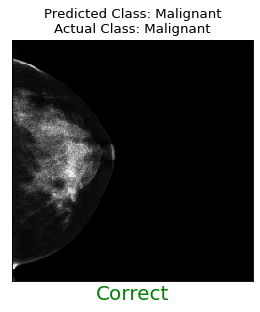

Truth: Malignant
Predict: Malignant


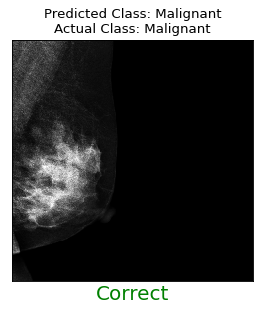

Truth: Malignant
Predict: Malignant


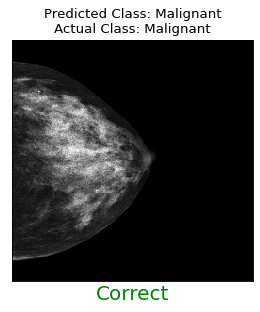

Truth: Malignant
Predict: Malignant


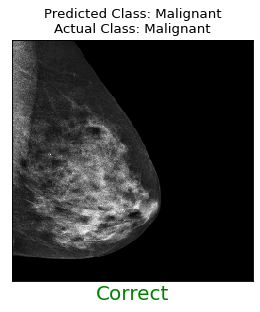

Truth: Malignant
Predict: Malignant


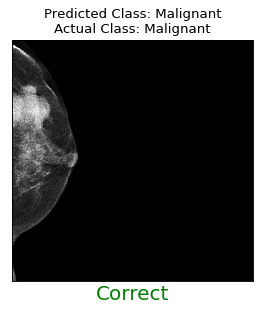

Truth: Malignant
Predict: Malignant


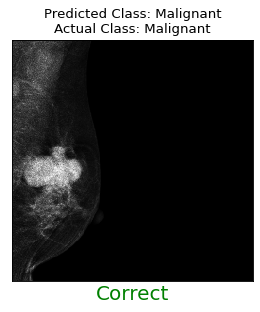

Truth: Malignant
Predict: Malignant


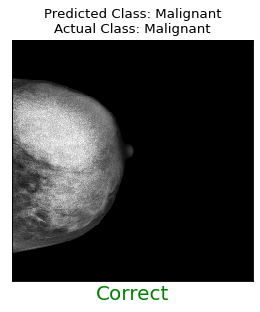

Truth: Malignant
Predict: Malignant


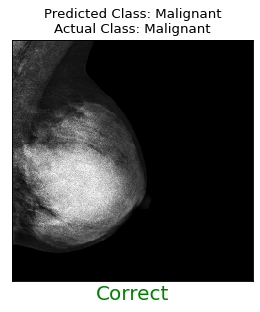

Truth: Malignant
Predict: Malignant


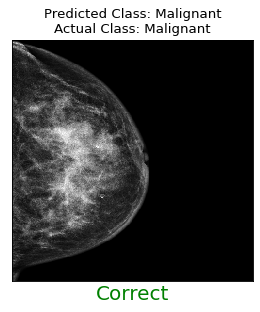

Truth: Malignant
Predict: Malignant


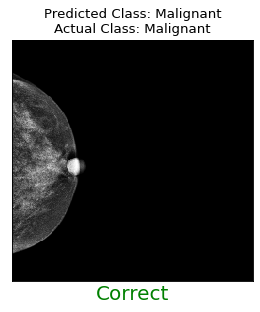

Truth: Malignant
Predict: Malignant


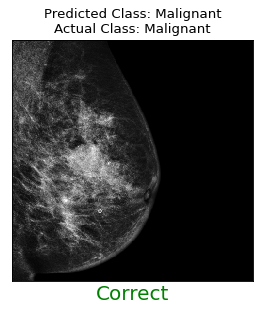

Truth: Malignant
Predict: Malignant


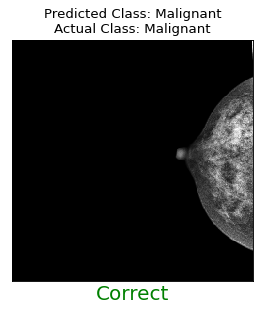

Truth: Malignant
Predict: Malignant


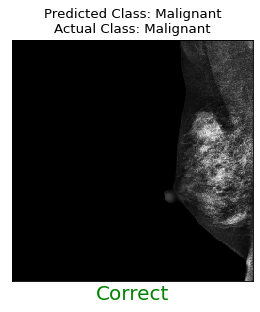

Truth: Malignant
Predict: Malignant


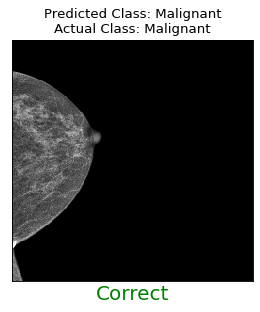

Truth: Malignant
Predict: Malignant


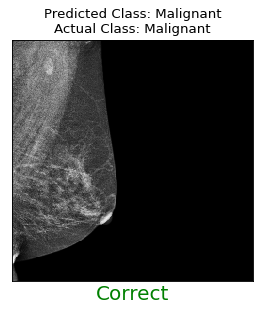

Truth: Malignant
Predict: Malignant


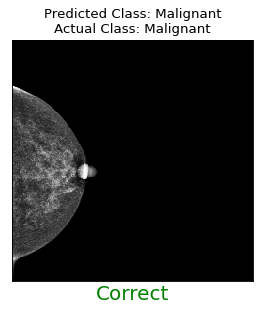

Truth: Malignant
Predict: Malignant


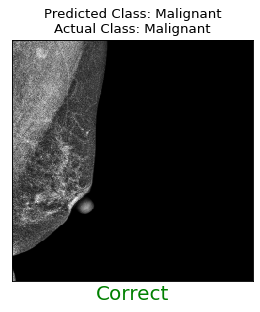

Truth: Malignant
Predict: Malignant


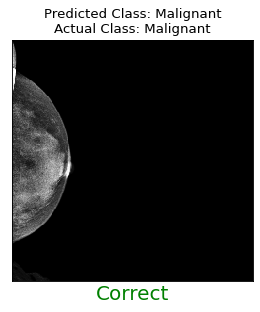

Truth: Malignant
Predict: Malignant


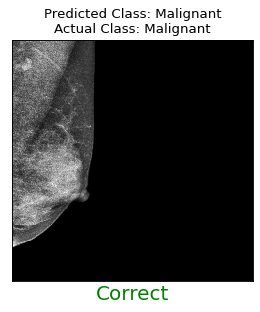

Truth: Malignant
Predict: Malignant


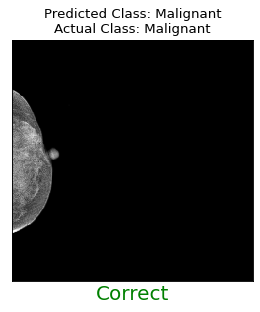

Truth: Malignant
Predict: Malignant


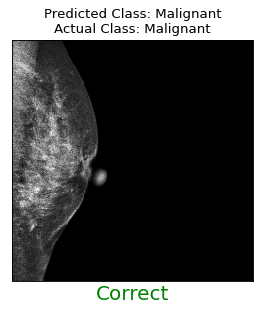

Truth: Malignant
Predict: Malignant


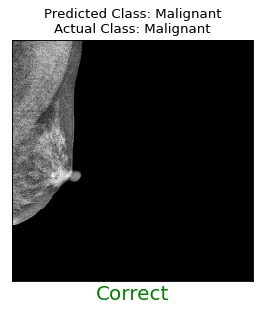

Truth: Malignant
Predict: Malignant


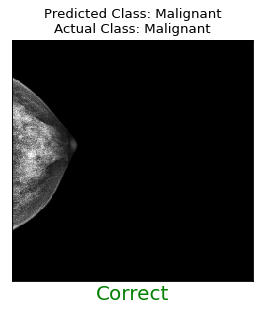

Truth: Malignant
Predict: Malignant


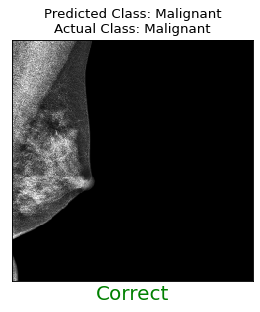

Truth: Malignant
Predict: Malignant


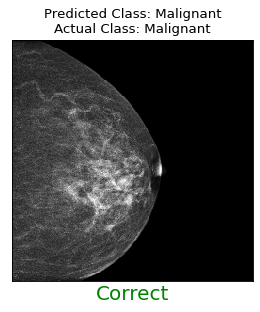

Truth: Malignant
Predict: Malignant


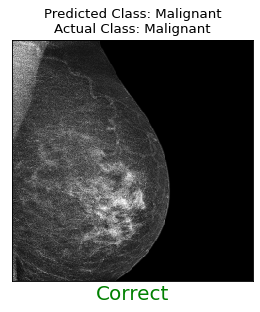

Truth: Malignant
Predict: Malignant


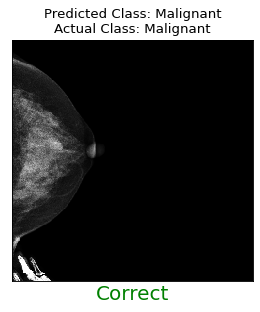

Truth: Malignant
Predict: Malignant


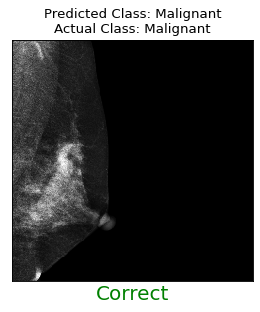

Truth: Malignant
Predict: Malignant


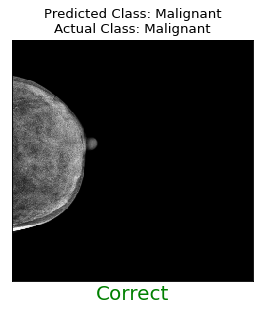

Truth: Malignant
Predict: Malignant


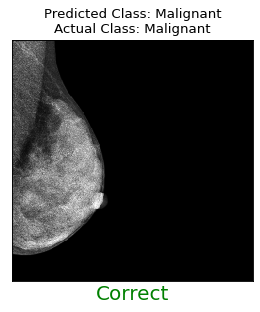

Truth: Malignant
Predict: Malignant


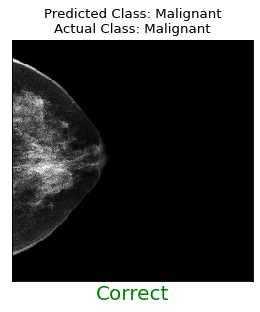

Truth: Malignant
Predict: Malignant


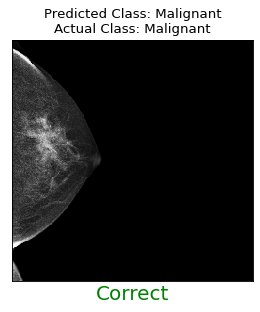

Truth: Malignant
Predict: Malignant


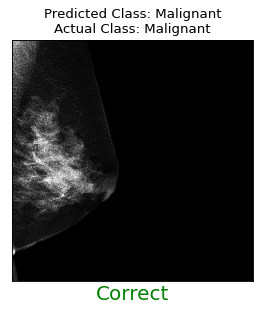

Truth: Malignant
Predict: Malignant


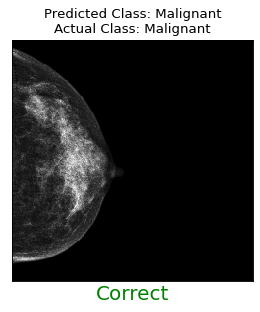

Truth: Malignant
Predict: Malignant


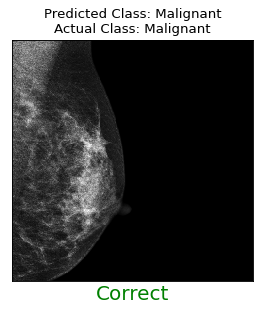

Truth: Malignant
Predict: Malignant


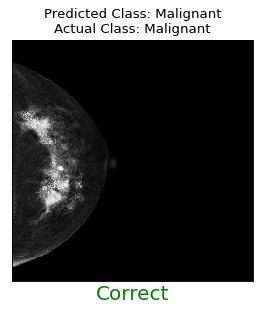

Truth: Malignant
Predict: Malignant


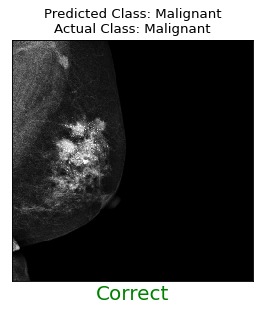

Truth: Malignant
Predict: Malignant


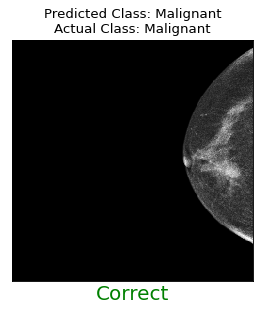

Truth: Malignant
Predict: Malignant


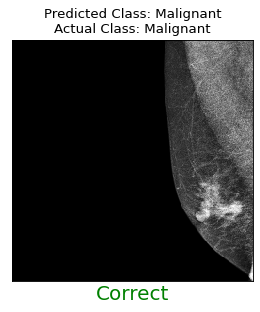

Truth: Malignant
Predict: Malignant


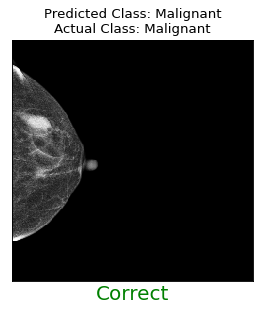

Truth: Malignant
Predict: Malignant


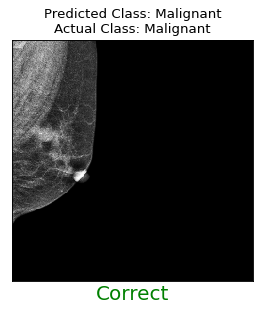

Truth: Malignant
Predict: Malignant


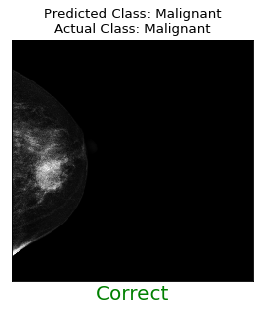

Truth: Malignant
Predict: Malignant


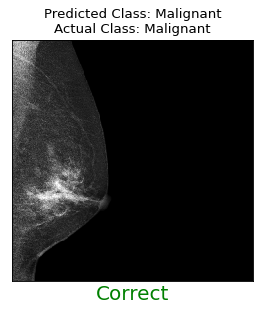

Truth: Malignant
Predict: Malignant


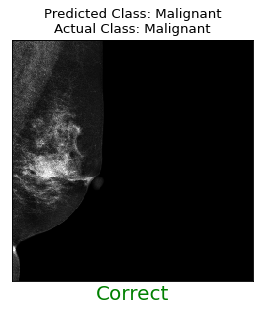

Truth: Malignant
Predict: Malignant


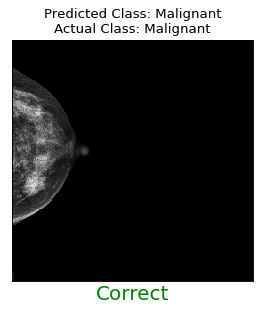

Truth: Malignant
Predict: Malignant


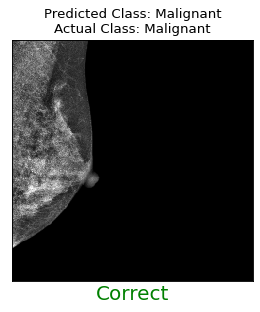

Truth: Malignant
Predict: Malignant


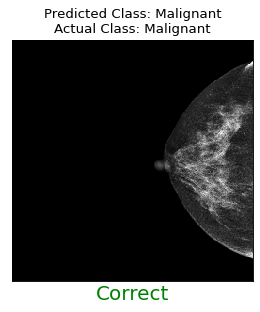

Truth: Malignant
Predict: Malignant


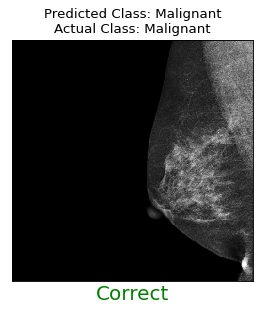

Truth: Malignant
Predict: Malignant


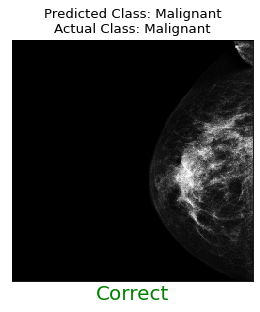

Truth: Malignant
Predict: Malignant


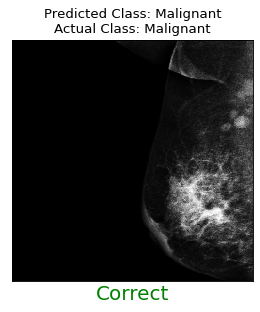

Truth: Malignant
Predict: Malignant


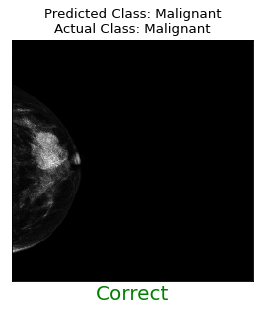

Truth: Malignant
Predict: Malignant


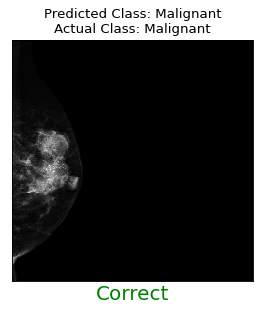

Truth: Malignant
Predict: Malignant


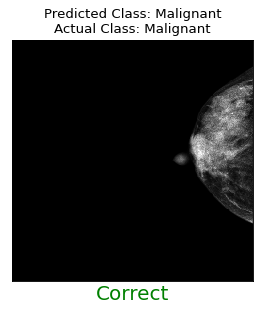

Truth: Malignant
Predict: Malignant


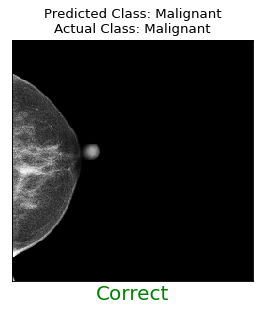

Truth: Malignant
Predict: Malignant


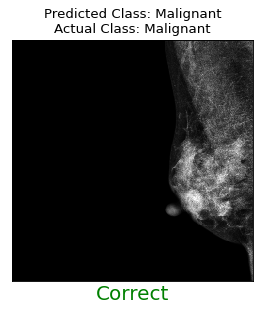

Truth: Malignant
Predict: Malignant


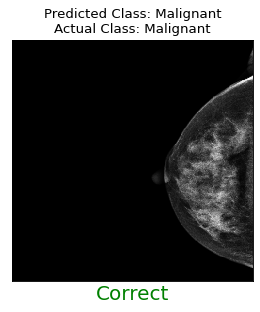

Truth: Malignant
Predict: Malignant


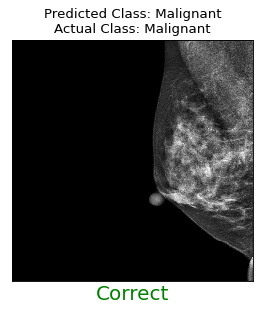

Truth: Malignant
Predict: Malignant


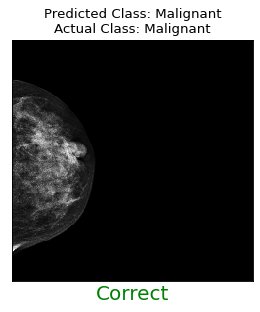

Truth: Malignant
Predict: Malignant


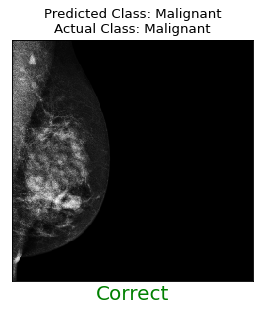

Truth: Malignant
Predict: Benign


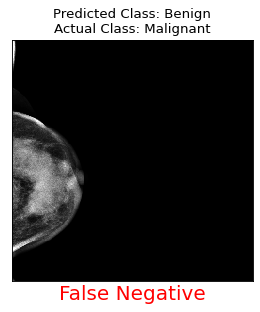

Truth: Malignant
Predict: Malignant


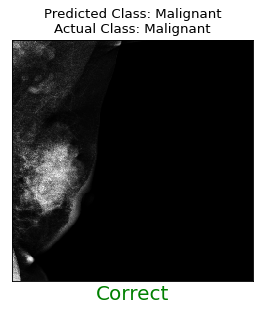

Truth: Malignant
Predict: Malignant


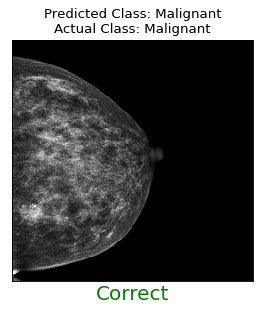

Truth: Malignant
Predict: Malignant


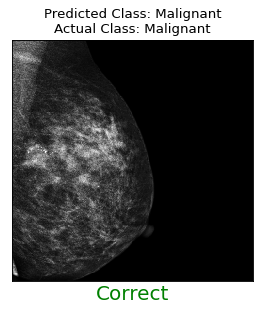

Truth: Malignant
Predict: Malignant


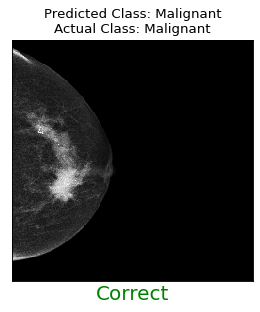

Truth: Malignant
Predict: Malignant


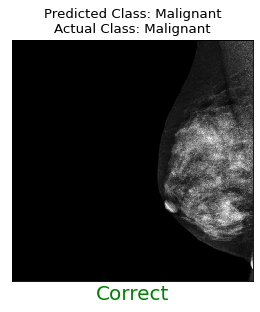

Truth: Malignant
Predict: Malignant


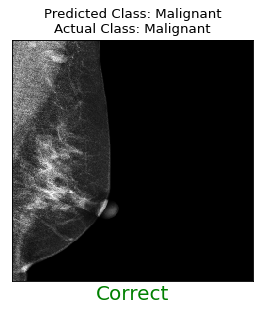

Truth: Malignant
Predict: Malignant


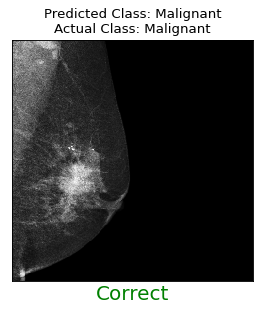

Truth: Malignant
Predict: Malignant


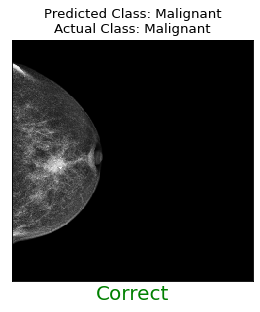

Truth: Malignant
Predict: Malignant


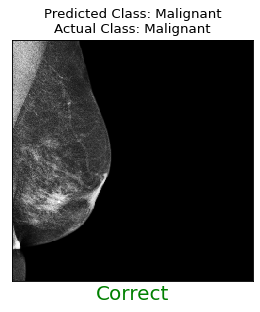

Truth: Malignant
Predict: Malignant


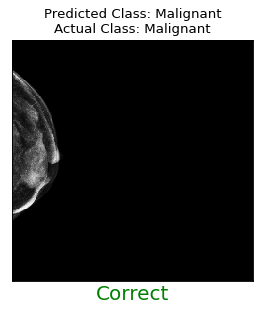

Truth: Malignant
Predict: Malignant


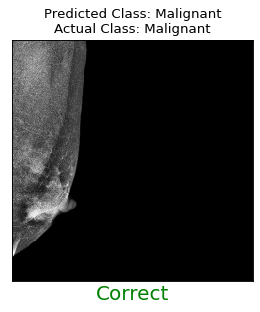

Truth: Malignant
Predict: Malignant


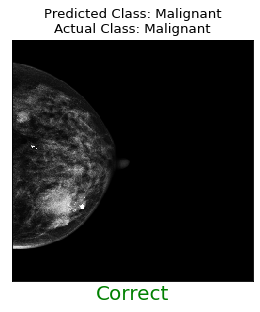

Truth: Malignant
Predict: Malignant


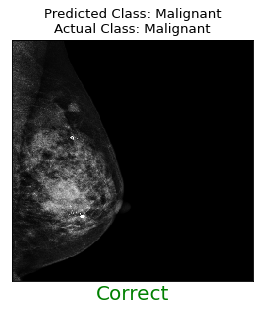

Truth: Malignant
Predict: Malignant


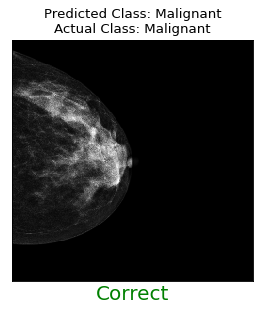

Truth: Malignant
Predict: Malignant


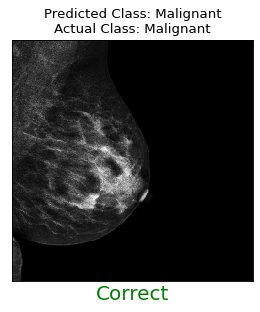

Truth: Malignant
Predict: Malignant


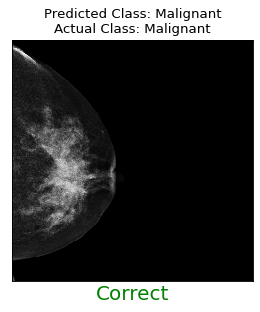

Truth: Malignant
Predict: Malignant


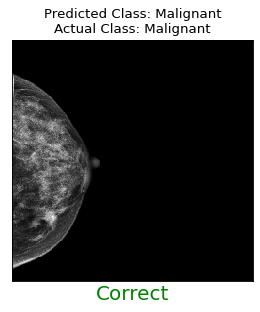

Truth: Malignant
Predict: Malignant


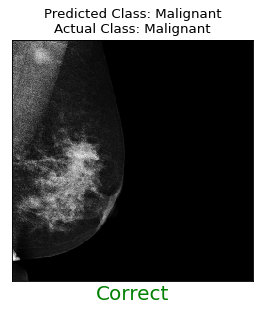

Truth: Malignant
Predict: Malignant


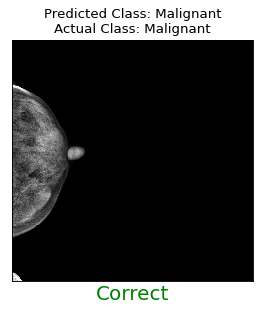

Truth: Malignant
Predict: Malignant


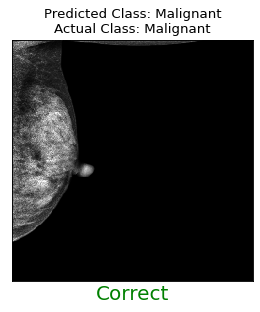

Truth: Malignant
Predict: Malignant


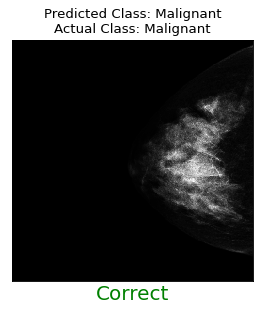

Truth: Malignant
Predict: Malignant


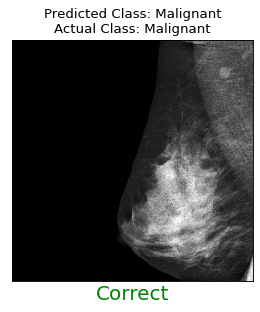

Truth: Malignant
Predict: Malignant


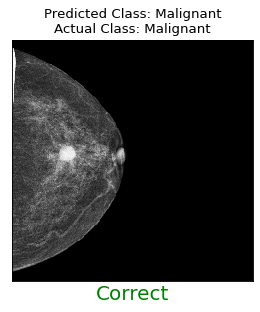

Truth: Malignant
Predict: Malignant


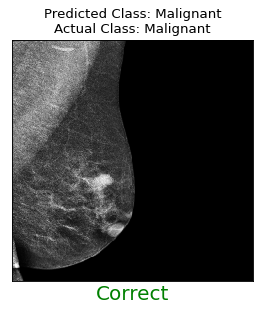

Truth: Malignant
Predict: Malignant


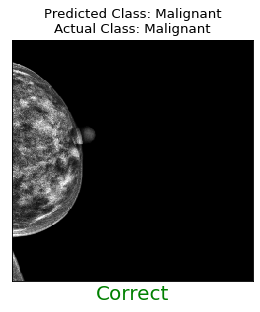

Truth: Malignant
Predict: Malignant


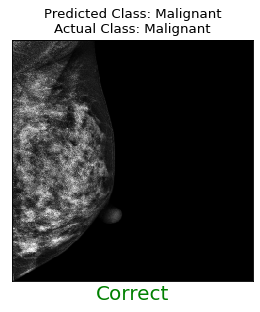

Truth: Malignant
Predict: Malignant


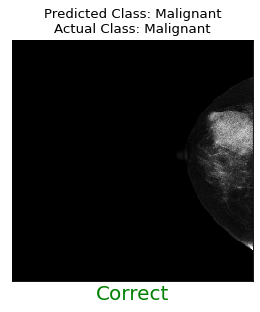

Truth: Malignant
Predict: Malignant


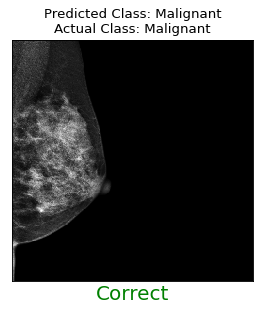

Truth: Malignant
Predict: Malignant


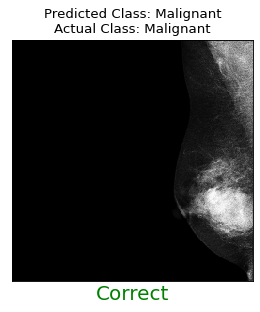

Truth: Malignant
Predict: Malignant


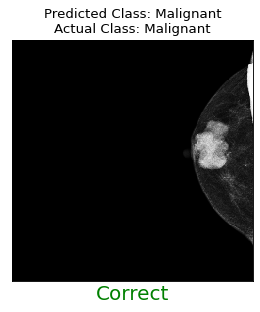

Truth: Malignant
Predict: Malignant


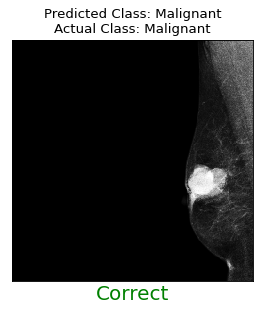

Truth: Malignant
Predict: Malignant


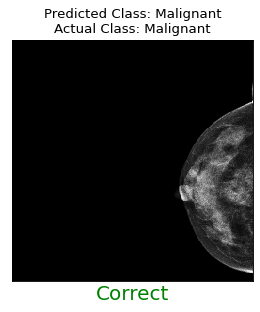

Truth: Malignant
Predict: Malignant


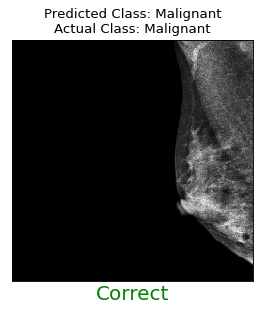

Truth: Malignant
Predict: Malignant


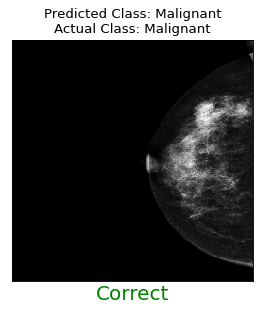

Truth: Malignant
Predict: Malignant


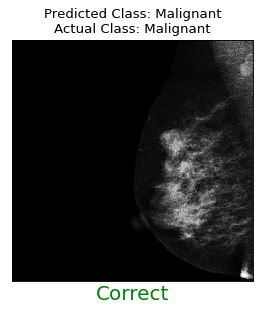

Truth: Malignant
Predict: Malignant


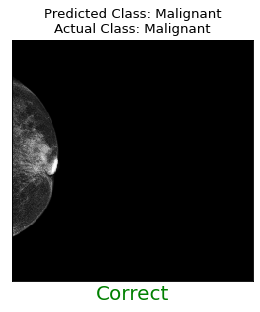

Truth: Malignant
Predict: Malignant


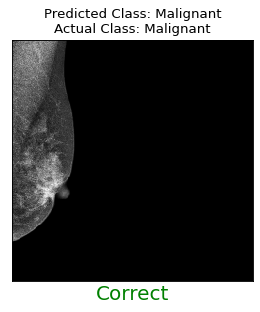

Truth: Malignant
Predict: Malignant


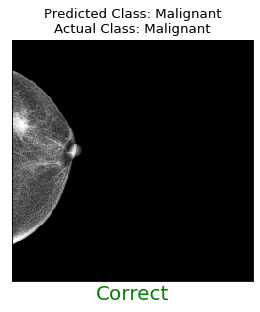

Truth: Malignant
Predict: Malignant


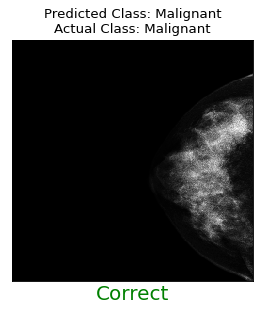

Truth: Malignant
Predict: Malignant


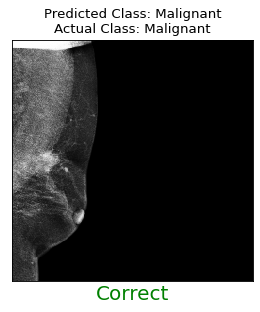

Truth: Malignant
Predict: Malignant


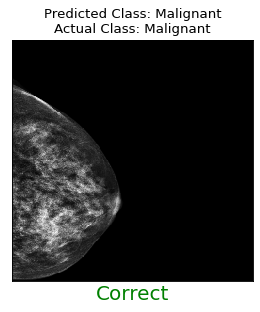

Truth: Malignant
Predict: Malignant


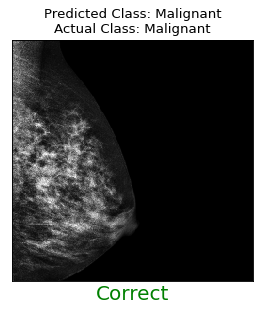

Truth: Malignant
Predict: Malignant


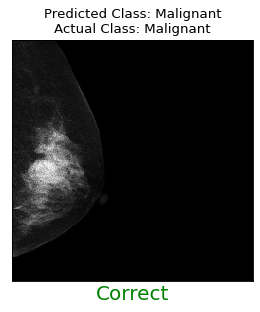

Truth: Malignant
Predict: Malignant


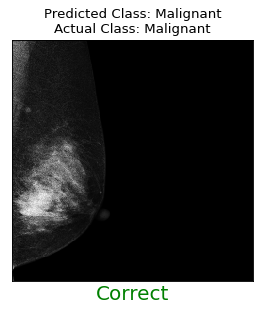

Truth: Malignant
Predict: Malignant


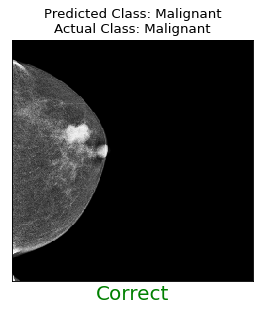

Truth: Malignant
Predict: Malignant


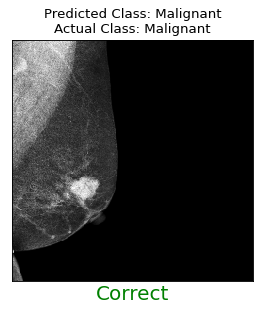

Truth: Malignant
Predict: Malignant


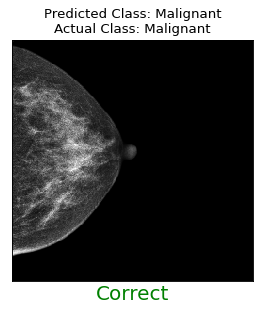

Truth: Malignant
Predict: Malignant


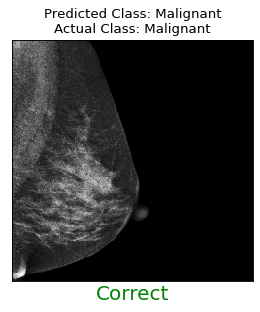

Truth: Malignant
Predict: Malignant


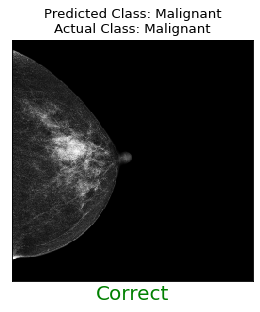

Truth: Malignant
Predict: Malignant


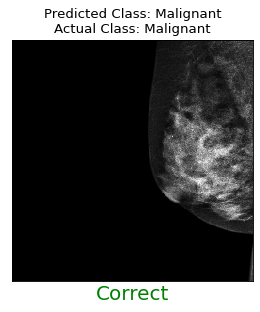

Truth: Malignant
Predict: Malignant


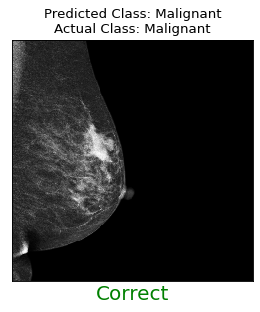

Truth: Malignant
Predict: Malignant


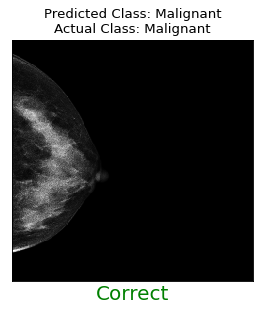

Truth: Malignant
Predict: Malignant


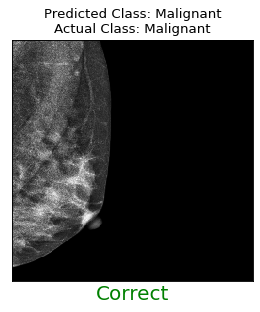

Truth: Malignant
Predict: Malignant


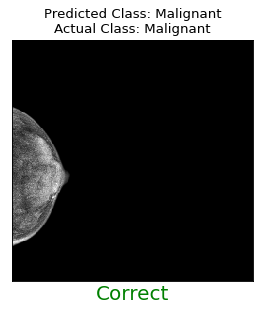

Truth: Malignant
Predict: Malignant


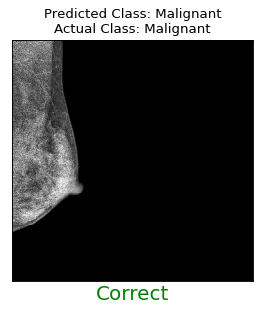

Truth: Malignant
Predict: Malignant


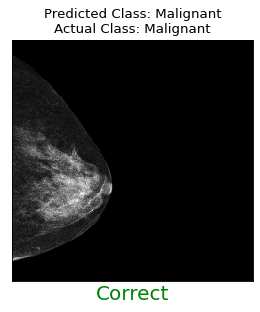

Truth: Malignant
Predict: Malignant


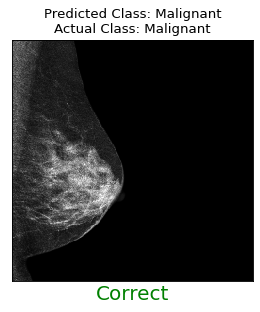

Truth: Malignant
Predict: Malignant


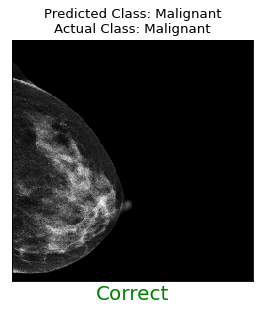

Truth: Malignant
Predict: Malignant


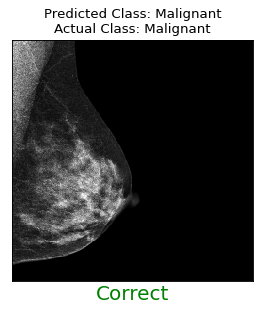

Truth: Malignant
Predict: Malignant


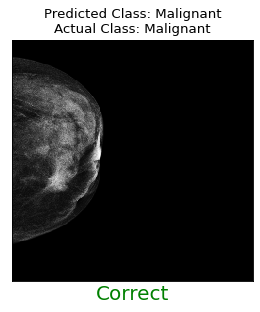

Truth: Malignant
Predict: Malignant


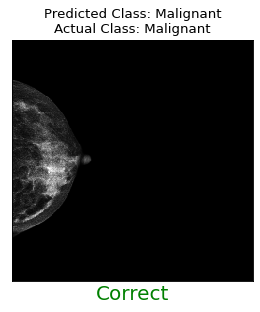

Truth: Malignant
Predict: Benign


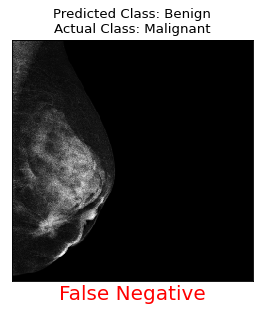

Truth: Malignant
Predict: Benign


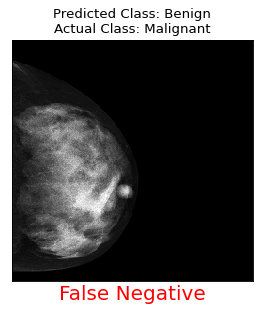

Truth: Malignant
Predict: Malignant


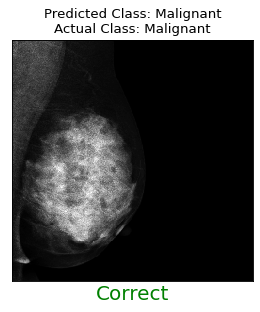

Truth: Malignant
Predict: Malignant


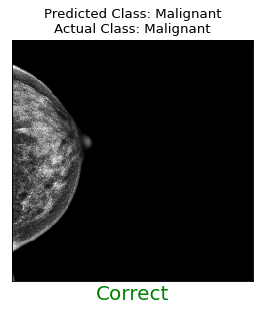

Truth: Malignant
Predict: Malignant


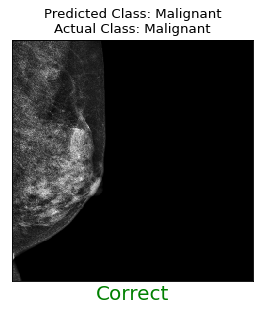

Truth: Malignant
Predict: Malignant


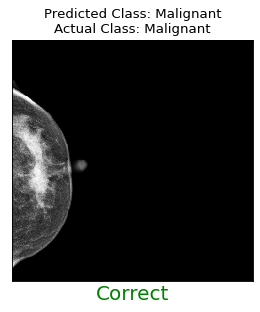

Truth: Malignant
Predict: Malignant


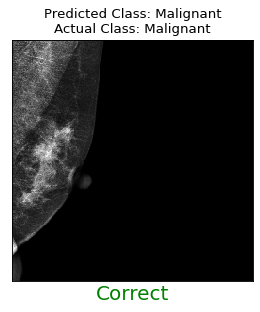

Truth: Malignant
Predict: Malignant


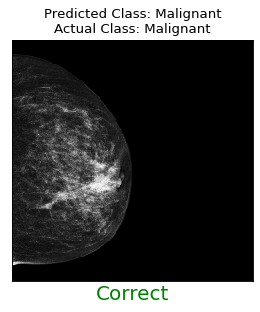

Truth: Malignant
Predict: Malignant


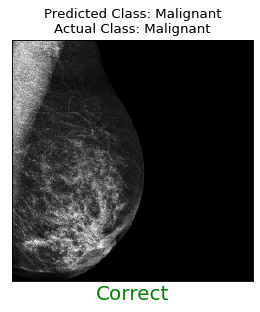

Truth: Malignant
Predict: Malignant


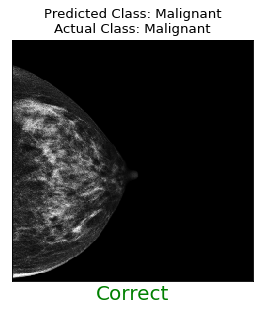

Truth: Malignant
Predict: Malignant


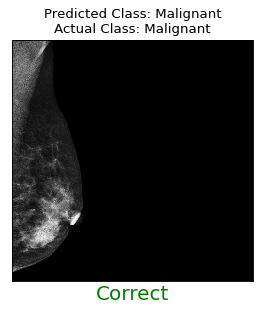

Truth: Malignant
Predict: Malignant


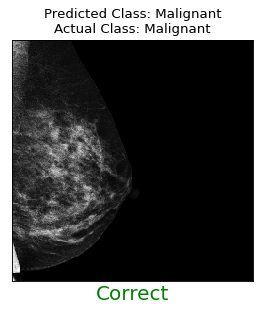

Truth: Malignant
Predict: Malignant


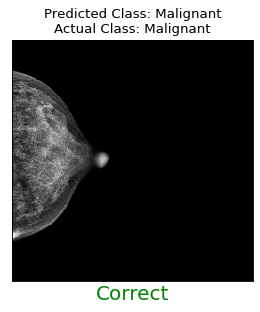

Truth: Malignant
Predict: Malignant


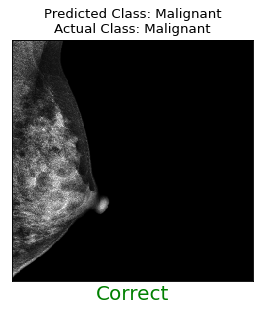

Truth: Malignant
Predict: Malignant


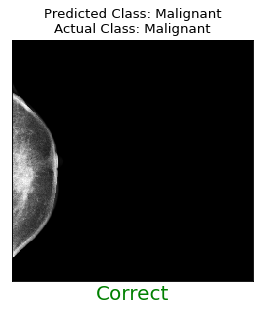

Truth: Malignant
Predict: Malignant


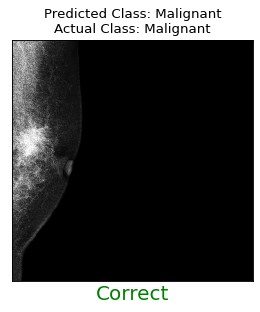

Truth: Malignant
Predict: Malignant


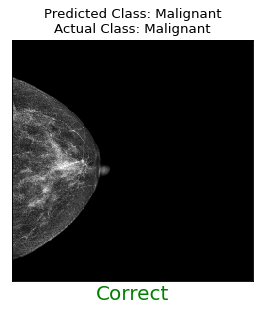

Truth: Malignant
Predict: Malignant


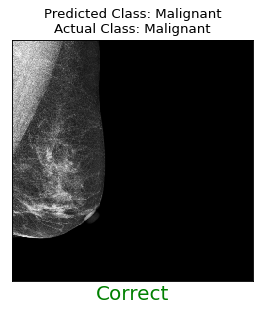

Truth: Malignant
Predict: Malignant


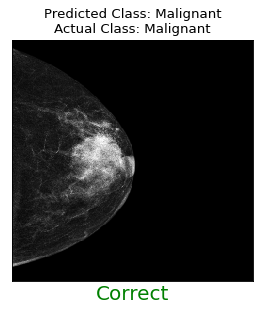

Truth: Malignant
Predict: Malignant


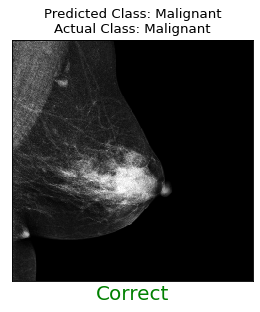

Truth: Malignant
Predict: Malignant


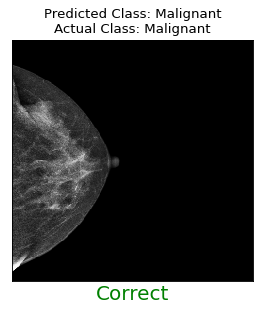

Truth: Malignant
Predict: Malignant


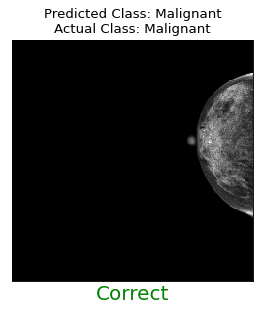

Truth: Malignant
Predict: Malignant


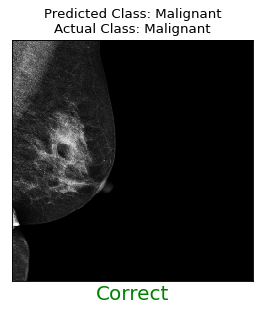

Truth: Malignant
Predict: Malignant


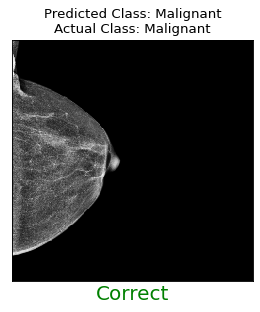

Truth: Malignant
Predict: Malignant


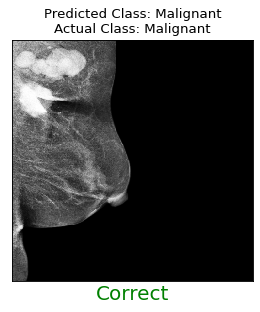

Truth: Malignant
Predict: Malignant


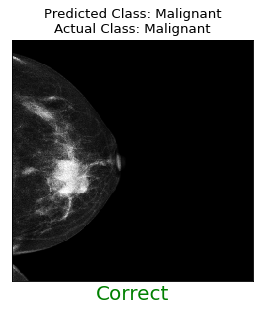

Truth: Malignant
Predict: Malignant


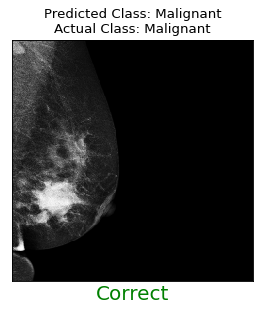

Truth: Malignant
Predict: Malignant


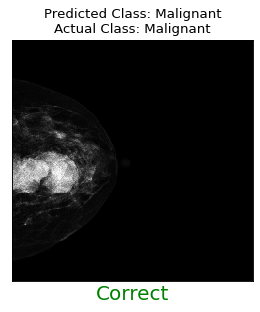

Truth: Malignant
Predict: Malignant


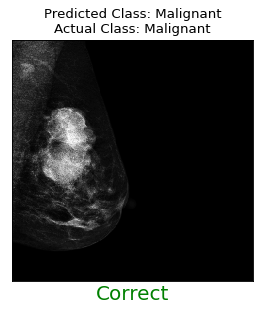

Truth: Malignant
Predict: Malignant


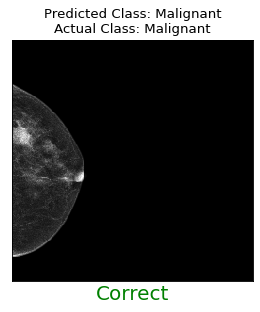

Truth: Malignant
Predict: Malignant


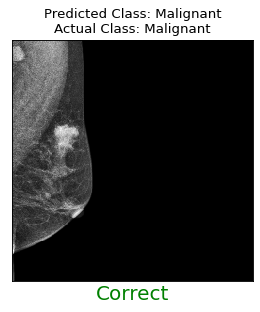

Truth: Malignant
Predict: Malignant


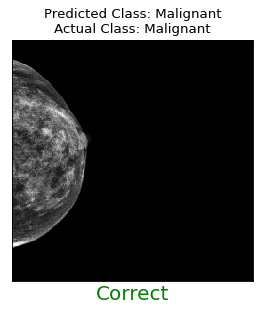

Truth: Malignant
Predict: Malignant


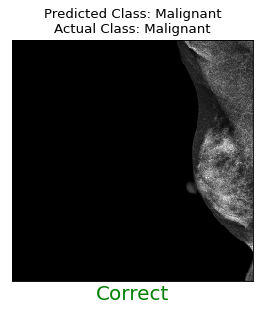

Truth: Malignant
Predict: Malignant


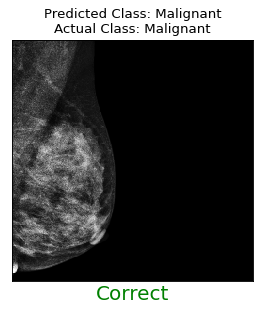

Truth: Malignant
Predict: Malignant


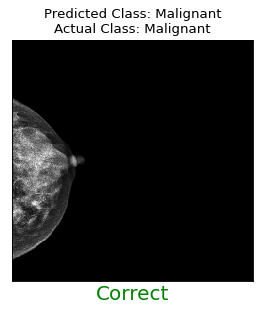

Truth: Malignant
Predict: Malignant


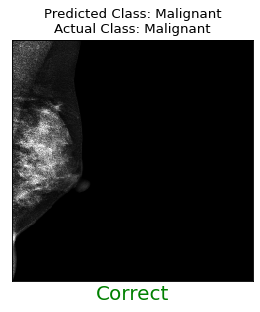

Truth: Malignant
Predict: Malignant


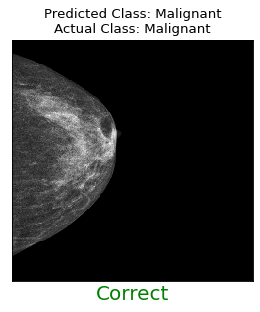

Truth: Malignant
Predict: Malignant


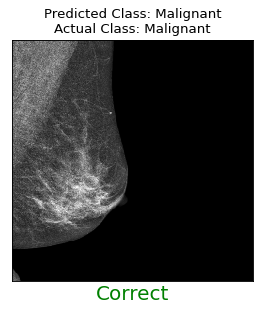

Truth: Malignant
Predict: Malignant


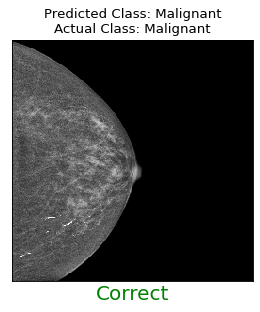

Truth: Malignant
Predict: Malignant


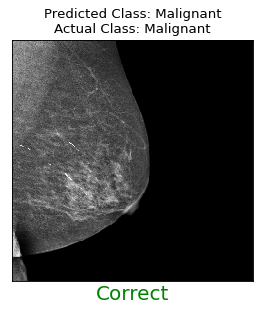

Truth: Malignant
Predict: Malignant


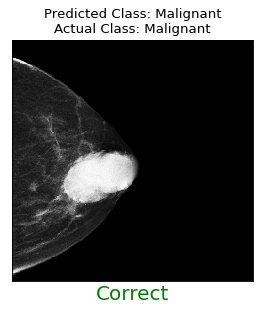

Truth: Malignant
Predict: Malignant


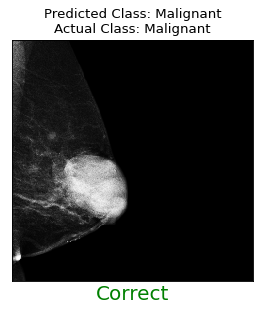

Truth: Malignant
Predict: Malignant


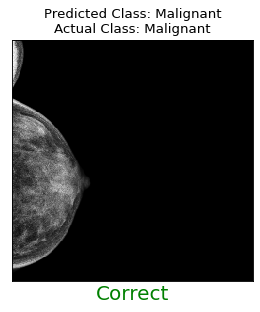

Truth: Malignant
Predict: Malignant


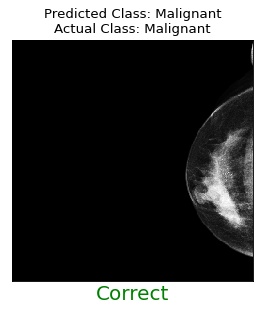

Truth: Malignant
Predict: Malignant


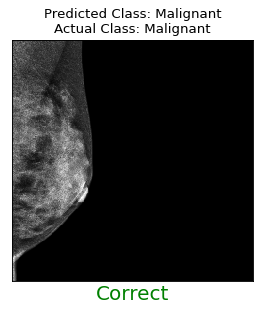

Truth: Malignant
Predict: Malignant


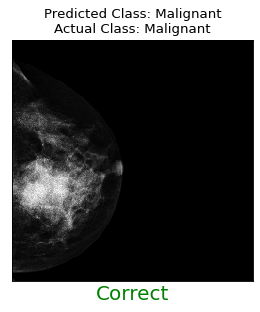

Truth: Malignant
Predict: Malignant


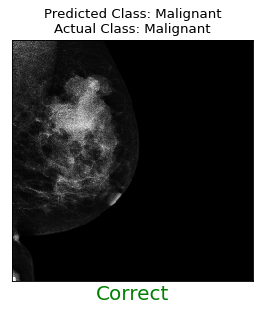

Truth: Malignant
Predict: Malignant


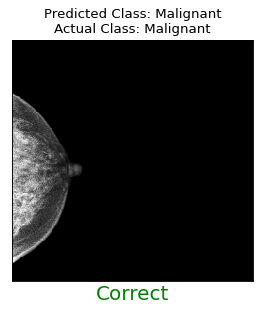

Truth: Malignant
Predict: Malignant


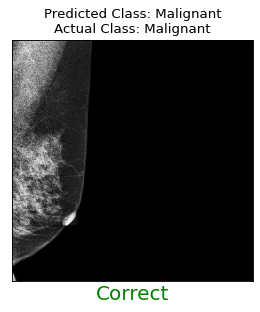

Truth: Malignant
Predict: Malignant


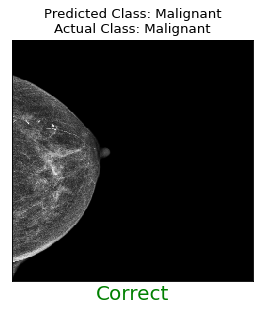

Truth: Malignant
Predict: Malignant


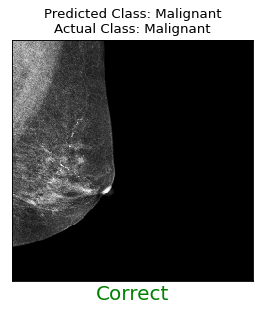

Truth: Malignant
Predict: Malignant


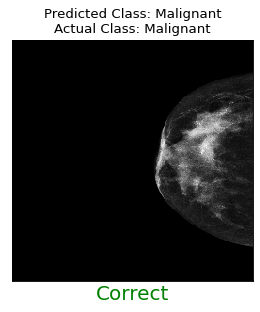

Truth: Malignant
Predict: Malignant


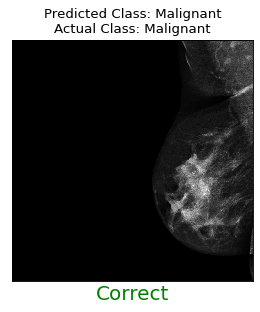

Truth: Malignant
Predict: Malignant


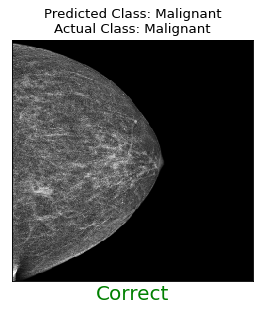

Truth: Malignant
Predict: Malignant


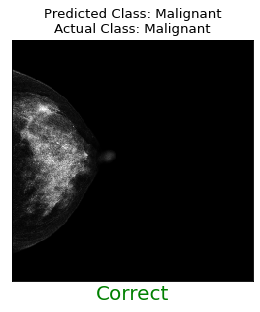

Truth: Malignant
Predict: Malignant


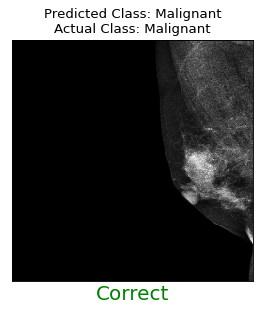

Truth: Malignant
Predict: Malignant


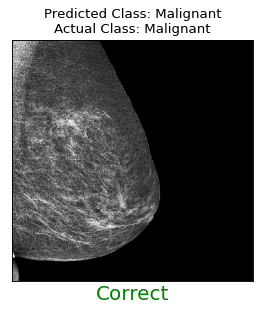

Truth: Malignant
Predict: Malignant


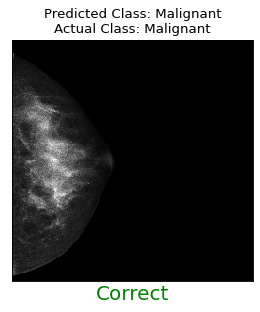

Truth: Malignant
Predict: Malignant


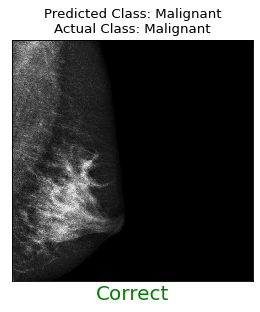

Truth: Malignant
Predict: Malignant


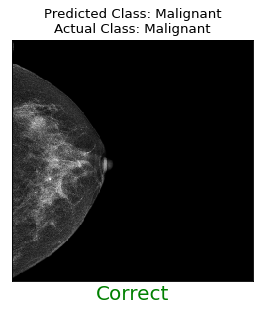

Truth: Malignant
Predict: Malignant


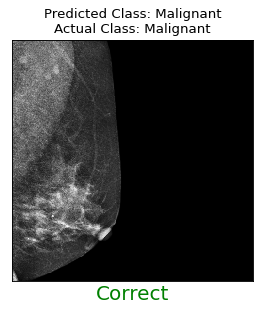

Truth: Malignant
Predict: Malignant


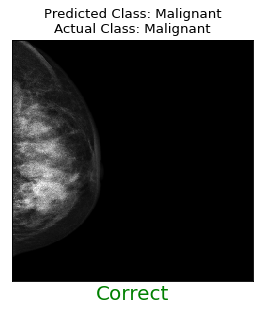

Truth: Malignant
Predict: Malignant


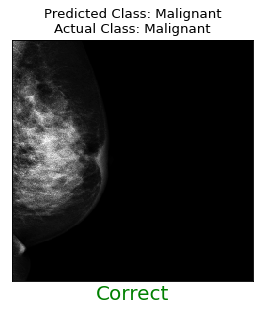

Truth: Malignant
Predict: Malignant


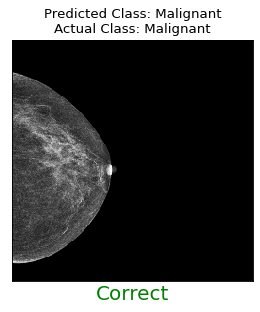

Truth: Malignant
Predict: Malignant


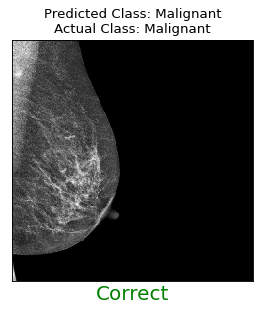

Truth: Malignant
Predict: Malignant


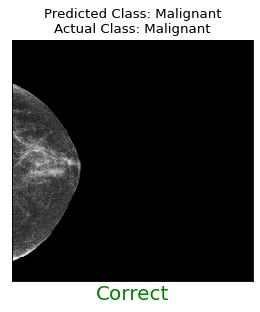

Truth: Malignant
Predict: Malignant


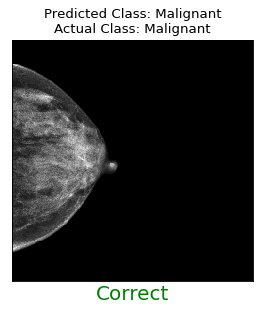

Truth: Malignant
Predict: Malignant


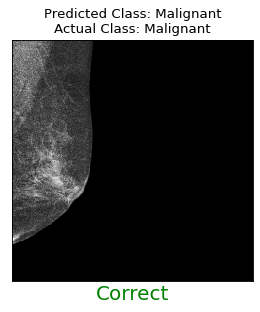

Truth: Malignant
Predict: Malignant


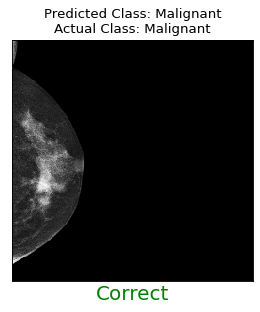

Truth: Malignant
Predict: Malignant


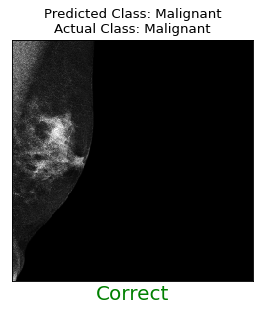

Truth: Malignant
Predict: Malignant


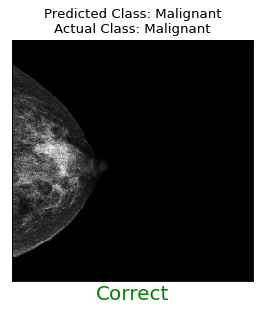

Truth: Malignant
Predict: Malignant


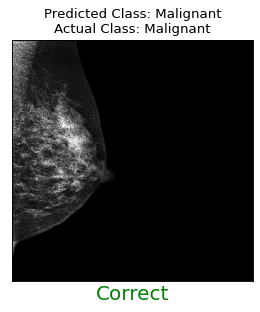

Truth: Malignant
Predict: Malignant


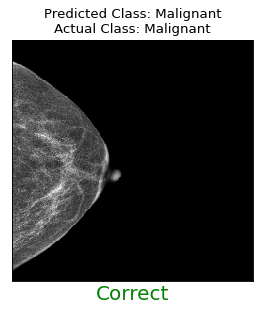

Truth: Malignant
Predict: Malignant


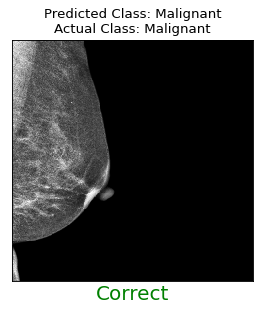

Truth: Malignant
Predict: Malignant


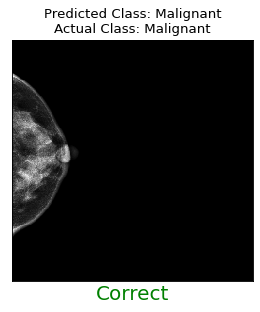

Truth: Malignant
Predict: Malignant


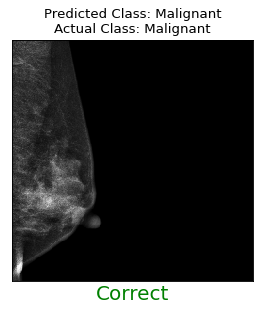

Truth: Malignant
Predict: Malignant


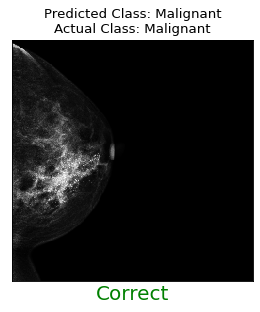

Truth: Malignant
Predict: Malignant


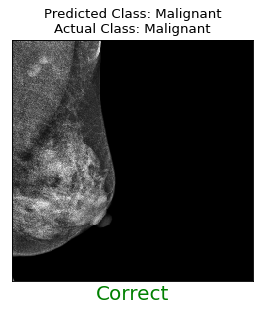

Truth: Malignant
Predict: Malignant


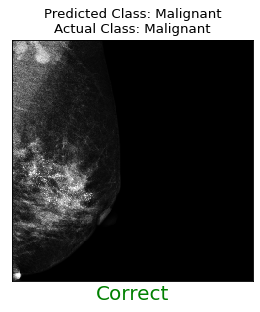

Truth: Malignant
Predict: Malignant


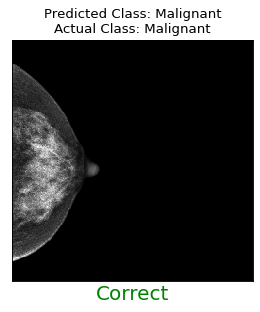

Truth: Malignant
Predict: Malignant


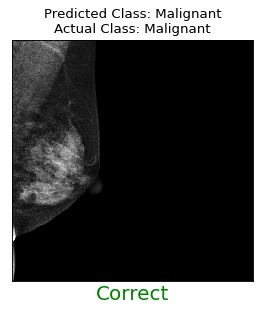

Truth: Malignant
Predict: Malignant


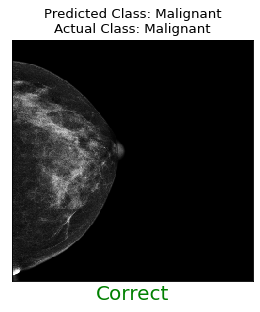

Truth: Malignant
Predict: Malignant


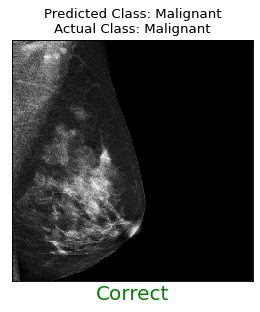

Truth: Malignant
Predict: Malignant


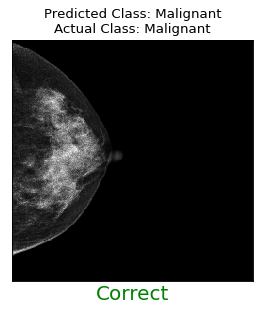

Truth: Malignant
Predict: Malignant


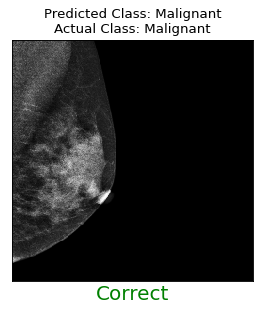

Truth: Malignant
Predict: Malignant


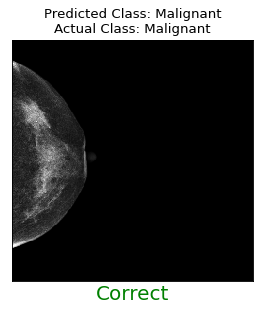

Truth: Malignant
Predict: Malignant


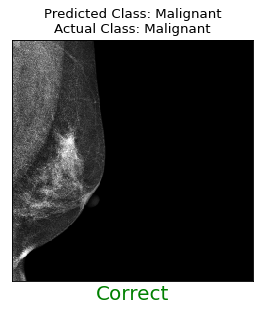

Truth: Malignant
Predict: Malignant


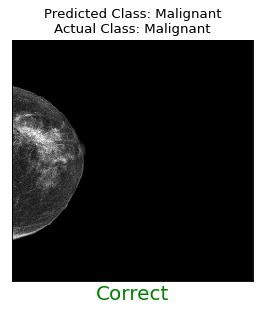

Truth: Malignant
Predict: Malignant


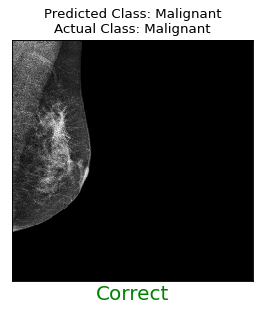

Truth: Malignant
Predict: Malignant


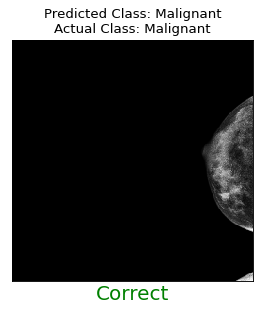

Truth: Malignant
Predict: Malignant


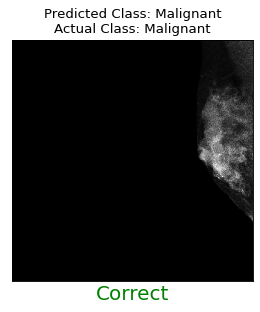

Truth: Malignant
Predict: Malignant


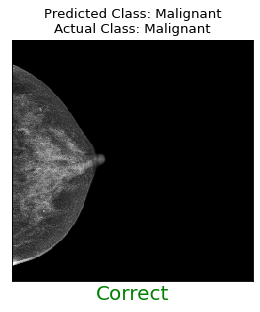

Truth: Malignant
Predict: Malignant


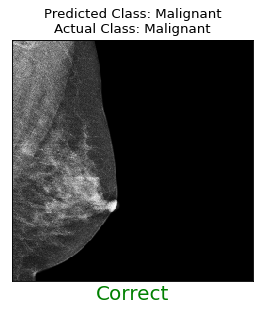

Truth: Malignant
Predict: Malignant


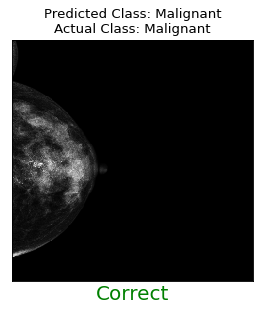

Truth: Malignant
Predict: Malignant


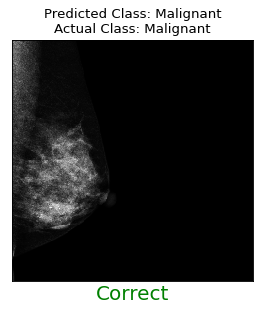

Truth: Malignant
Predict: Malignant


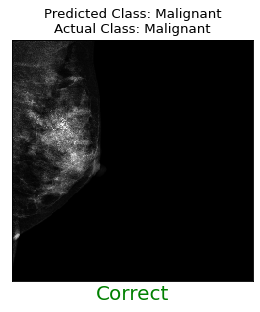

Truth: Malignant
Predict: Malignant


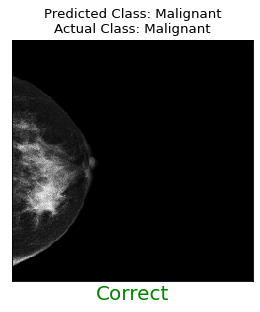

Truth: Malignant
Predict: Malignant


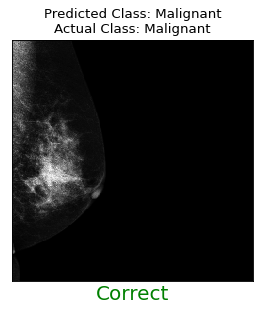

Truth: Malignant
Predict: Malignant


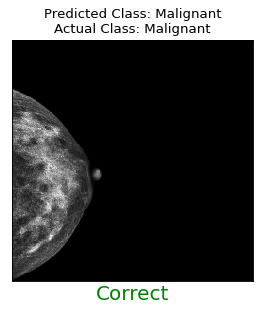

Truth: Malignant
Predict: Malignant


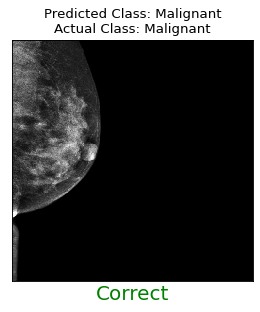

Truth: Malignant
Predict: Malignant


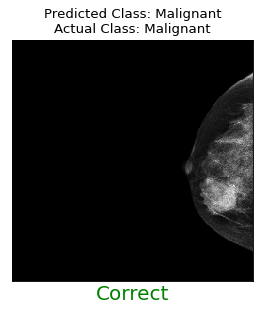

Truth: Malignant
Predict: Malignant


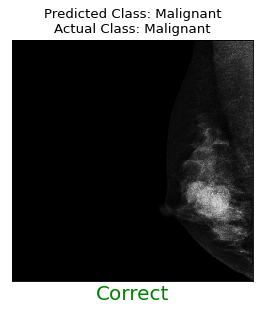

Truth: Malignant
Predict: Malignant


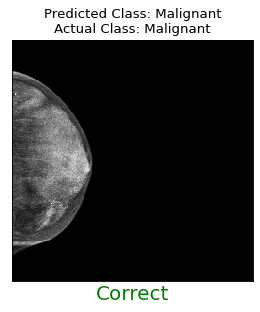

Truth: Malignant
Predict: Malignant


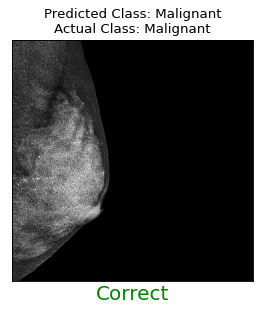

Truth: Malignant
Predict: Malignant


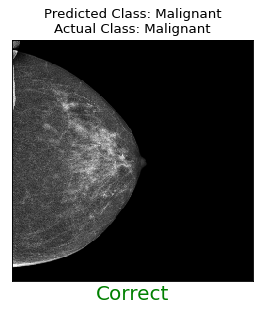

Truth: Malignant
Predict: Malignant


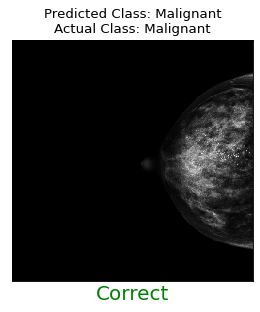

Truth: Malignant
Predict: Malignant


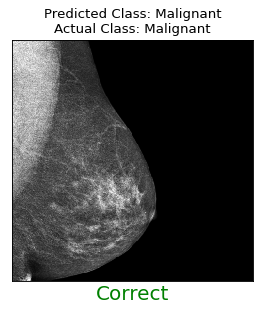

Truth: Malignant
Predict: Malignant


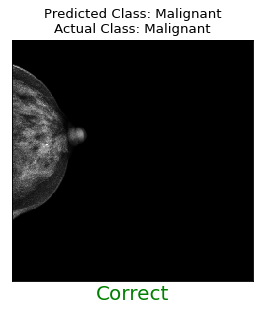

Truth: Malignant
Predict: Malignant


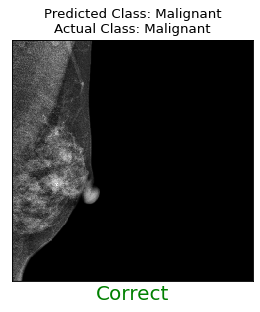

Truth: Malignant
Predict: Malignant


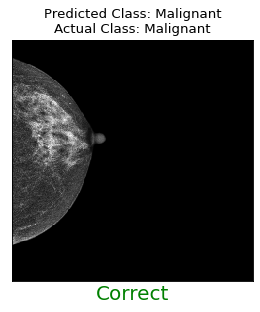

Truth: Malignant
Predict: Malignant


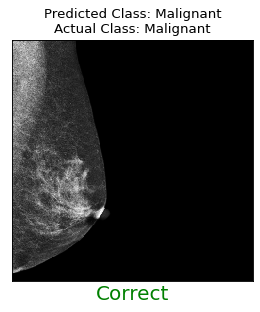

Truth: Malignant
Predict: Malignant


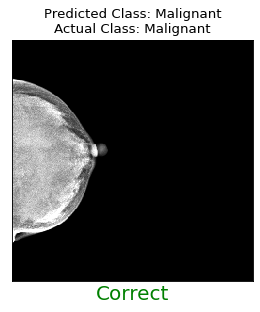

Truth: Malignant
Predict: Malignant


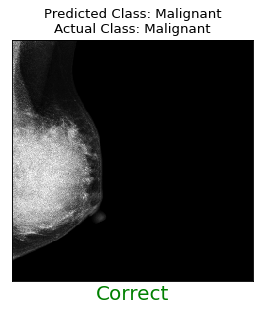

Truth: Malignant
Predict: Malignant


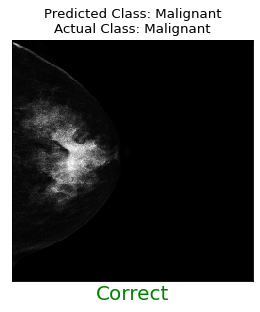

Truth: Malignant
Predict: Malignant


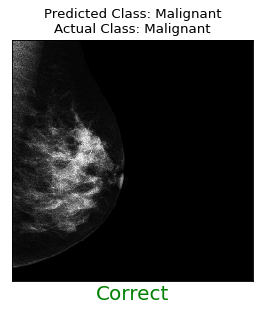

Truth: Malignant
Predict: Malignant


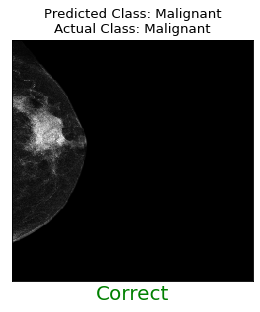

Truth: Malignant
Predict: Malignant


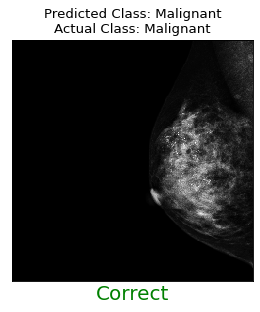

Truth: Malignant
Predict: Malignant


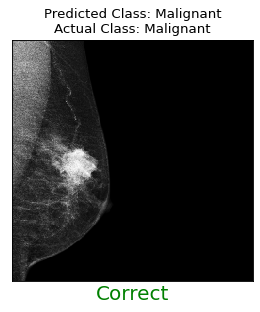

Truth: Malignant
Predict: Malignant


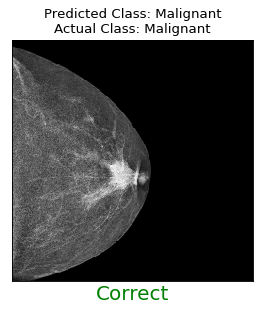

Truth: Malignant
Predict: Malignant


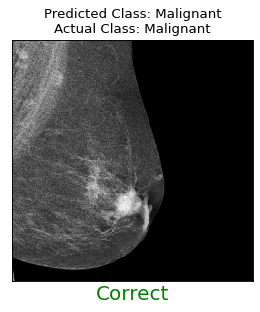

Truth: Malignant
Predict: Malignant


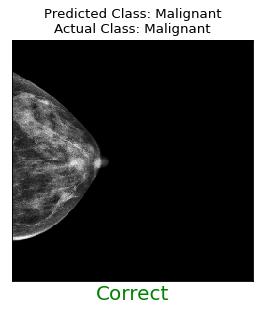

Truth: Malignant
Predict: Malignant


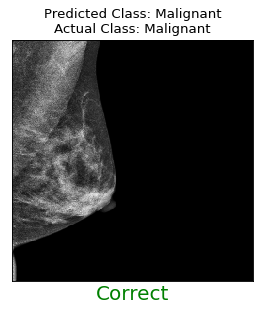

Truth: Malignant
Predict: Malignant


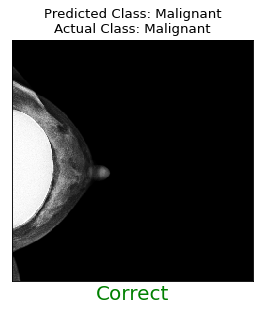

Truth: Malignant
Predict: Malignant


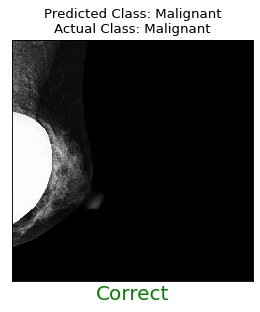

Truth: Malignant
Predict: Malignant


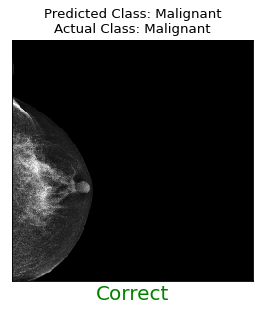

Truth: Malignant
Predict: Malignant


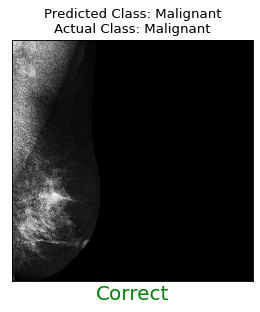

Truth: Malignant
Predict: Malignant


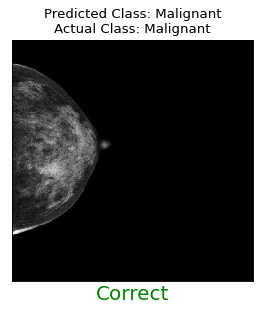

Truth: Malignant
Predict: Malignant


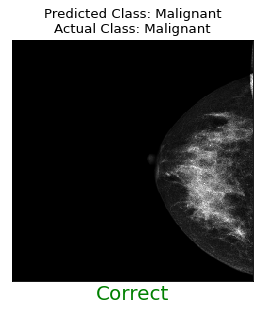

Truth: Malignant
Predict: Malignant


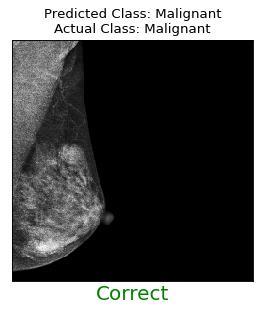

Truth: Malignant
Predict: Malignant


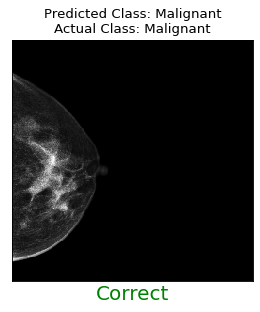

Truth: Malignant
Predict: Malignant


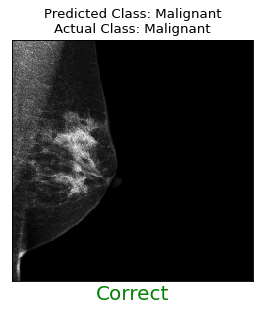

Truth: Malignant
Predict: Malignant


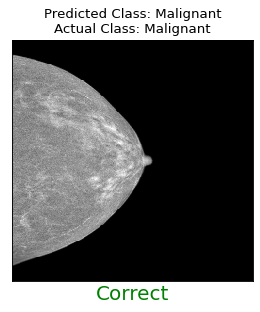

Truth: Malignant
Predict: Malignant


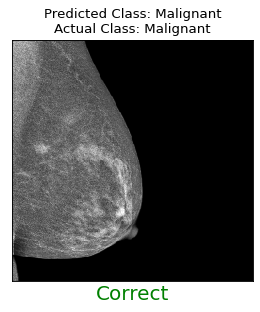

Truth: Malignant
Predict: Malignant


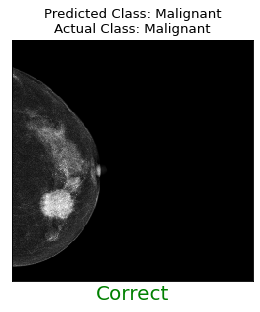

Truth: Malignant
Predict: Malignant


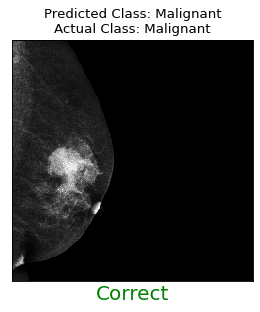

Truth: Malignant
Predict: Malignant


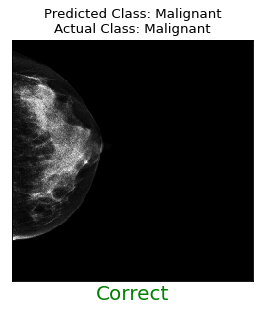

Truth: Malignant
Predict: Malignant


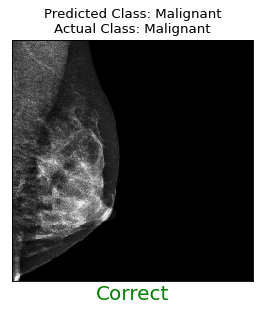

Truth: Malignant
Predict: Malignant


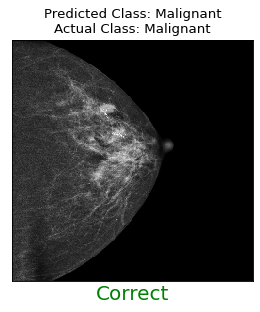

Truth: Malignant
Predict: Malignant


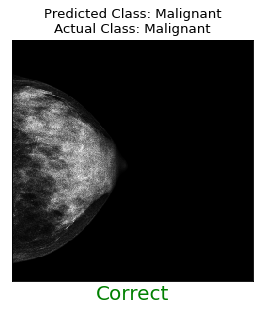

Truth: Malignant
Predict: Malignant


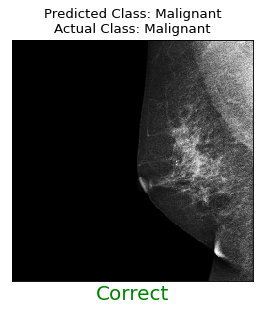

Truth: Malignant
Predict: Malignant


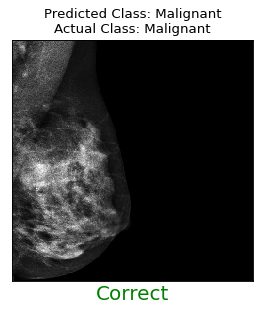

Truth: Malignant
Predict: Malignant


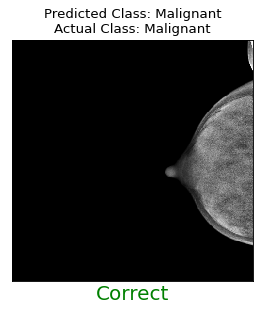

Truth: Malignant
Predict: Malignant


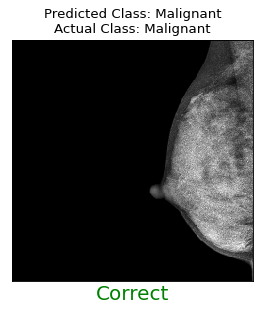

Truth: Malignant
Predict: Malignant


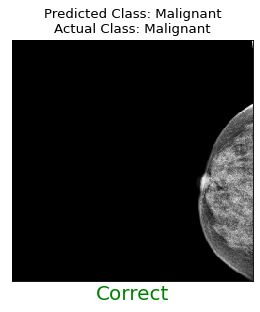

Truth: Malignant
Predict: Malignant


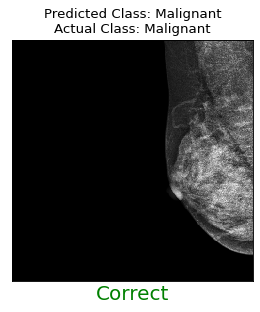

Truth: Malignant
Predict: Malignant


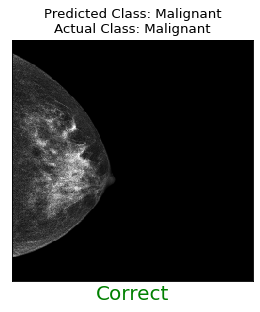

Truth: Malignant
Predict: Malignant


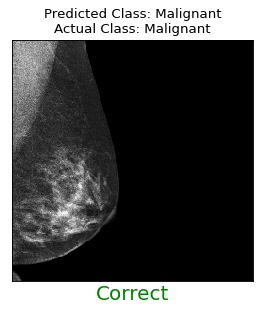

Truth: Malignant
Predict: Malignant


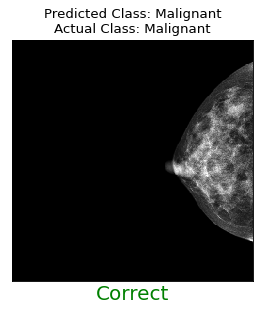

Truth: Malignant
Predict: Malignant


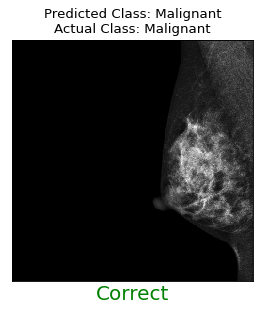

Truth: Malignant
Predict: Malignant


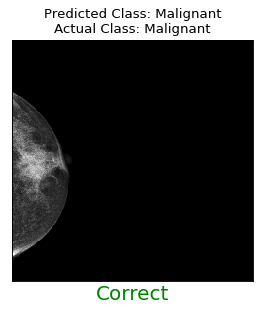

Truth: Malignant
Predict: Malignant


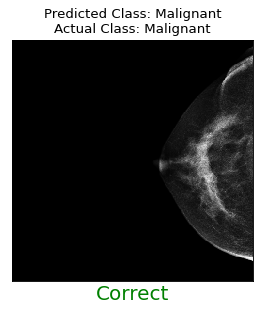

Truth: Malignant
Predict: Malignant


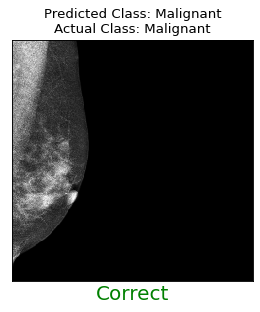

Truth: Malignant
Predict: Malignant


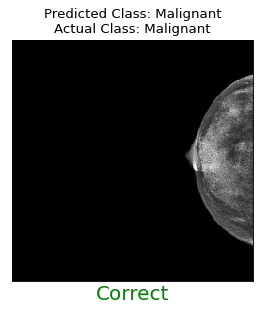

Truth: Malignant
Predict: Malignant


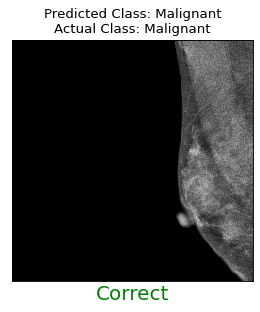

Truth: Malignant
Predict: Malignant


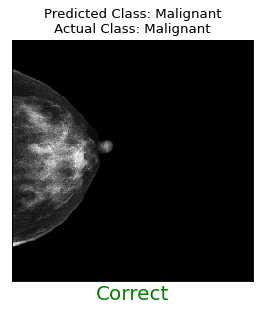

Truth: Malignant
Predict: Malignant


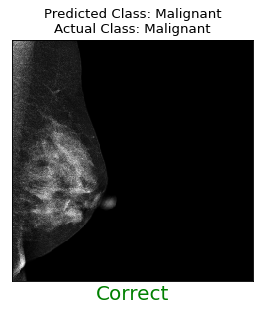

Truth: Malignant
Predict: Malignant


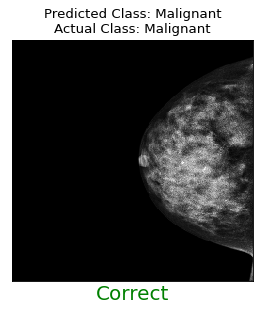

Truth: Malignant
Predict: Malignant


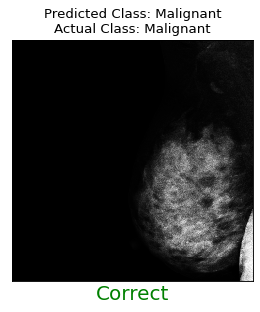

Truth: Malignant
Predict: Malignant


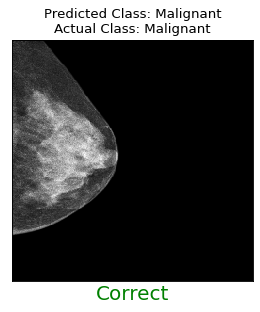

Truth: Malignant
Predict: Malignant


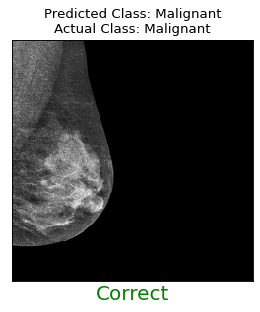

Truth: Malignant
Predict: Malignant


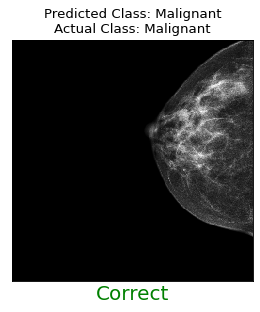

Truth: Malignant
Predict: Malignant


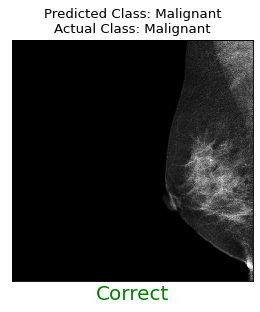

Truth: Malignant
Predict: Malignant


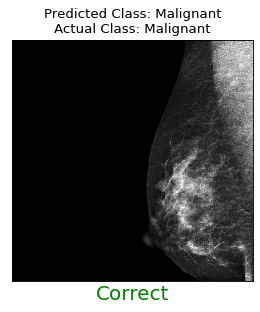

Truth: Malignant
Predict: Malignant


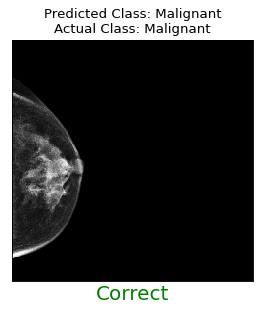

Truth: Malignant
Predict: Malignant


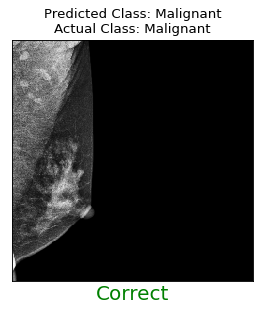

Truth: Malignant
Predict: Malignant


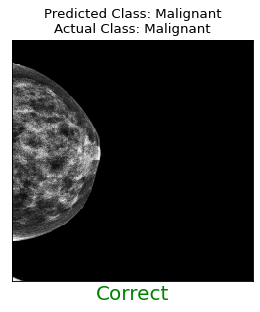

Truth: Malignant
Predict: Malignant


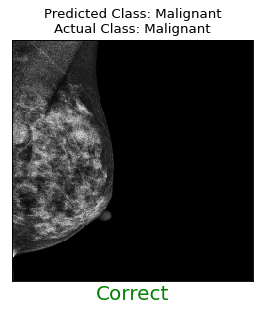

Truth: Malignant
Predict: Malignant


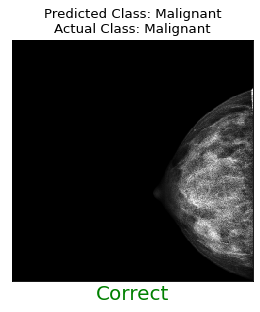

Truth: Malignant
Predict: Malignant


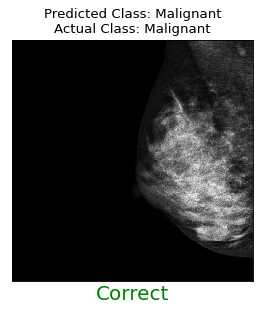

Truth: Malignant
Predict: Malignant


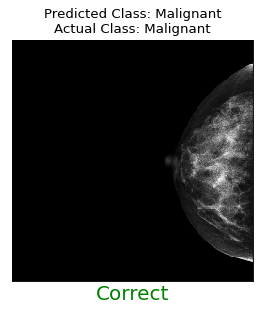

Truth: Malignant
Predict: Malignant


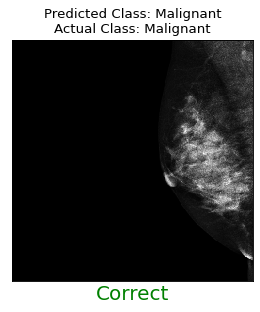

Truth: Malignant
Predict: Malignant


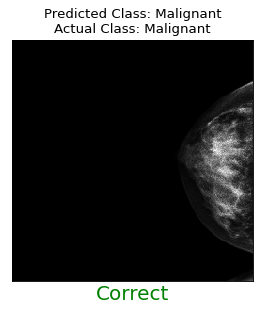

Truth: Malignant
Predict: Malignant


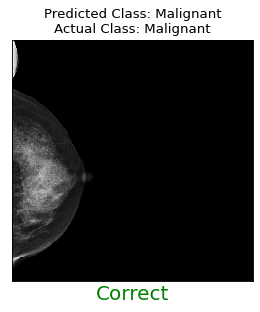

Truth: Malignant
Predict: Malignant


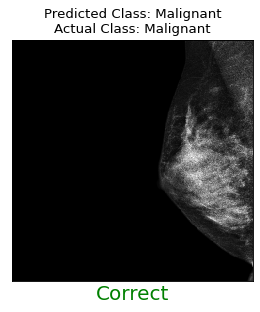

Truth: Malignant
Predict: Malignant


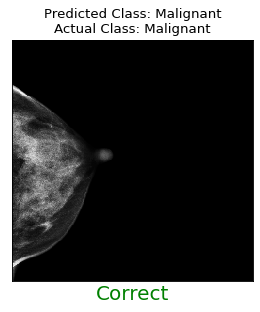

Truth: Malignant
Predict: Malignant


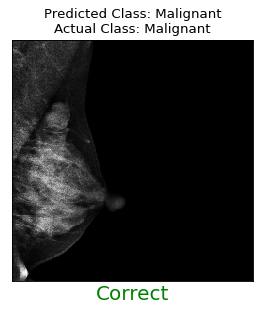

Truth: Malignant
Predict: Malignant


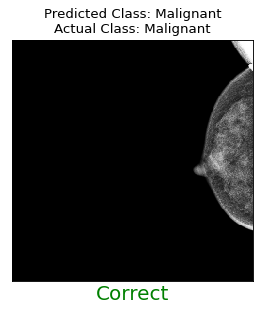

Truth: Malignant
Predict: Malignant


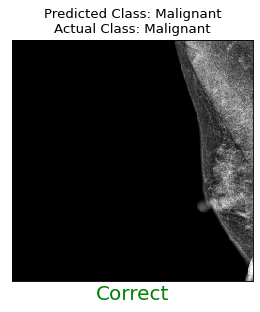

Truth: Malignant
Predict: Malignant


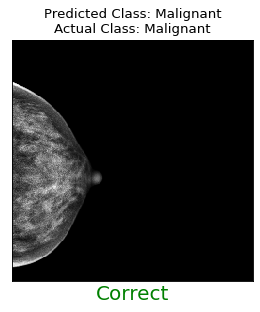

Truth: Malignant
Predict: Malignant


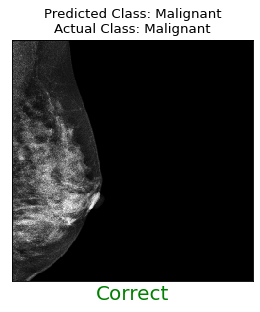

Truth: Malignant
Predict: Malignant


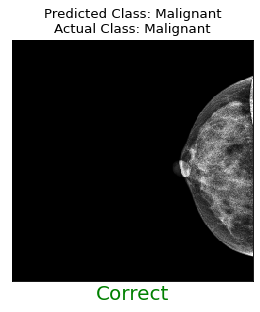

Truth: Malignant
Predict: Malignant


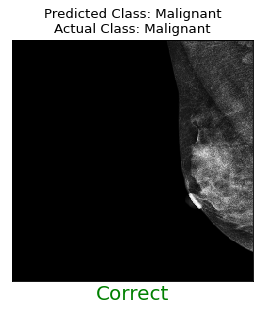

Truth: Malignant
Predict: Malignant


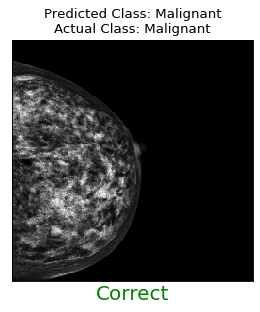

Truth: Malignant
Predict: Malignant


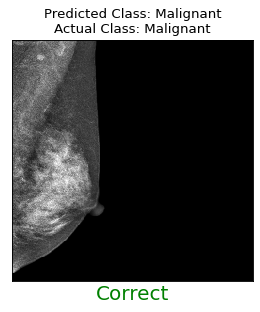

Truth: Malignant
Predict: Malignant


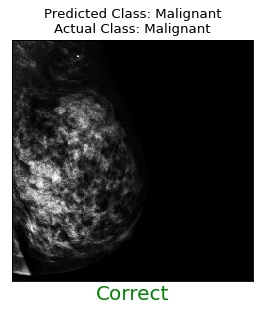

Truth: Malignant
Predict: Malignant


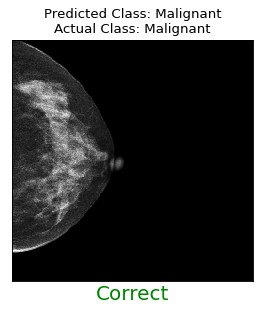

Truth: Malignant
Predict: Malignant


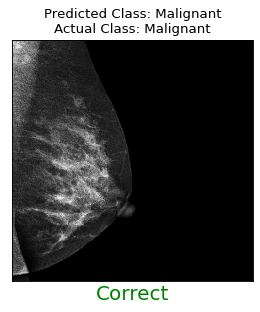

Truth: Malignant
Predict: Malignant


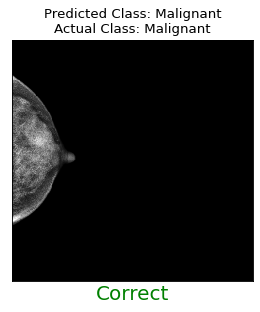

Truth: Malignant
Predict: Malignant


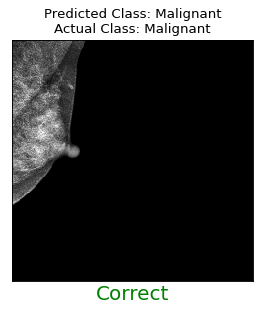

Truth: Malignant
Predict: Malignant


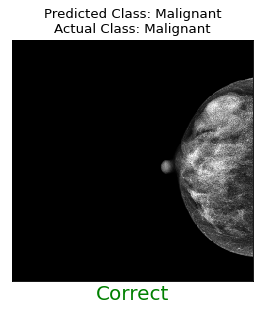

Truth: Malignant
Predict: Malignant


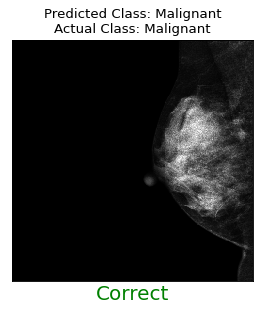

Truth: Malignant
Predict: Malignant


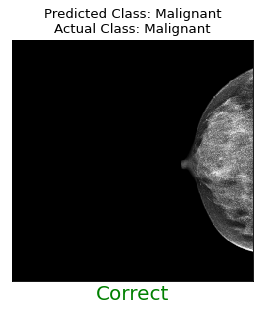

Truth: Malignant
Predict: Malignant


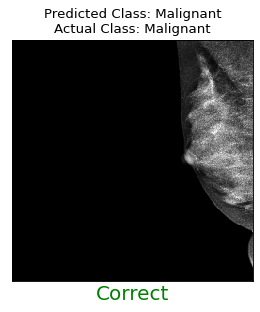

Truth: Malignant
Predict: Malignant


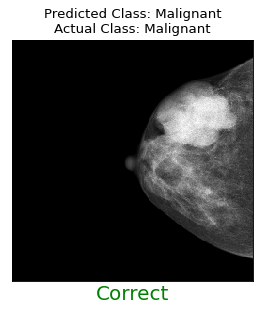

Truth: Malignant
Predict: Malignant


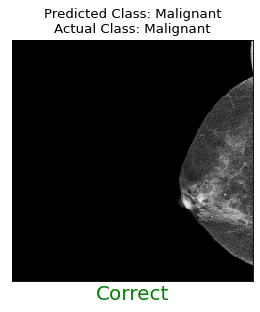

Truth: Malignant
Predict: Benign


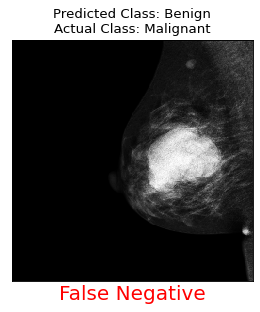

Truth: Malignant
Predict: Benign


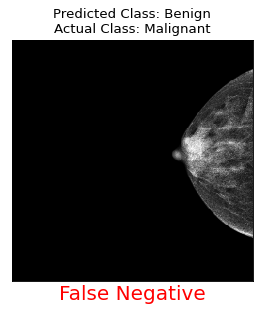

Truth: Malignant
Predict: Malignant


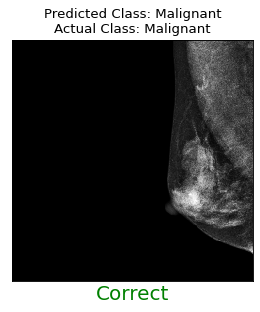

Truth: Malignant
Predict: Malignant


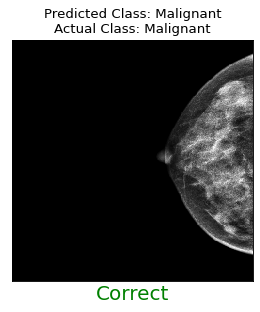

Truth: Malignant
Predict: Malignant


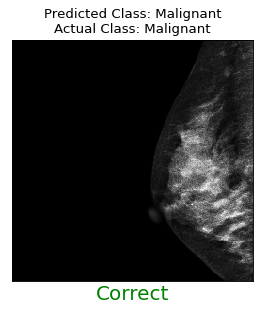

Truth: Malignant
Predict: Malignant


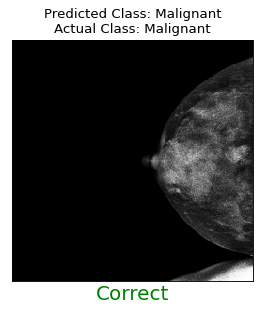

Truth: Malignant
Predict: Malignant


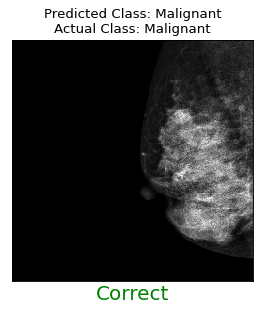

Truth: Malignant
Predict: Malignant


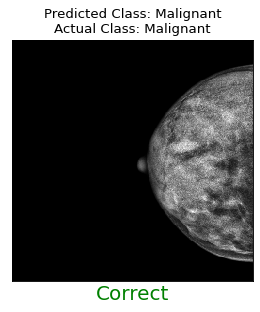

Truth: Malignant
Predict: Malignant


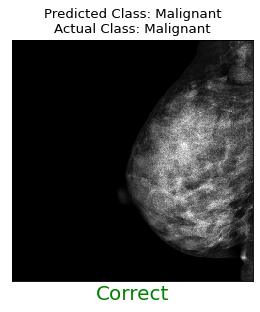

Truth: Malignant
Predict: Benign


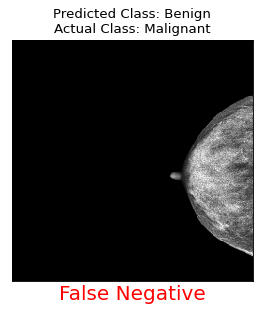

Truth: Malignant
Predict: Malignant


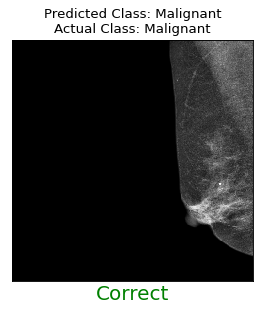

Truth: Malignant
Predict: Malignant


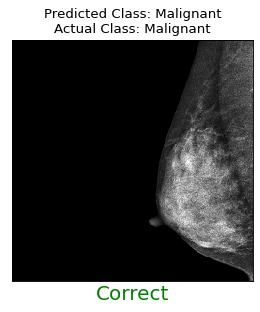

Truth: Malignant
Predict: Malignant


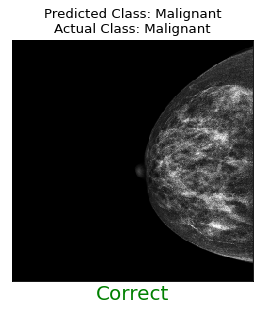

Truth: Malignant
Predict: Malignant


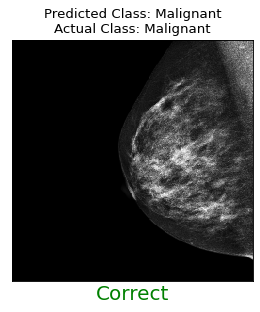

Truth: Malignant
Predict: Malignant


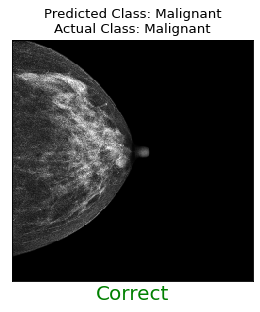

Truth: Malignant
Predict: Malignant


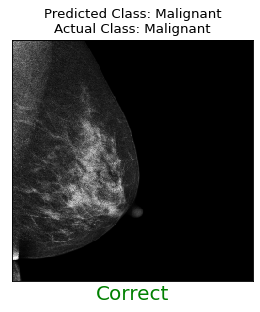

Truth: Malignant
Predict: Malignant


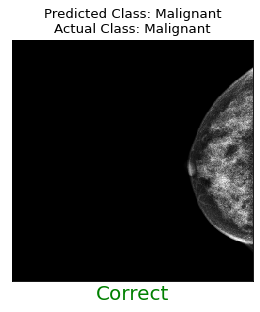

Truth: Malignant
Predict: Malignant


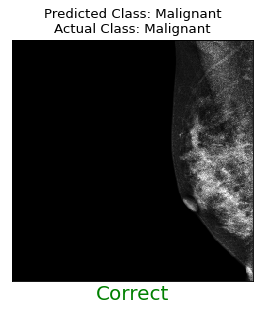

Truth: Malignant
Predict: Malignant


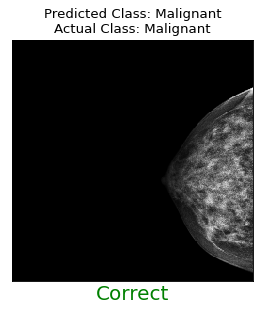

Truth: Malignant
Predict: Malignant


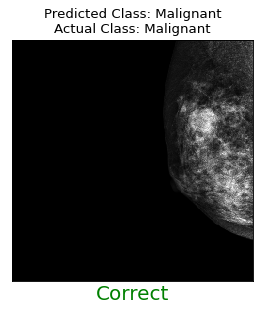

Truth: Malignant
Predict: Malignant


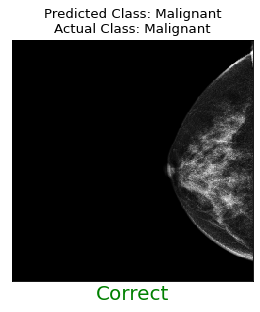

Truth: Malignant
Predict: Malignant


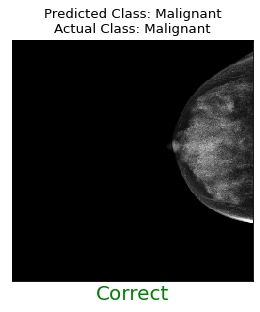

Truth: Malignant
Predict: Malignant


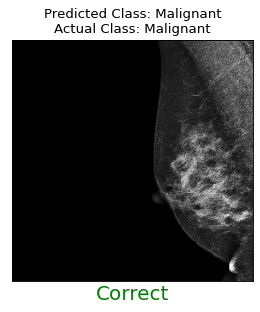

Truth: Malignant
Predict: Malignant


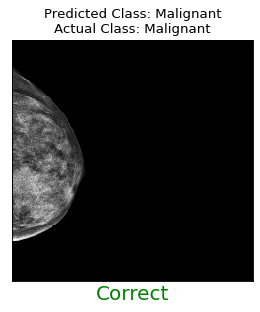

Truth: Malignant
Predict: Malignant


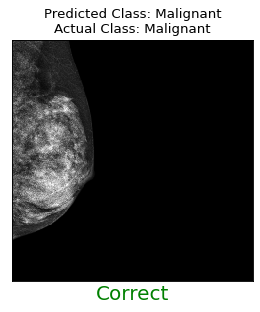

Truth: Malignant
Predict: Malignant


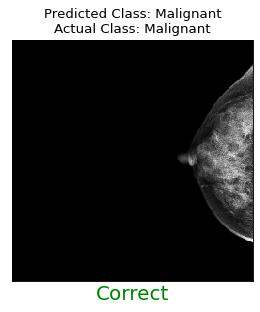

Truth: Malignant
Predict: Malignant


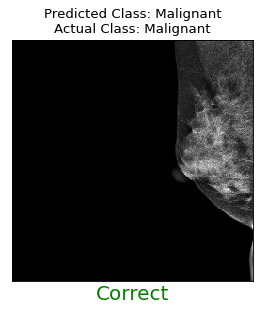

Truth: Malignant
Predict: Malignant


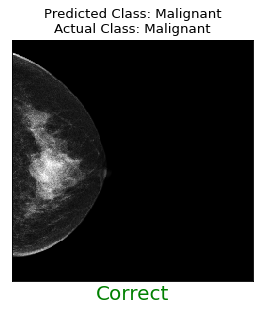

Truth: Malignant
Predict: Malignant


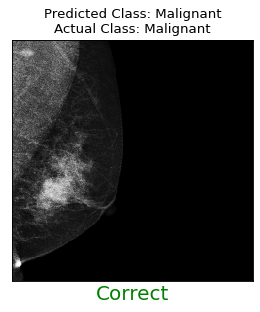

Truth: Malignant
Predict: Malignant


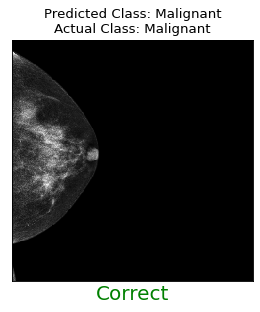

Truth: Malignant
Predict: Malignant


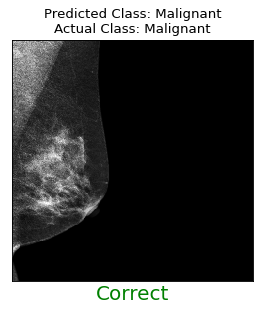

Truth: Malignant
Predict: Malignant


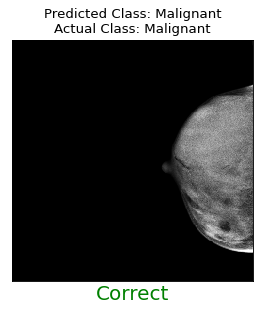

Truth: Malignant
Predict: Malignant


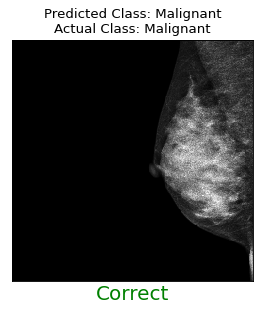

Truth: Malignant
Predict: Malignant


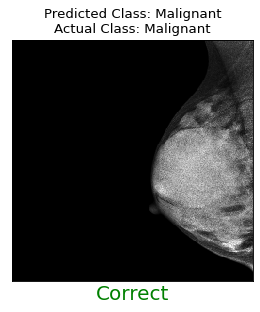

Truth: Malignant
Predict: Malignant


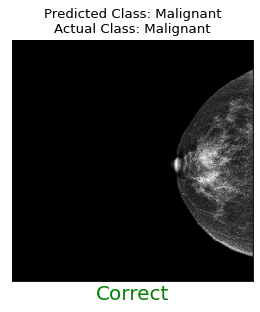

Truth: Malignant
Predict: Malignant


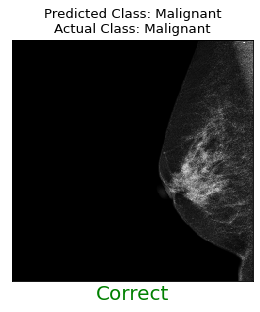

In [48]:
import matplotlib.pyplot as plt
#Loop for video for correct instances
i = 0
for c in range(752):
    x_test = test_generator.next()
    image = x_test[0][0]

    #Preduction label
    if predictions[c] == 0:
        guess = "Benign"
    if predictions[c] == 1:
        guess = "Malignant"
        
    if y_true[c] == 0:
        truth = "Benign"
    if y_true[c] == 1:
        truth = "Malignant"
        
    if y_true[c] == predictions[c]:
        print("Truth: "+truth)
        print("Predict: "+guess)
    #If match show incorrect at bottom
    if y_true[c] != predictions[c]:
        print("Truth: "+truth)
        print("Predict: "+guess)
    
    plt.figure(figsize=(4, 4), dpi=80)
    plt.xticks([])
    plt.yticks([])
    #If match show correct at bottom
    if y_true[c] == predictions[c]:
        plt.xlabel('Correct', color="green",fontsize=18)
    #If match show incorrect at bottom
    if y_true[c] != predictions[c]:
        if predictions[c] > y_true[c]:
            #plt.xlabel('Incorrect', color="red", fontsize=18)
            plt.xlabel('False Positive', color="red", fontsize=18)
        if predictions[c] < y_true[c]:
            #plt.xlabel('Incorrect', color="red", fontsize=18)
            plt.xlabel('False Negative', color="red", fontsize=18)
    plt.imshow(image, cmap="gray", interpolation='none')
    plt.title("Predicted Class: {}\nActual Class: {}".format(guess, truth))
    plt.tight_layout()
    plt.savefig('./output/predictions/'+str(i)+'.png',bbox_inches='tight')
    plt.show()
    i += 1

In [25]:
cm = confusion_matrix(y_true,predictions)
cm
cm = pd.DataFrame(cm , index = ['0','1'] , columns = ['0','1'])

array([[ 20, 204],
       [ 18, 510]])

<AxesSubplot:>

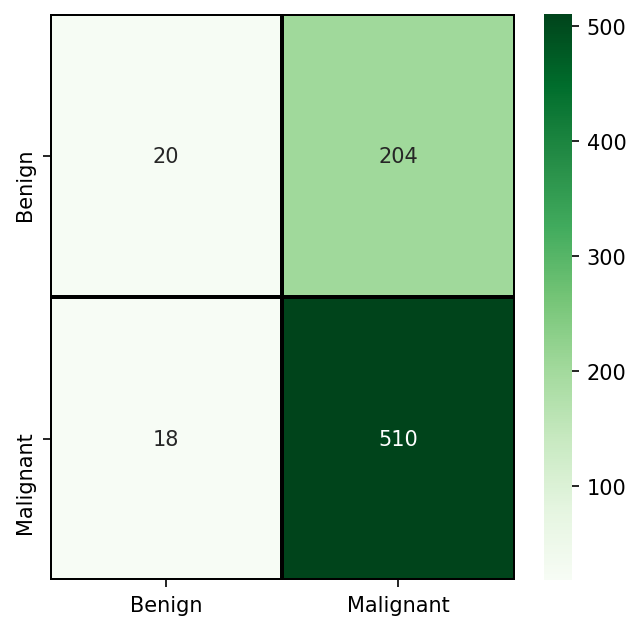

In [29]:
labels = ['Benign', 'Malignant']
plt.figure(figsize = (5,5), dpi=150)
sns.heatmap(cm,cmap= "Greens", linecolor = 'black' , linewidth = 1 , annot = True, fmt='',xticklabels = labels,yticklabels = labels)

In [4]:
test_datagen = ImageDataGenerator(
#         rescale=1./255,
        preprocessing_function=tf.keras.applications.xception.preprocess_input
)

test_generator = test_datagen.flow_from_directory(
        cmmd_dir+"subset_two/PNG/TEST/",
        target_size=(299, 299),
        color_mode="rgb",
        batch_size=1,
        shuffle=False,
        class_mode='binary',
        seed=14)

Found 752 images belonging to 2 classes.


In [73]:
model = keras.models.load_model("/media/craig/Henry/ML_models/xception_aug/save_at_9.h5")
# model=keras.models.load_model("/media/craig/Henry/ML_models/xception_ft_1/save_at_46.h5")
# model=keras.models.load_model("/media/craig/Henry/ML_models/alexnet/save_at_47.h5")

In [74]:
filenames = test_generator.filenames
nb_samples = len(filenames)

# predict = model.predict(test_generator,steps = nb_samples)

In [75]:
predictions = (model.predict(test_generator) > 0.5).astype("int32")

In [76]:
predictions = predictions.reshape(1,-1)[0]

In [77]:
y_true = test_generator.classes

In [78]:
correct = np.nonzero(predictions == y_true)[0]
incorrect = np.nonzero(predictions != y_true)[0]

In [79]:
cm = confusion_matrix(y_true,predictions)
cm
cm = pd.DataFrame(cm , index = ['0','1'] , columns = ['0','1'])

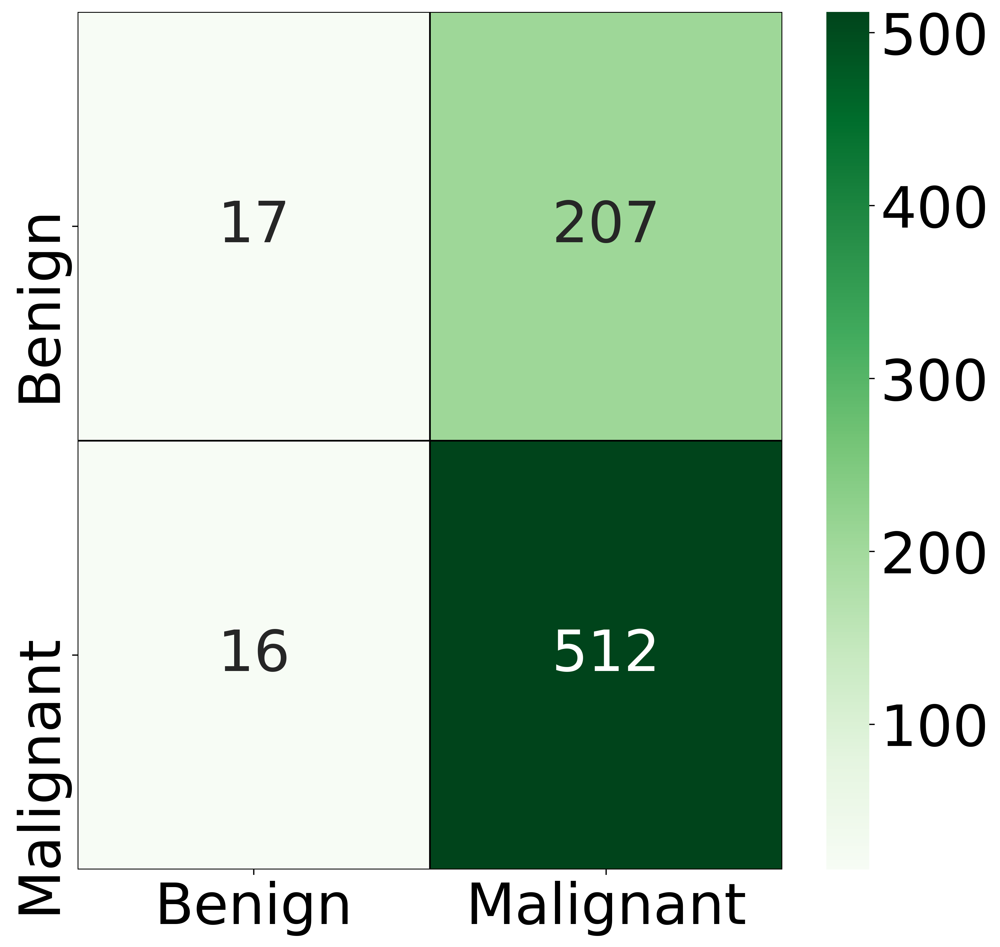

In [93]:
labels = ['Benign', 'Malignant']
plt.figure(figsize = (10,10), dpi=400)
plt.rcParams.update({'font.size': 36})
sns.heatmap(cm,cmap= "Greens", linecolor = 'black' , linewidth = 1 , annot = True, fmt='',xticklabels = labels,yticklabels = labels)
plt.savefig("./output/xception_confusion_matrix.png", dpi=100, bbox_inches="tight")

In [22]:
print(classification_report(y_true, predictions, target_names = ['Malignant (Class 0)','Benign (Class 1)']))

                     precision    recall  f1-score   support

Malignant (Class 0)       0.52      0.08      0.13       224
   Benign (Class 1)       0.71      0.97      0.82       528

           accuracy                           0.70       752
          macro avg       0.61      0.52      0.48       752
       weighted avg       0.65      0.70      0.62       752



In [24]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_true, predictions)

0.5227949134199135

In [33]:
FP = cm.sum(axis=0) - np.diag(cm)  
FN = cm.sum(axis=1) - np.diag(cm)
TP = np.diag(cm)
TN = cm.values.sum() - (FP + FN + TP)

# Sensitivity, hit rate, recall, or true positive rate
TPR = TP/(TP+FN)
# Specificity or true negative rate
TNR = TN/(TN+FP) 
# Precision or positive predictive value
PPV = TP/(TP+FP)
# Negative predictive value
NPV = TN/(TN+FN)
# Fall out or false positive rate
FPR = FP/(FP+TN)
# False negative rate
FNR = FN/(TP+FN)
# False discovery rate
FDR = FP/(TP+FP)

# Overall accuracy
ACC = (TP+TN)/(TP+FP+FN+TN)

In [36]:
TPR

0    0.075893
1    0.969697
dtype: float64

In [ ]:
# probabilities = model.predict_generator(generator, 2000)

In [ ]:
# model.evaluate(test_generator)

In [ ]:
# y_pred_bool = np.argmax(predict, axis=1)
# y_pred_bool

In [ ]:
# predict
# y_true = test_generator.classes
# y_pred = np.argmax(predict, axis=1)
# print('Confusion Matrix')
# print(confusion_matrix(y_true, y_pred))

# print('Confusion Matrix')
# print(confusion_matrix(y_pred, y_true))

In [ ]:
# from sklearn.metrics import plot_confusion_matrix
# import matplotlib.pyplot as plt

# mat = confusion_matrix(y_true, y_pred)
# plot_confusion_matrix(mat)

In [ ]:
# # from sklearn.metrics import confusion_matrix
# cm=confusion_matrix(y_pred,y_true)
# print(cm)

In [ ]:
# predict

In [ ]:
# predictions = predict.reshape(1,-1)[0]
# predictions[:15]


In [ ]:
# y_true

In [ ]:

# print(classification_report(y_true, predictions, target_names = ['Benign (Class 0)','Malignant (Class 1)']))

In [ ]:
# from sklearn.metrics import classification_report

# y_pred = model.predict(x_test, batch_size=64, verbose=1)
# y_pred_bool = np.argmax(y_pred, axis=1)

# print(classification_report(y_test, y_pred_bool))